In [1]:
import anndata as ad
import scanpy as sc
import gc
import sys
import cellanova as cnova
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sea
import os

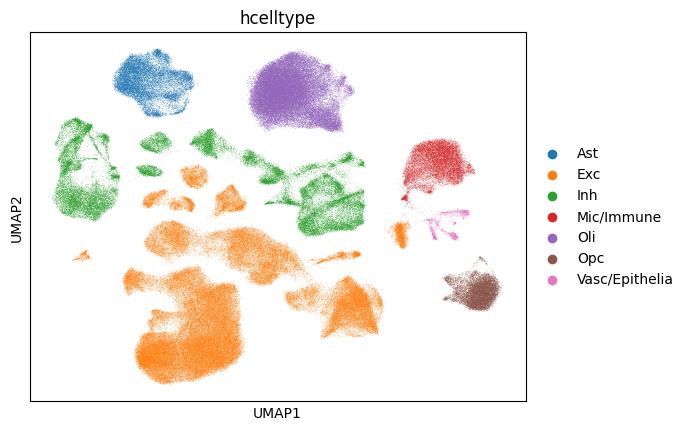

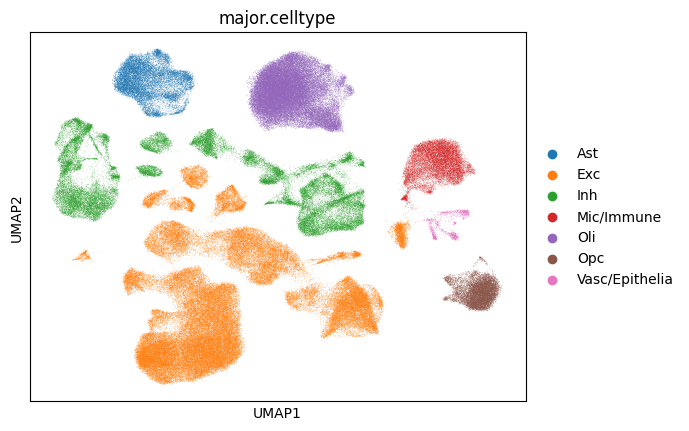

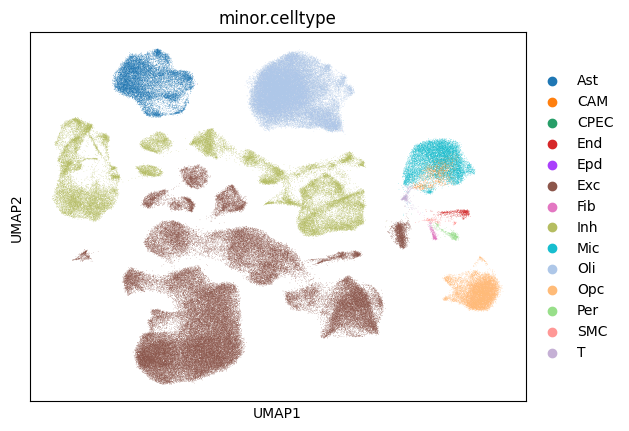

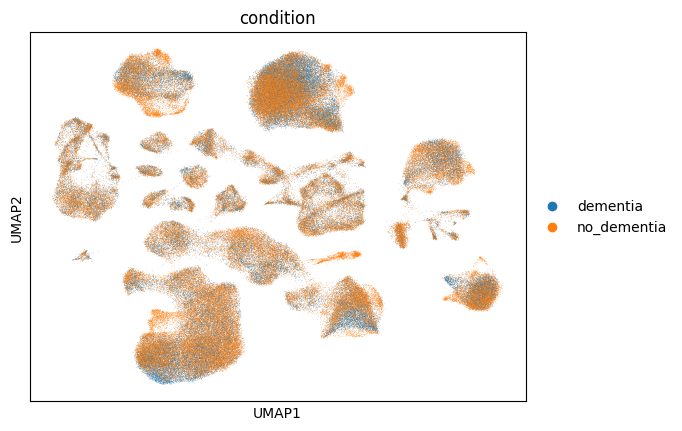

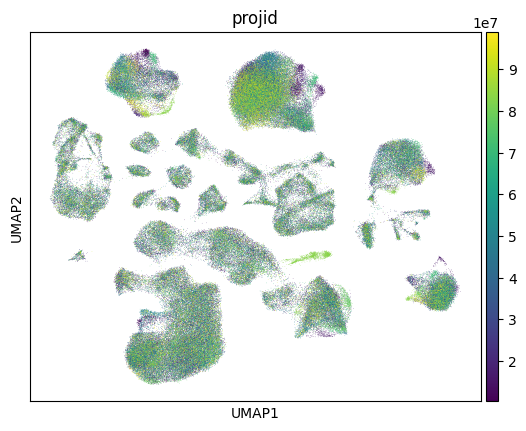

In [2]:
adata_raw=sc.read_h5ad("./data/ROSMAP.h5ad")
adata_raw.raw = None
for colori in ["hcelltype","major.celltype","minor.celltype","condition","projid"]:
    sc.pl.umap(adata_raw,color=colori)

In [47]:
print(adata_raw.shape)

(227412, 2314)


In [48]:
import pandas as pd
df = pd.DataFrame(adata_raw.obs[["condition",'projid']].copy())

# Remove duplicated rows
unique_df = df.drop_duplicates()

# Construct a dictionary mapping the first column to the second column
mapping_dict = dict(zip(unique_df['projid'], unique_df["condition"]))

print("Unique DataFrame:")
print(unique_df)
print("\nMapping Dictionary:")
print(mapping_dict)

Unique DataFrame:
          condition    projid
0          dementia  20151388
5603    no_dementia  50301125
12121   no_dementia  11259716
19258   no_dementia  62404688
26201   no_dementia  10383017
32067      dementia  66754397
37816   no_dementia  15483818
41558      dementia  20906079
45699      dementia  50410319
50484   no_dementia  15413198
54526   no_dementia  70625336
57495   no_dementia  77891596
64143   no_dementia  20584923
70766   no_dementia  20399274
75245      dementia  21171080
79338   no_dementia  68539908
83610   no_dementia  65652206
90775      dementia  12365619
94950   no_dementia  21272396
98862   no_dementia  70816595
102238     dementia  11619606
110498  no_dementia  61827429
116285  no_dementia  11632851
120308     dementia  20780035
123820  no_dementia  31509843
127584     dementia  82317494
131858  no_dementia  50109639
134942     dementia  90780976
138235  no_dementia  37030589
141884  no_dementia  86934089
145447  no_dementia  11681508
150471     dementia  5

In [50]:
print(unique_df.shape)
print(np.sum(unique_df.loc[:,"condition"]=="dementia"))

(48, 2)
16


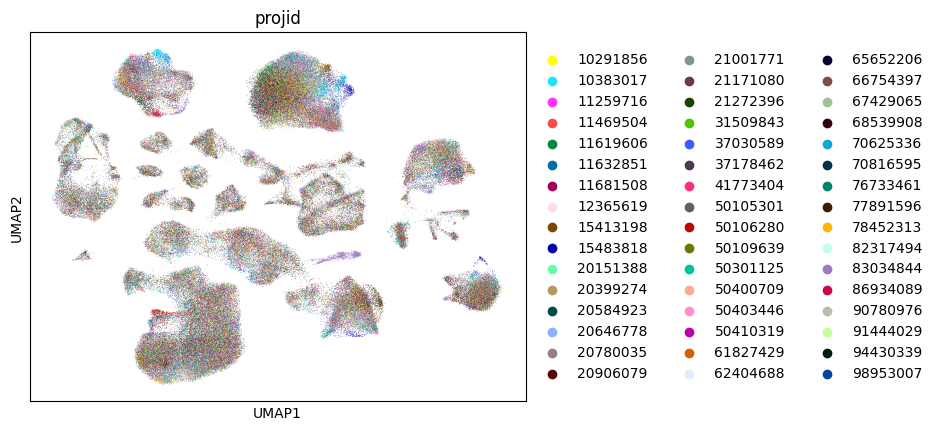

In [36]:
adata_raw.obs["projid"]=[str(i) for i in adata_raw.obs["projid"]]
sc.pl.umap(adata_raw,color="projid")

In [23]:
print("ATP6" in adata_raw.var_names)
print("CYTB" in adata_raw.var_names)

False
False


In [3]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import norm

def plot_distribution_with_binary_zscore(vector, gene_name):
    """
    Plots the distribution of the values in the vector, calculates the z-score
    based on the proportion of values > 0 using CLT, and uses the gene name and z-score
    as the title of the plot.

    Args:
    - vector (numpy.ndarray or list): The input vector of values.
    - gene_name (str): The gene name to include in the title.

    Returns:
    - None: Displays the plot.
    """
    # Convert to numpy array if not already
    vector = np.array(vector)

    # Binary transformation: count the number of values > 0
    count_positive = np.sum(vector > 0)+0.5*np.sum(vector==0)
    n = len(vector)
    proportion_positive = count_positive / n  # Proportion of values > 0

    # Calculate z-score using the CLT
    p_null = 0.5  # Null hypothesis: Proportion of values > 0 is 0.5
    std_error = np.sqrt(p_null * (1 - p_null) / n)
    z_score = (proportion_positive - p_null) / std_error

    # Plot the distribution of the vector
    plt.figure(figsize=(8, 6))
    plt.hist(vector, bins=30, alpha=0.7, edgecolor='k', color='blue')
    plt.axvline(0, color='red', linestyle='--', label='Reference: 0')
    plt.title(f"{gene_name} | Z-score: {z_score:.2f} (Proportion > 0: {proportion_positive:.2f})", fontsize=14)
    plt.xlabel('Values')
    plt.ylabel('Frequency')
    plt.legend()
    plt.tight_layout()

    # Show the plot
    plt.show()

def plot_distribution(vector, bins=30, kde=True, title="Distribution Plot"):
    """
    Plots the distribution of a vector using a histogram and optionally overlays a KDE fitted line.

    Parameters:
    - vector (array-like): The input data vector.
    - bins (int): Number of bins for the histogram. Default is 30.
    - kde (bool): Whether to add a KDE fitted line. Default is True.
    - title (str): Title for the plot. Default is "Distribution Plot".
    """
    plt.figure(figsize=(8, 6))

    # Plot histogram and optionally the KDE
    sns.histplot(vector, bins=bins, kde=kde, color='blue', stat='density', edgecolor='black')

    # Add titles and labels
    plt.title(title, fontsize=14)
    plt.xlabel("Value", fontsize=12)
    plt.ylabel("Density", fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.7)

    # Show the plot
    plt.tight_layout()
    plt.show()

def plot_distribution1(vector, bins=30, kde=True, title="Distribution Plot"):
    """
    Plots the distribution of a vector using a histogram and optionally overlays a KDE fitted line and a normal distribution.

    Parameters:
    - vector (array-like): The input data vector.
    - bins (int): Number of bins for the histogram. Default is 30.
    - kde (bool): Whether to add a KDE fitted line. Default is True.
    - title (str): Title for the plot. Default is "Distribution Plot".
    """
    plt.figure(figsize=(8, 6))

    # Plot histogram and optionally the KDE
    sns.histplot(vector, bins=bins, kde=kde, color='blue', stat='density', edgecolor='black')

    # Overlay the normal distribution curve
    mean, std = np.mean(vector), np.std(vector)
    x = np.linspace(min(vector), max(vector), 1000)
    plt.plot(x, norm.pdf(x, mean, std), color='red', label=f'Normal Dist. (μ={mean:.2f}, σ={std:.2f})')

    # Add titles, labels, and legend
    plt.title(title, fontsize=14)
    plt.xlabel("Value", fontsize=12)
    plt.ylabel("Density", fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.legend(fontsize=12)

    # Show the plot
    plt.tight_layout()
    plt.show()

from scipy.stats import norm
from statsmodels.stats.multitest import multipletests

def zscores_to_adjusted_pvalues(z_scores, adjustment_method='fdr_bh'):
    """
    Convert z-scores to two-sided p-values and adjust them for multiple comparisons.

    Parameters:
        z_scores (array-like): Vector of z-scores.
        adjustment_method (str): Method for p-value adjustment. 
                                 Options include 'bonferroni', 'fdr_bh', etc.
                                 (default is 'fdr_bh').

    Returns:
        dict: A dictionary containing:
              - 'z_scores': The original z-scores.
              - 'p_values': The two-sided p-values.
              - 'adjusted_p_values': The adjusted p-values.
    """
    # Convert z-scores to two-sided p-values
    p_values = 2*(1 - norm.cdf(np.abs(z_scores)))
    p_values = np.nan_to_num(p_values, nan=0)
    # Adjust p-values for multiple comparisons
    adjusted_p_values = multipletests(p_values, method=adjustment_method)[1]
    
    return adjusted_p_values

import pandas as pd
def Plot_and_Estimate_CATE_adata(
    adata,
    indices,
    up_regulate=True,
    genes=None,
    topk=5,
    plot=True,
    parametric=False
):
    # Subset the ITE matrix using the selected indices
    ITE_subset = adata.X[indices, :]

    # Initialize z-scores for genes
    z_scores = []

    # Calculate z-scores for each gene (column in the ITE matrix)
    for gene_idx in range(ITE_subset.shape[1]):
        gene_ite = ITE_subset[:, gene_idx]
        # Test if ITE > 0 using non-parametric test (binomial distribution assumption)
        n = len(gene_ite)
        successes = np.sum(gene_ite > 0) + 0.5*np.sum(gene_ite==0)
        # z-score for binomial test
        z_score = (successes - n * 0.5) / np.sqrt(n * 0.25)
        z_scores.append(z_score)
    
    if parametric:
        z_scores = []
        for gene_idx in range(ITE_subset.shape[1]):
            gene_ite = ITE_subset[:, gene_idx]
            # Test if ITE > 0 using non-parametric test (binomial distribution assumption)
            n = len(gene_ite)
            # z-score for binomial test
            z_score = np.mean(gene_ite)/np.std(gene_ite, ddof=1)*np.sqrt(n)
            z_scores.append(z_score)
    
    # Select top-k significant genes if `genes` is not provided
    z_scores = np.array(z_scores)
    #print(np.max(z_scores))
    #plot_distribution(z_scores)
    p_adjs=zscores_to_adjusted_pvalues(z_scores)

    if genes is not None:
        print(z_scores[adata.var_names.tolist().index(genes)])
        gene_idx = np.where(adata.var_names == genes)[0][0]
        ite_values = ITE_subset[:, gene_idx]
        plot_distribution_with_binary_zscore(vector=-ite_values, gene_name=genes)
        return
            
    #plot_distribution(2 * (1 - norm.cdf(np.abs(z_scores))))
    if up_regulate:
        print("Calculating up-regulation")
        z_scores=-z_scores
    # Get indices of top-k absolute z-scores
    topk_indices = np.argsort(z_scores)[:topk]
    genes = adata.var_names[topk_indices]
    #print(z_scores[topk_indices])

    print(adata.var_names[np.argsort(z_scores)[:200]].tolist())
    
    #print("Number of genes with ITE adjusted p-values less than 0.01",np.sum(p_adjs<0.01))
    
    # Print the selected most significant genes
    print("Selected most significant genes:")
    genes=genes.tolist()

    df=pd.DataFrame({"Gene":genes, "Z score":np.array([z_scores[adata.var_names.tolist().index(gene)] for gene in genes]),
                    "Adjusted_p":np.array([p_adjs[adata.var_names.tolist().index(gene)] for gene in genes])})
    print(df)

    if plot:
        # Plot the distribution of ITE values for the selected genes
        plt.figure(figsize=(10, 6))
        for gene in genes:
            if gene is None:
                continue
            print("Plotting:", gene)
            print("adjusted p-value:",p_adjs[adata.var_names.tolist().index(gene)])
            gene_idx = np.where(adata.var_names == gene)[0][0]
            ite_values = ITE_subset[:, gene_idx]

            plot_distribution_with_binary_zscore(vector=-ite_values, gene_name=gene)
            sc.pl.umap(adata_raw, color=gene,ncols=1)

    top1000=adata.var_names[np.argsort(z_scores)[:1000]].tolist()
    return [x for x in top1000 if x is not None][:300]

In [4]:
def read_ITE():
    print("adata preprocessing...")

    import warnings
    warnings.filterwarnings("ignore")
    warnings.filterwarnings("ignore", category=FutureWarning)

    ITE = []
    for filei in os.listdir("./ROSMAP"):
        if filei.find("ITE.h5ad") > 0:
            ITE.append(sc.read_h5ad("./ROSMAP/" + filei))
    ITE = ad.concat(ITE, merge="same", uns_merge="same")
    print("Finish")
    return ITE

In [5]:
ITE=read_ITE()

adata preprocessing...
Finish


In [6]:
for i in adata_raw.obs.columns:
    tmp=adata_raw.obs[i].values.tolist()
    try:
        unique=np.unique(tmp)
        if len(unique)<100:
            print(i, len(unique), unique)
    except:
        print(i,"no",len(unique))
        continue

rind 48 ['MT.1' 'MT.10' 'MT.11' 'MT.12' 'MT.13' 'MT.14' 'MT.15' 'MT.16' 'MT.17'
 'MT.18' 'MT.19' 'MT.2' 'MT.20' 'MT.21' 'MT.22' 'MT.23' 'MT.24' 'MT.25'
 'MT.26' 'MT.27' 'MT.28' 'MT.29' 'MT.3' 'MT.30' 'MT.31' 'MT.32' 'MT.33'
 'MT.34' 'MT.35' 'MT.36' 'MT.37' 'MT.38' 'MT.39' 'MT.4' 'MT.40' 'MT.41'
 'MT.42' 'MT.43' 'MT.44' 'MT.45' 'MT.46' 'MT.47' 'MT.48' 'MT.5' 'MT.6'
 'MT.7' 'MT.8' 'MT.9']
region 1 ['MT']
projid 48 [10291856 10383017 11259716 11469504 11619606 11632851 11681508 12365619
 15413198 15483818 20151388 20399274 20584923 20646778 20780035 20906079
 21001771 21171080 21272396 31509843 37030589 37178462 41773404 50105301
 50106280 50109639 50301125 50400709 50403446 50410319 61827429 62404688
 65652206 66754397 67429065 68539908 70625336 70816595 76733461 77891596
 78452313 82317494 83034844 86934089 90780976 91444029 94430339 98953007]
is.doublet 1 ['False']
col 7 ['#33A02C' '#B15928' '#B2DF8A' '#CAB2D6' '#E31A1C' '#FED9A6' '#ffa340']
tspcol 10 ['#1F78B480' '#33A02C80' '#B159288

# Astrocyte

['SLC39A11', 'RANBP3L', 'HIF3A', 'NWD1', 'MRAS', 'ATP1A2', 'SASH1', 'PSD2', 'SLC25A18', 'KCNJ10', 'CSRP1', 'PARD3', 'EGFR', 'MT-ND1', 'ZBTB20', 'MT-ND3', 'FKBP5', 'CTNNA2', 'PDGFRB', 'TPD52L1', 'MT-CO2', 'GJA1', 'ITPKB', 'ARHGEF4', 'CDH23', 'KCNN3', 'MT-CO3', 'COL21A1', 'GSN', 'FAM107A', 'PLCG2', 'ADAM33', 'CAPN2', 'CHST11', 'GPRC5B', 'DDIT4', 'SLC7A2', 'COL27A1', 'PHYHD1', 'MT1F', 'SLC39A12', 'RFTN2', 'AHNAK', 'COL5A3', 'MT1E', 'KCNE4', 'GPR37L1', 'RFX2', 'PDE3B', 'VCAN', 'ACACB', 'GRAMD1C', 'GLUL', 'NDRG2', 'ZNRF3', 'RASSF8', 'CLU', 'MT1G', 'RGCC', 'CPE', 'MTUS1', 'MAML2', 'EGLN3', 'ADCY8', 'BSG', 'LGR6', 'NOTCH2', 'GADD45G', 'MT2A', 'FSTL5', 'LRRC1', 'SLC2A1', 'CDH20', 'ITM2C', 'VEGFA', 'ATP1B2', 'PLIN5', 'TSC22D4', 'NFKBIA', 'HPSE2', 'PI16', 'PON2', 'TXNL4B', 'EEF2K', 'MEGF10', 'LRP4', 'HILPDA', 'PRELP', 'FOXO1', 'ID4', 'HSPA2', 'AQP4', 'CDC42EP4', 'TFCP2L1', 'SOX5', 'ZFP36L1', 'PDE3A', 'ADCY2', 'TGFB2', 'SLC24A4', 'HGF', 'ATP13A4', 'RIN2', 'EYA2', 'BCAN', 'EZR', 'TMPRSS5', 'PDK4',

<Figure size 1000x600 with 0 Axes>

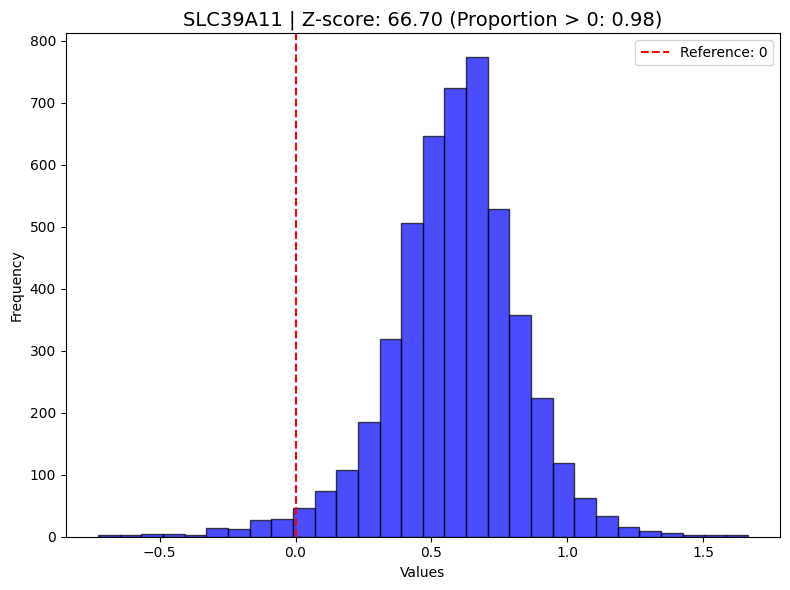

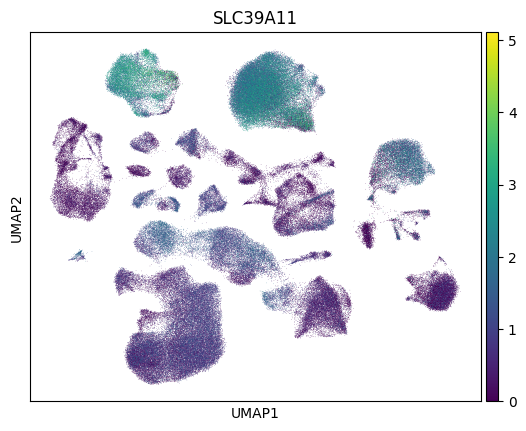

Plotting: RANBP3L
adjusted p-value: 0.0


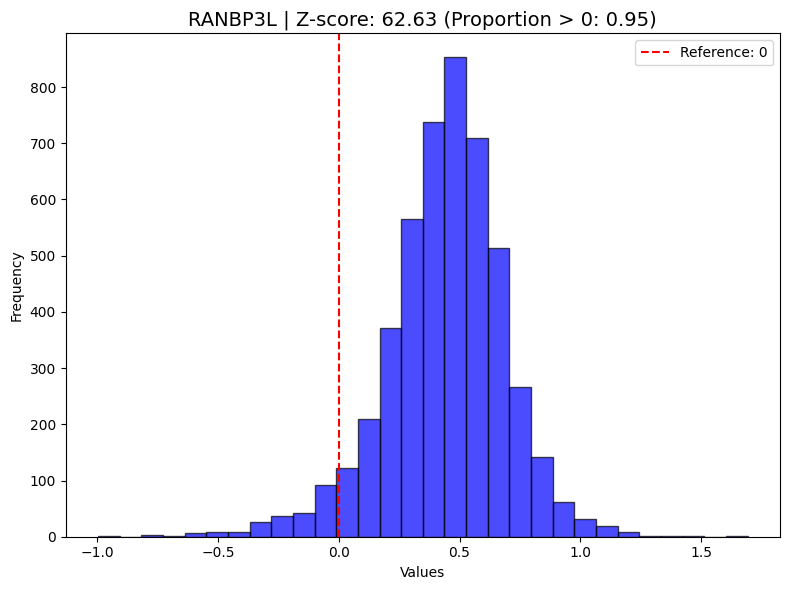

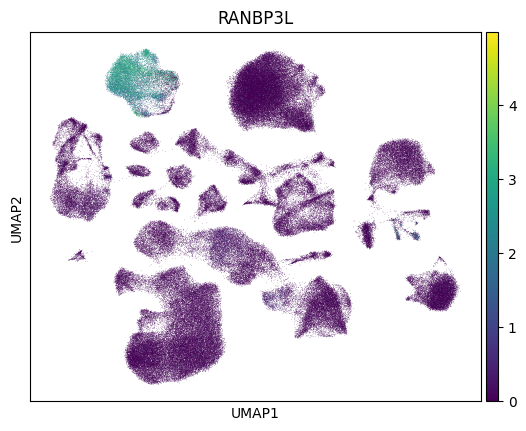

Plotting: HIF3A
adjusted p-value: 0.0


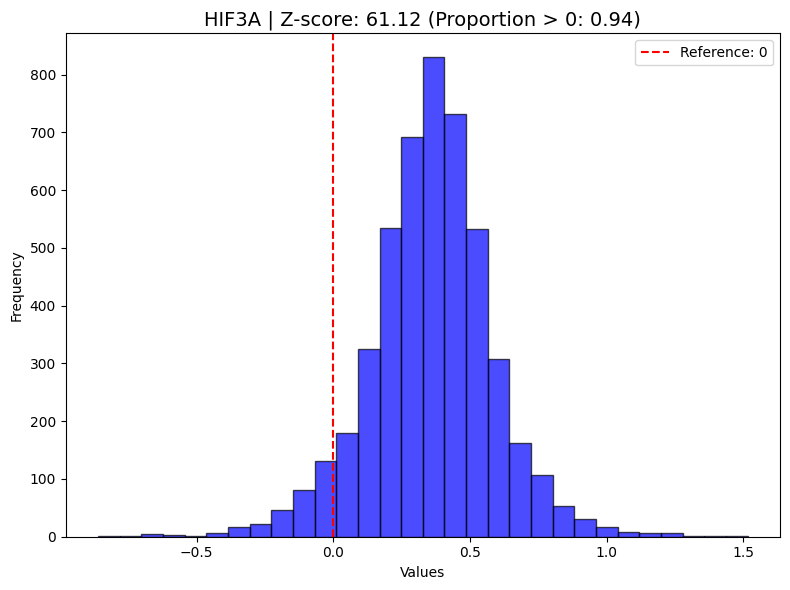

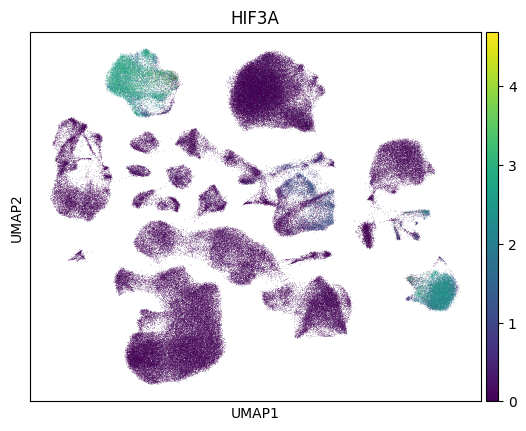

Plotting: NWD1
adjusted p-value: 0.0


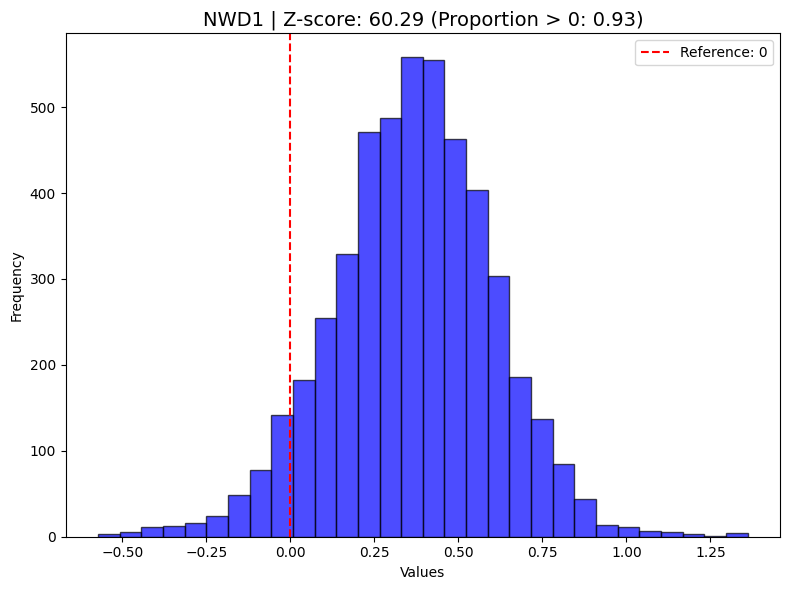

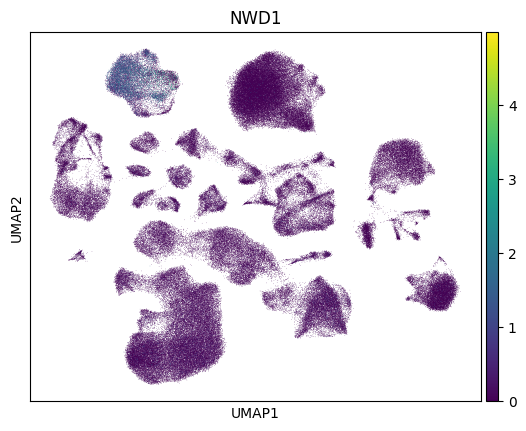

Plotting: MRAS
adjusted p-value: 0.0


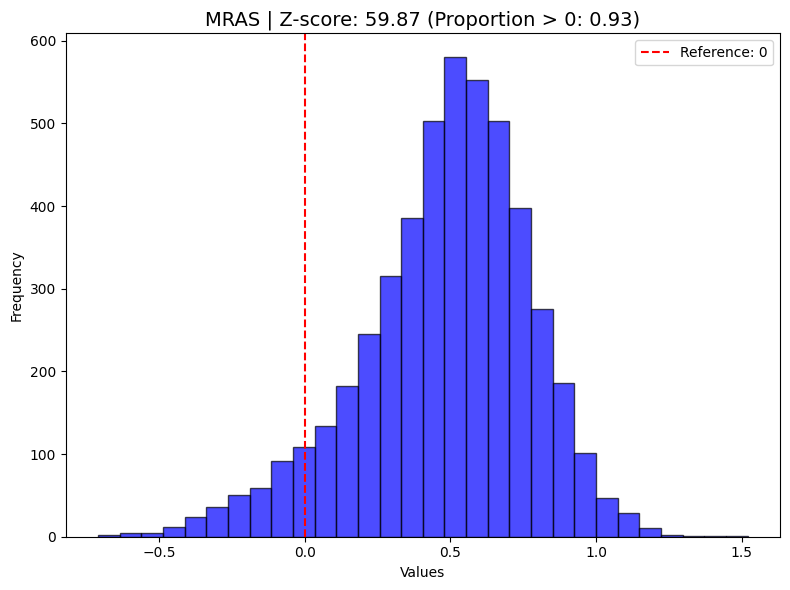

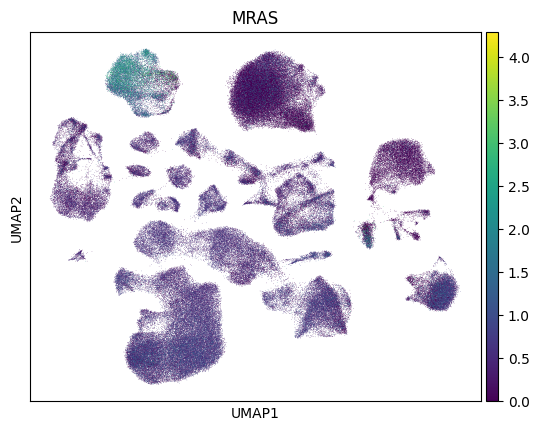

['SLC39A11', 'RANBP3L', 'MRAS', 'HIF3A', 'NWD1', 'ATP1A2', 'KCNJ10', 'PSD2', 'CSRP1', 'EGFR', 'SLC25A18', 'SASH1', 'PDGFRB', 'MT-ND1', 'FKBP5', 'MT-ND3', 'MT-CO2', 'GJA1', 'PARD3', 'ITPKB', 'COL21A1', 'CDH23', 'ADAM33', 'TPD52L1', 'GSN', 'ARHGEF4', 'KCNN3', 'PLCG2', 'FAM107A', 'MT-CO3', 'MT1F', 'DDIT4', 'CTNNA2', 'SLC7A2', 'COL27A1', 'CAPN2', 'CHST11', 'GPRC5B', 'PHYHD1', 'KCNE4', 'RFTN2', 'ZBTB20', 'MT1E', 'AHNAK', 'SLC39A12', 'GPR37L1', 'LGR6', 'VCAN', 'ACACB', 'PDE3B', 'RFX2', 'RASSF8', 'MT1G', 'NDRG2', 'GRAMD1C', 'RGCC', 'GADD45G', 'SLC2A1', 'COL5A3', 'GLUL', 'PI16', 'MTUS1', 'FSTL5', 'HSPA2', 'ADCY8', 'PRELP', 'ZNRF3', 'PLIN5', 'VEGFA', 'BSG', 'LRRC1', 'TFCP2L1', 'NFKBIA', 'MT2A', 'HPSE2', 'EGLN3', 'ITM2C', 'TSC22D4', 'TXNL4B', 'EEF2K', 'ATP1B2', 'NOTCH2', 'HILPDA', 'ID4', 'HGF', 'TMPRSS5', 'LRP4', 'PON2', 'PDK4', 'SLC24A4', 'ZFP36L1', 'PDE3A', 'MAML2', 'TGFB2', 'FOXO1', 'CDC42EP4', 'VSIR', 'CDH20', 'EYA2', 'EFHD1', 'SIPA1', 'RGMA', 'FMNL3', 'BCAN', 'ABCC4', 'MEGF10', 'DUSP1', 'VI

<Figure size 1000x600 with 0 Axes>

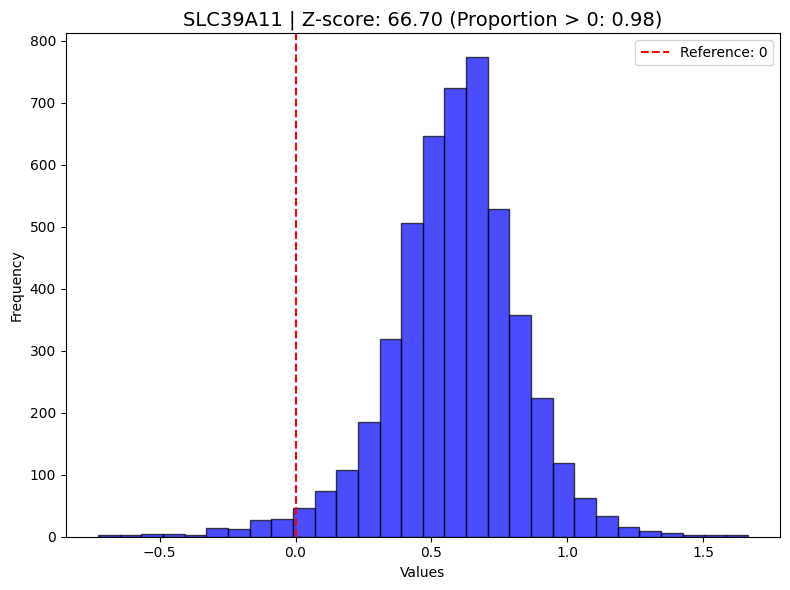

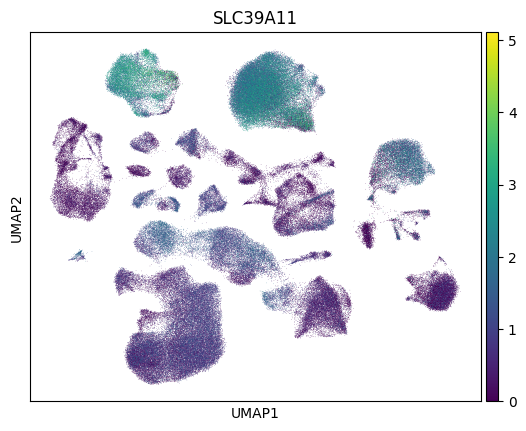

Plotting: RANBP3L
adjusted p-value: 0.0


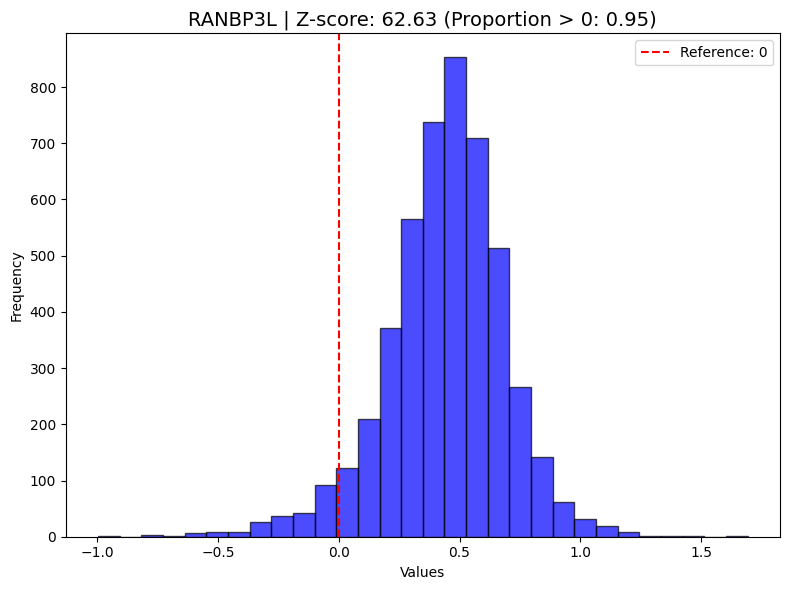

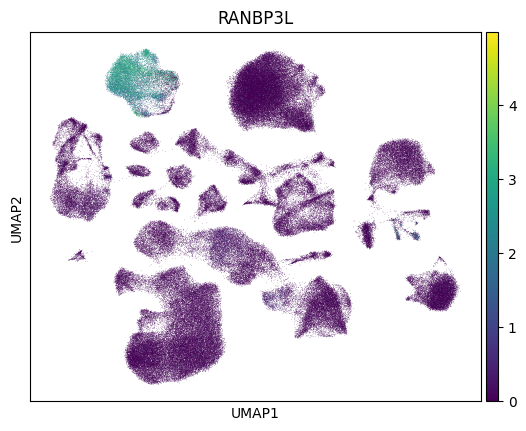

Plotting: MRAS
adjusted p-value: 0.0


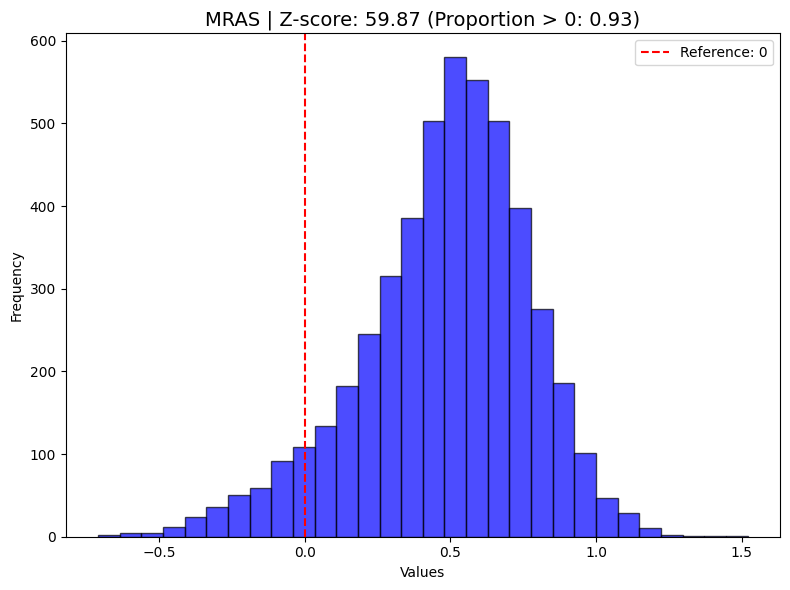

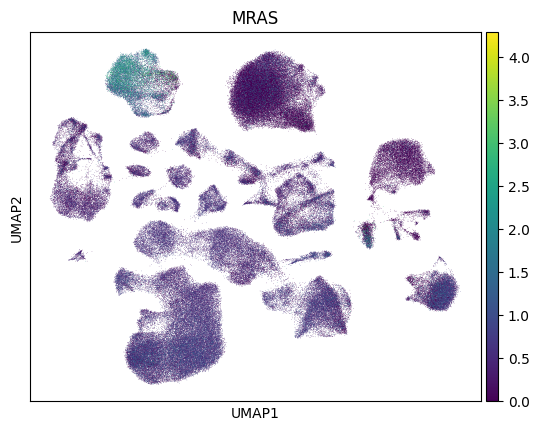

Plotting: HIF3A
adjusted p-value: 0.0


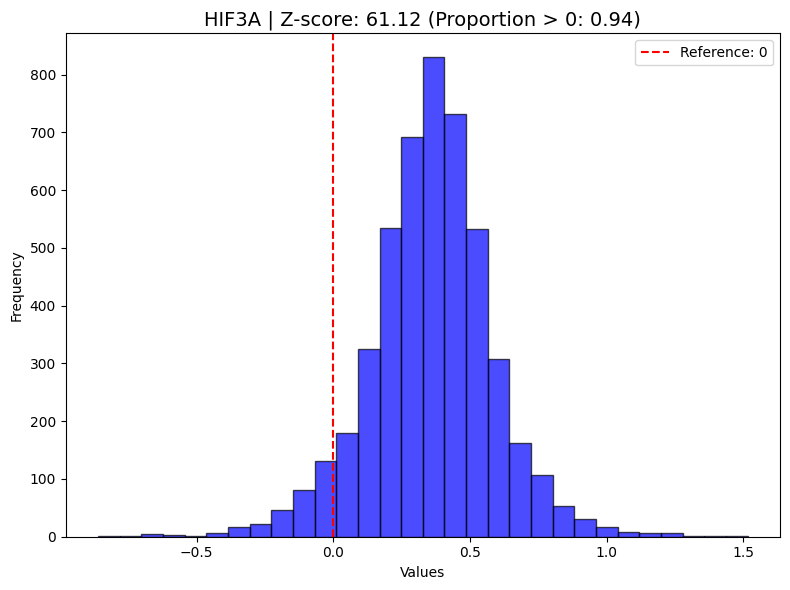

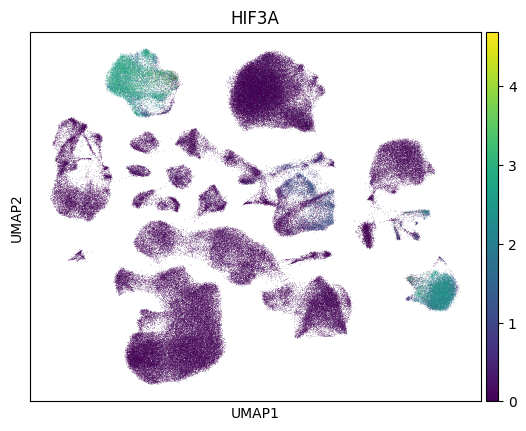

Plotting: NWD1
adjusted p-value: 0.0


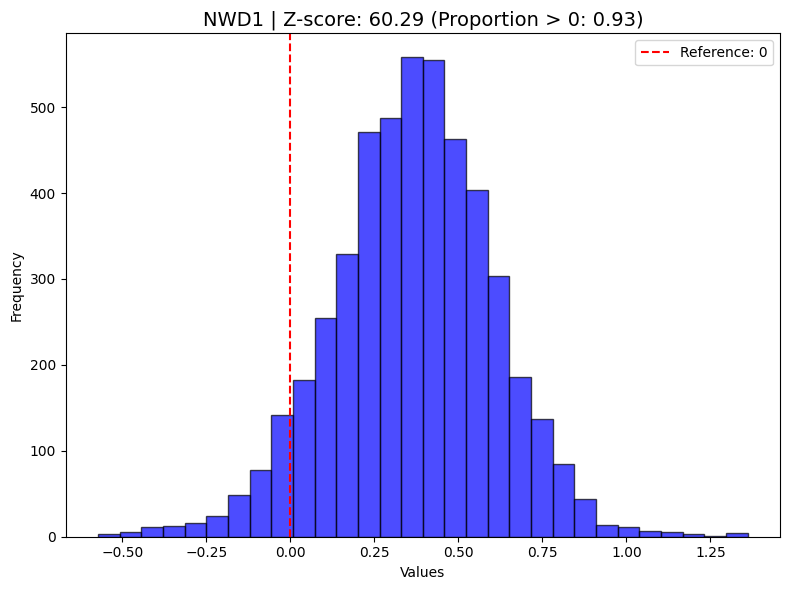

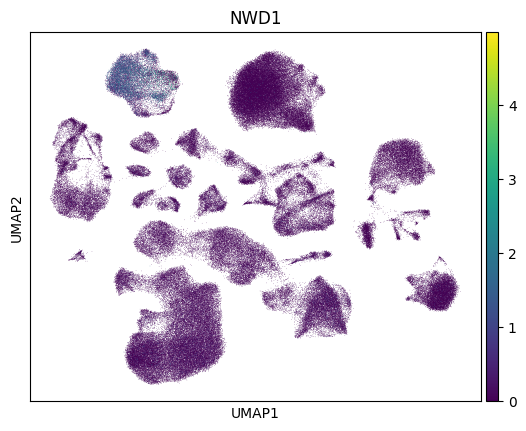

['SLC39A11',
 'RANBP3L',
 'MRAS',
 'HIF3A',
 'NWD1',
 'ATP1A2',
 'KCNJ10',
 'PSD2',
 'CSRP1',
 'EGFR',
 'SLC25A18',
 'SASH1',
 'PDGFRB',
 'MT-ND1',
 'FKBP5',
 'MT-ND3',
 'MT-CO2',
 'GJA1',
 'PARD3',
 'ITPKB',
 'COL21A1',
 'CDH23',
 'ADAM33',
 'TPD52L1',
 'GSN',
 'ARHGEF4',
 'KCNN3',
 'PLCG2',
 'FAM107A',
 'MT-CO3',
 'MT1F',
 'DDIT4',
 'CTNNA2',
 'SLC7A2',
 'COL27A1',
 'CAPN2',
 'CHST11',
 'GPRC5B',
 'PHYHD1',
 'KCNE4',
 'RFTN2',
 'ZBTB20',
 'MT1E',
 'AHNAK',
 'SLC39A12',
 'GPR37L1',
 'LGR6',
 'VCAN',
 'ACACB',
 'PDE3B',
 'RFX2',
 'RASSF8',
 'MT1G',
 'NDRG2',
 'GRAMD1C',
 'RGCC',
 'GADD45G',
 'SLC2A1',
 'COL5A3',
 'GLUL',
 'PI16',
 'MTUS1',
 'FSTL5',
 'HSPA2',
 'ADCY8',
 'PRELP',
 'ZNRF3',
 'PLIN5',
 'VEGFA',
 'BSG',
 'LRRC1',
 'TFCP2L1',
 'NFKBIA',
 'MT2A',
 'HPSE2',
 'EGLN3',
 'ITM2C',
 'TSC22D4',
 'TXNL4B',
 'EEF2K',
 'ATP1B2',
 'NOTCH2',
 'HILPDA',
 'ID4',
 'HGF',
 'TMPRSS5',
 'LRP4',
 'PON2',
 'PDK4',
 'SLC24A4',
 'ZFP36L1',
 'PDE3A',
 'MAML2',
 'TGFB2',
 'FOXO1',
 'CDC42EP4',
 'VS

In [7]:
indices=ITE.obs["minor.celltype"]=='Ast'
Plot_and_Estimate_CATE_adata(ITE,indices,up_regulate=False)
print("="*20)
Plot_and_Estimate_CATE_adata(ITE,indices,parametric=True,up_regulate=False)

Calculating up-regulation
['SLC1A3', 'LDLR', 'CNTNAP3B', 'ALDH1A1', 'GBP2', 'SAT1', 'GPCPD1', 'F3', 'FTH1', 'NAMPT', 'GNA14', 'CHI3L1', 'ITPR2', 'FGF1', 'NRP2', 'PLSCR1', 'MSI2', 'MGST1', 'SORBS1', 'CD44', 'LMOD1', 'ZFP36', 'SULF1', 'AKAP13', 'NRP1', 'SDS', 'CDKN1A', 'EMP1', 'HSPH1', 'SUSD6', 'TUBB2B', 'FBXL7', 'SOCS3', 'NPAS3', 'PDZD2', 'SLC44A3', 'ENTPD1', 'YBX3', 'DTNA', 'CRIM1', 'OPHN1', 'CLIC4', 'NDRG1', 'FAM189A2', 'CEMIP', 'PREX2', 'GADD45B', 'SERPINH1', 'GPC5', 'DNAJA4', 'PROS1', 'LIMS1', 'C11orf96', 'GBP1', 'MARCH3', 'IFI44L', 'FGFR2', 'RGS20', 'PTN', 'HSPD1', 'CD38', 'SLC25A37', 'DCLK2', 'PMP2', 'THSD4', 'LMO2', 'MAP3K14', 'ETV6', 'EPAS1', 'LRRC3B', 'BMPR1B', 'CACHD1', 'WARS', 'IL6R', 'IGFN1', 'DNAJB1', 'H3F3B', 'FOS', 'HSPA1B', 'SPOCD1', 'PRELID2', 'COL5A2', 'ANXA8', 'PRUNE2', 'STON2', 'OSMR', 'FN1', 'RGS16', 'S100B', 'IFI44', 'LIMK2', 'HES4', 'BAG3', 'PODXL', 'COL4A1', 'LRIG1', 'CYR61', 'ANXA2', 'EPB41L4A', 'CNN3', 'BMX', 'C4orf19', 'BAALC', 'DHCR24', 'PARP14', 'ABCC9', 'KC

<Figure size 1000x600 with 0 Axes>

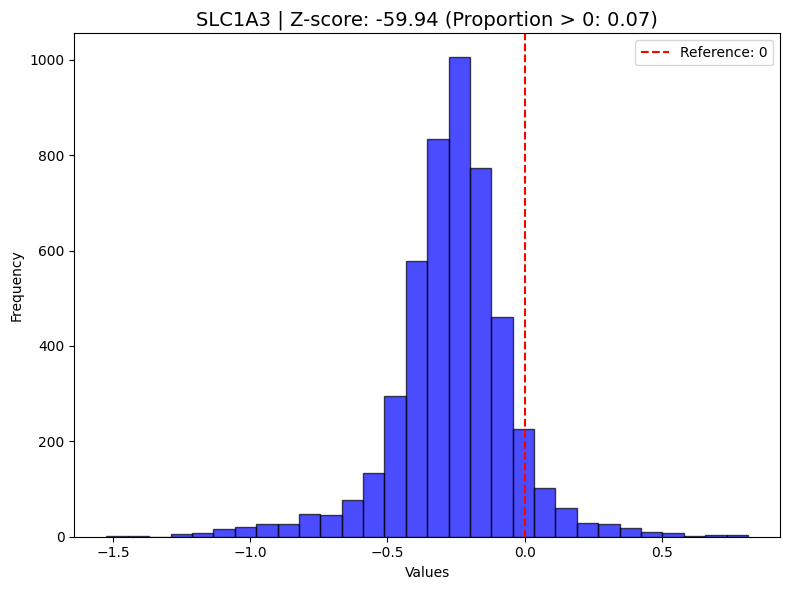

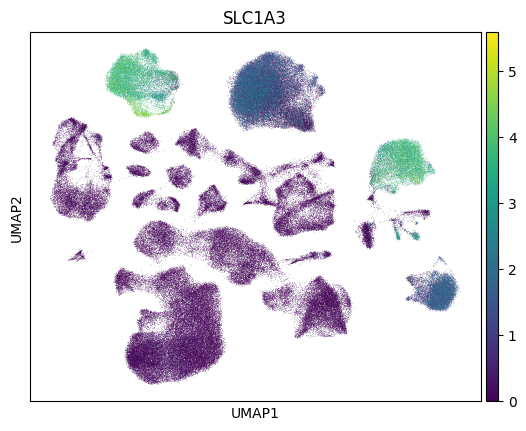

Plotting: LDLR
adjusted p-value: 0.0


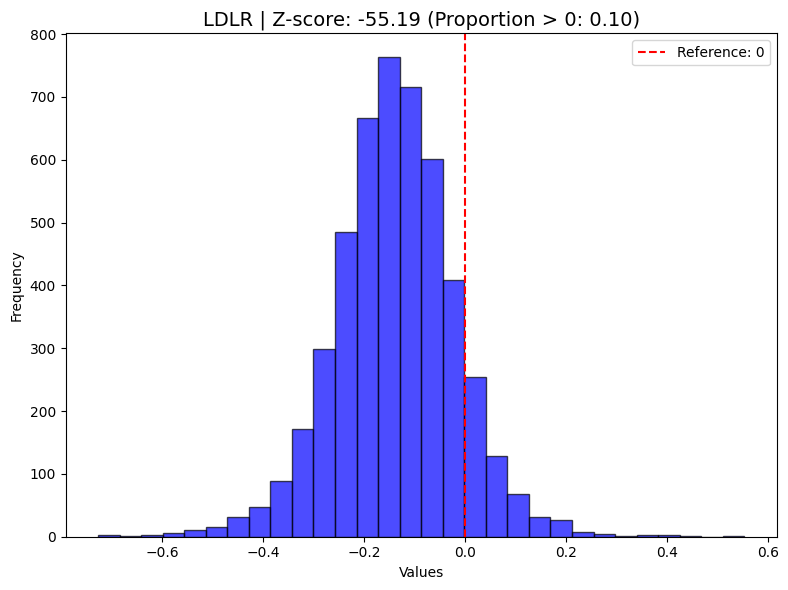

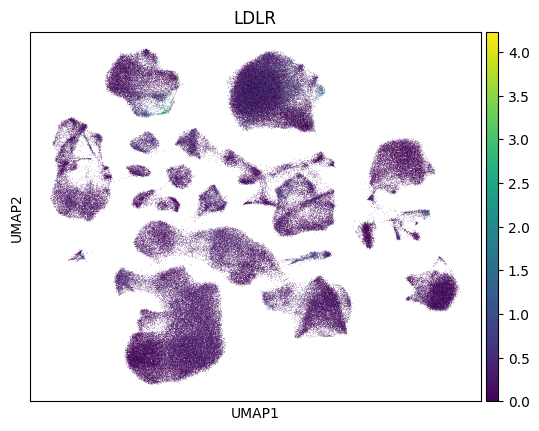

Plotting: CNTNAP3B
adjusted p-value: 0.0


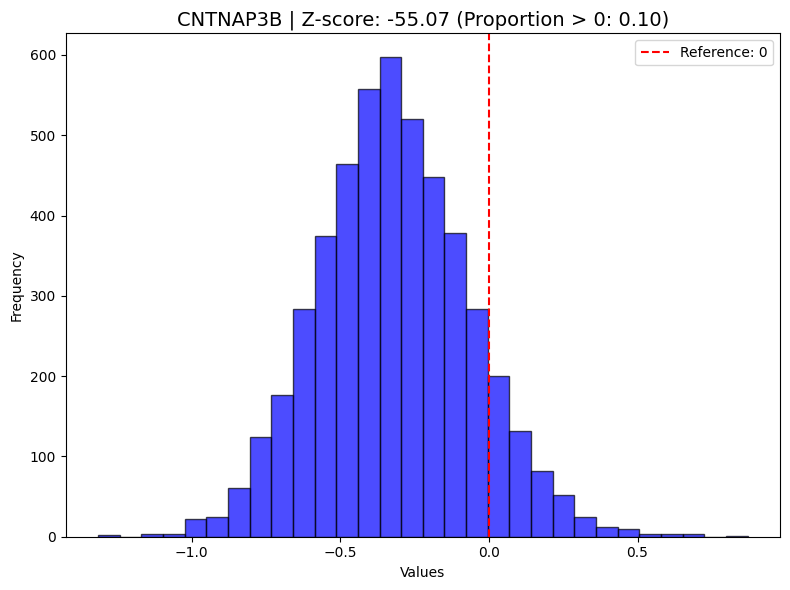

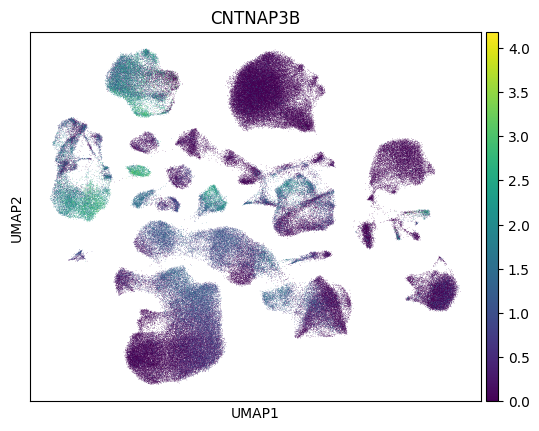

Plotting: ALDH1A1
adjusted p-value: 0.0


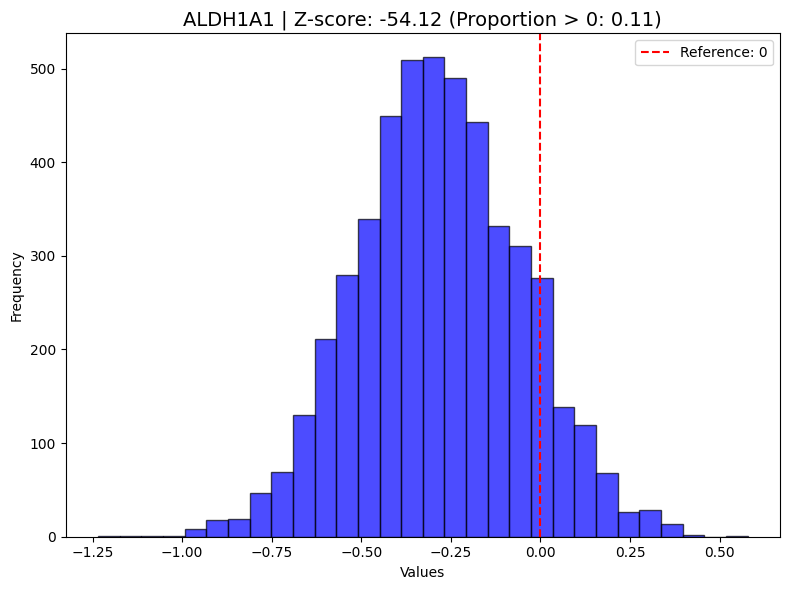

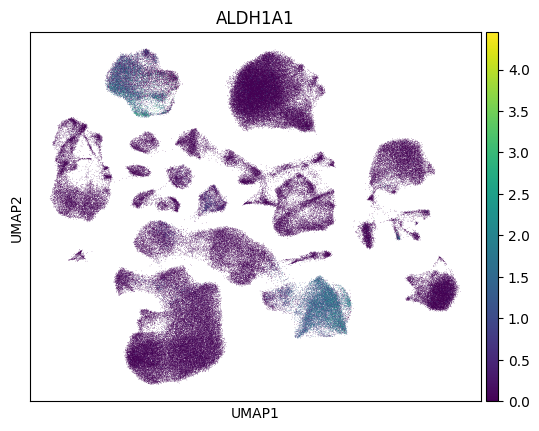

Plotting: GBP2
adjusted p-value: 0.0


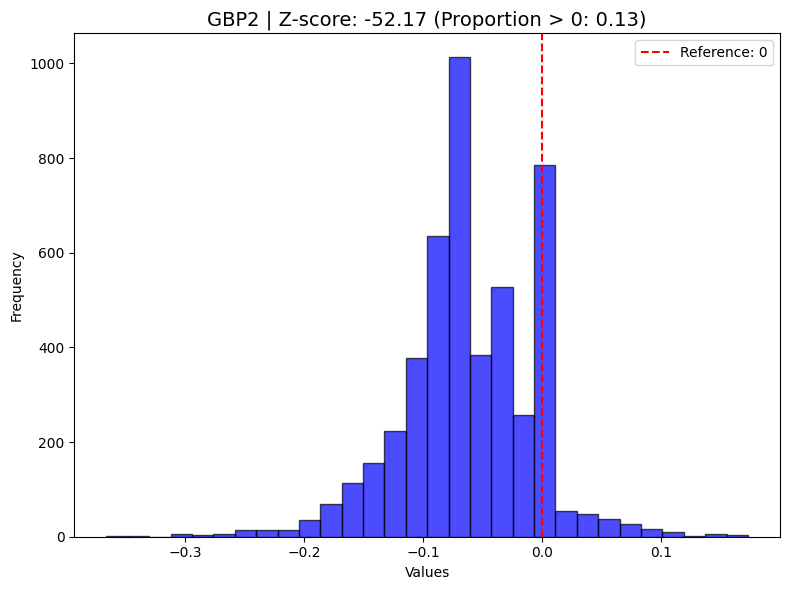

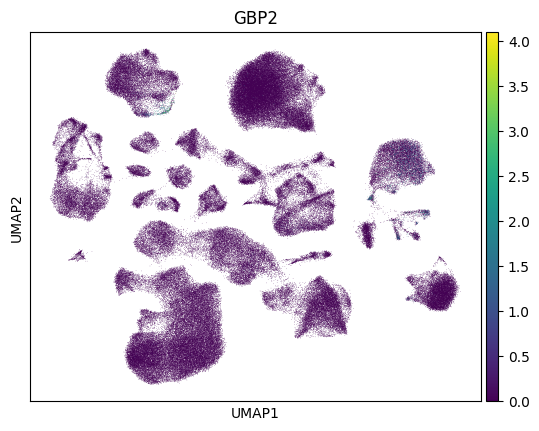

Calculating up-regulation
['CNTNAP3B', 'ALDH1A1', 'SLC1A3', 'LDLR', 'SAT1', 'GBP2', 'GPCPD1', 'F3', 'NAMPT', 'FTH1', 'CHI3L1', 'PLSCR1', 'FGF1', 'NRP2', 'GNA14', 'MGST1', 'NRP1', 'SDS', 'ZFP36', 'AKAP13', 'LMOD1', 'ITPR2', 'CD44', 'TUBB2B', 'SUSD6', 'SULF1', 'EMP1', 'HSPH1', 'SLC44A3', 'SOCS3', 'CRIM1', 'YBX3', 'ENTPD1', 'PDZD2', 'CDKN1A', 'FBXL7', 'CLIC4', 'MARCH3', 'NDRG1', 'DNAJA4', 'LIMS1', 'PROS1', 'PTN', 'SERPINH1', 'SLC25A37', 'PMP2', 'FAM189A2', 'MAP3K14', 'LRRC3B', 'MSI2', 'CEMIP', 'SORBS1', 'GBP1', 'EPAS1', 'FGFR2', 'ETV6', 'CD38', 'SPOCD1', 'RGS20', 'OPHN1', 'HSPD1', 'WARS', 'H3F3B', 'IL6R', 'GADD45B', 'DNAJB1', 'LMO2', 'DCLK2', 'ANXA8', 'BMPR1B', 'OSMR', 'CACHD1', 'BAG3', 'IGFN1', 'BAALC', 'FN1', 'ABCC9', 'HSPA1B', 'EPB41L4A', 'NPAS3', 'PRELID2', 'IGFBP7', 'STON2', 'IFI44L', 'COL5A2', 'CYR61', 'C11orf96', 'IFI44', 'MGAT4C', 'CNN3', 'DTNA', 'S100B', 'THSD4', 'PRUNE2', 'HES4', 'C4orf19', 'LRIG1', 'FOS', 'NUP62CL', 'RPL41', 'PARP14', 'KIAA0040', 'LIMK2', 'RGS16', 'CHSY1', 'SFN

<Figure size 1000x600 with 0 Axes>

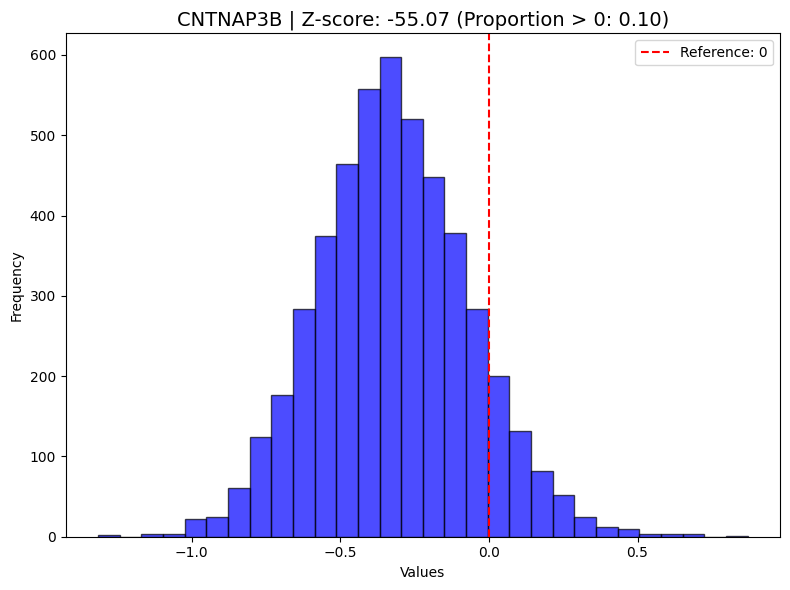

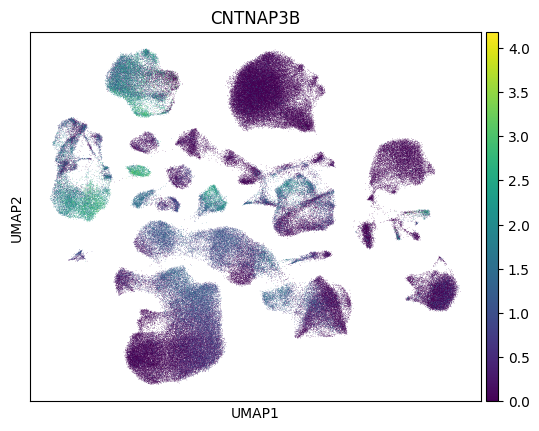

Plotting: ALDH1A1
adjusted p-value: 0.0


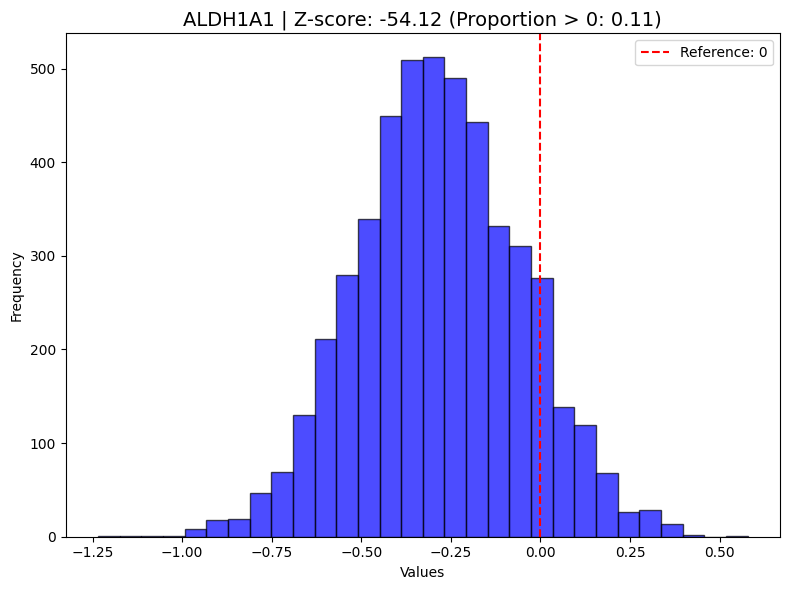

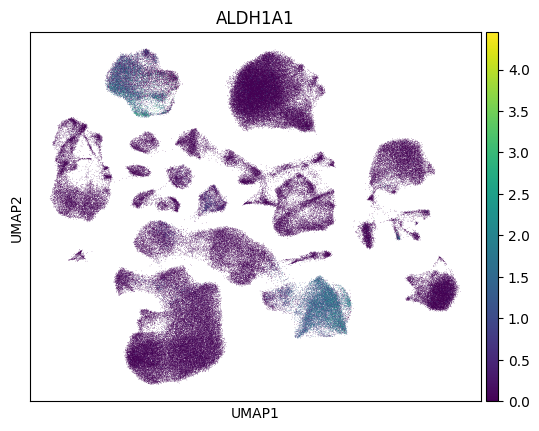

Plotting: SLC1A3
adjusted p-value: 0.0


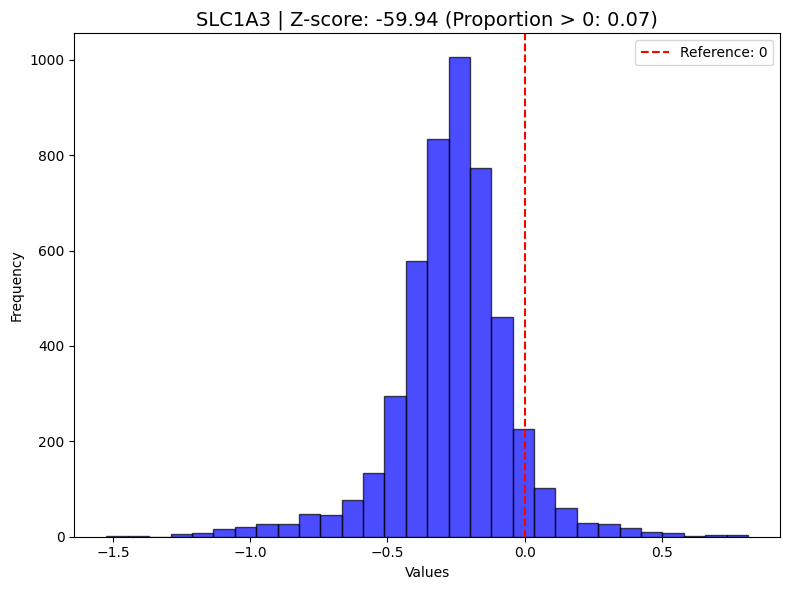

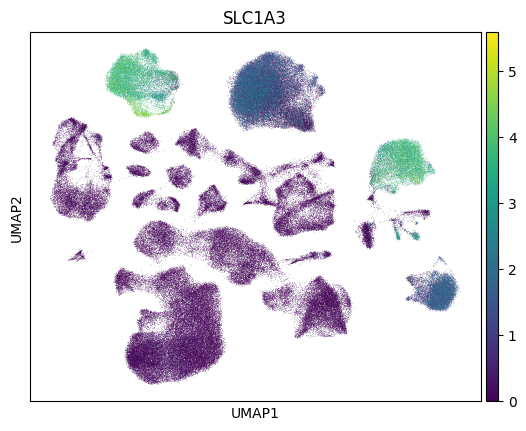

Plotting: LDLR
adjusted p-value: 0.0


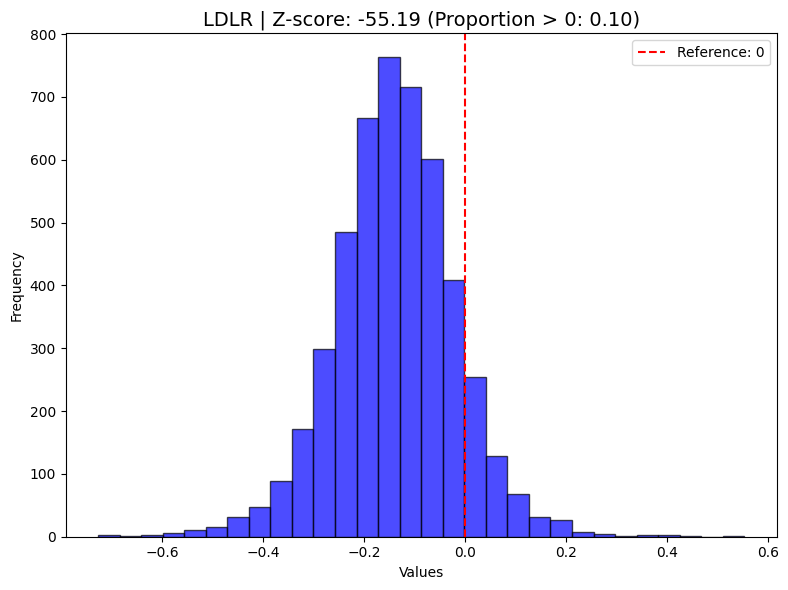

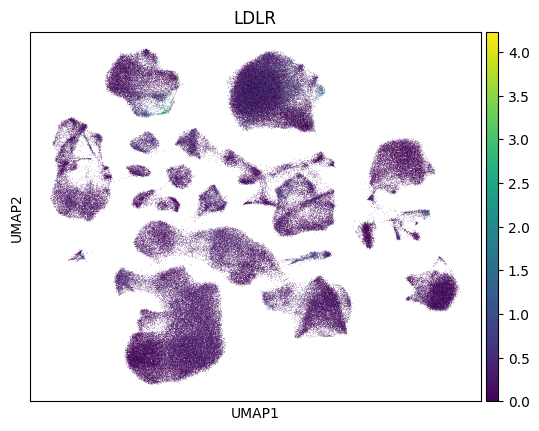

Plotting: SAT1
adjusted p-value: 0.0


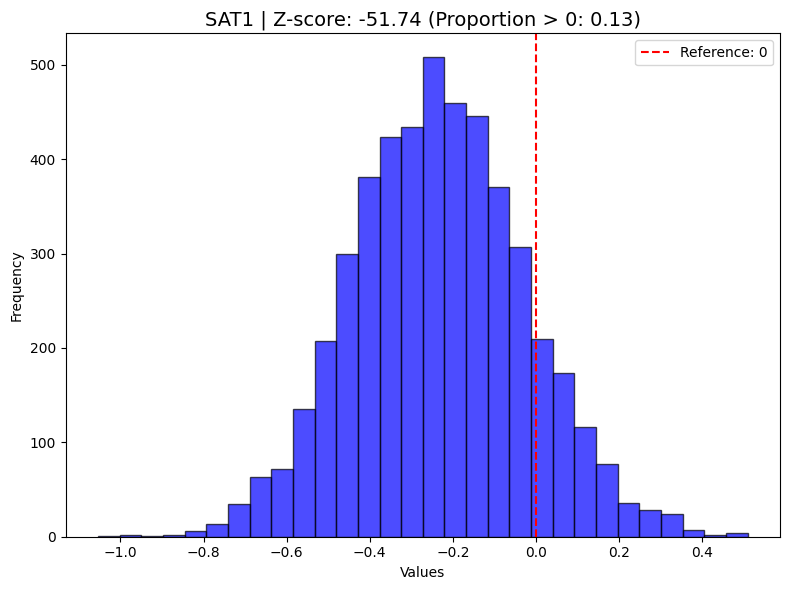

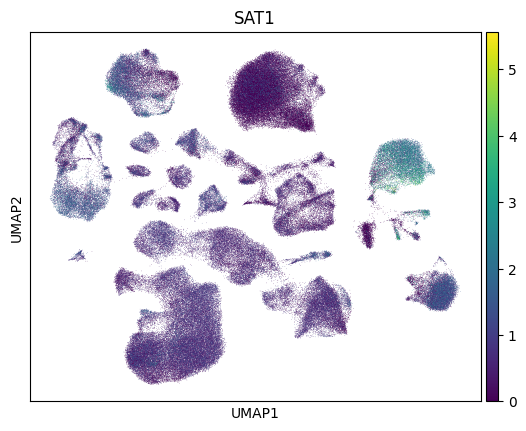

['CNTNAP3B',
 'ALDH1A1',
 'SLC1A3',
 'LDLR',
 'SAT1',
 'GBP2',
 'GPCPD1',
 'F3',
 'NAMPT',
 'FTH1',
 'CHI3L1',
 'PLSCR1',
 'FGF1',
 'NRP2',
 'GNA14',
 'MGST1',
 'NRP1',
 'SDS',
 'ZFP36',
 'AKAP13',
 'LMOD1',
 'ITPR2',
 'CD44',
 'TUBB2B',
 'SUSD6',
 'SULF1',
 'EMP1',
 'HSPH1',
 'SLC44A3',
 'SOCS3',
 'CRIM1',
 'YBX3',
 'ENTPD1',
 'PDZD2',
 'CDKN1A',
 'FBXL7',
 'CLIC4',
 'MARCH3',
 'NDRG1',
 'DNAJA4',
 'LIMS1',
 'PROS1',
 'PTN',
 'SERPINH1',
 'SLC25A37',
 'PMP2',
 'FAM189A2',
 'MAP3K14',
 'LRRC3B',
 'MSI2',
 'CEMIP',
 'SORBS1',
 'GBP1',
 'EPAS1',
 'FGFR2',
 'ETV6',
 'CD38',
 'SPOCD1',
 'RGS20',
 'OPHN1',
 'HSPD1',
 'WARS',
 'H3F3B',
 'IL6R',
 'GADD45B',
 'DNAJB1',
 'LMO2',
 'DCLK2',
 'ANXA8',
 'BMPR1B',
 'OSMR',
 'CACHD1',
 'BAG3',
 'IGFN1',
 'BAALC',
 'FN1',
 'ABCC9',
 'HSPA1B',
 'EPB41L4A',
 'NPAS3',
 'PRELID2',
 'IGFBP7',
 'STON2',
 'IFI44L',
 'COL5A2',
 'CYR61',
 'C11orf96',
 'IFI44',
 'MGAT4C',
 'CNN3',
 'DTNA',
 'S100B',
 'THSD4',
 'PRUNE2',
 'HES4',
 'C4orf19',
 'LRIG1',
 'FOS',
 '

In [8]:
indices=ITE.obs["minor.celltype"]=='Ast'
Plot_and_Estimate_CATE_adata(ITE,indices,up_regulate=True)
print("="*20)
Plot_and_Estimate_CATE_adata(ITE,indices,parametric=True,up_regulate=True)

Calculating up-regulation
['SLC1A3', 'LDLR', 'CNTNAP3B', 'ALDH1A1', 'GBP2', 'SAT1', 'GPCPD1', 'F3', 'FTH1', 'NAMPT', 'GNA14', 'CHI3L1', 'ITPR2', 'FGF1', 'NRP2', 'PLSCR1', 'MSI2', 'MGST1', 'SORBS1', 'CD44', 'LMOD1', 'ZFP36', 'SULF1', 'AKAP13', 'NRP1', 'SDS', 'CDKN1A', 'EMP1', 'HSPH1', 'SUSD6', 'TUBB2B', 'FBXL7', 'SOCS3', 'NPAS3', 'PDZD2', 'SLC44A3', 'ENTPD1', 'YBX3', 'DTNA', 'CRIM1', 'OPHN1', 'CLIC4', 'NDRG1', 'FAM189A2', 'CEMIP', 'PREX2', 'GADD45B', 'SERPINH1', 'GPC5', 'DNAJA4', 'PROS1', 'LIMS1', 'C11orf96', 'GBP1', 'MARCH3', 'IFI44L', 'FGFR2', 'RGS20', 'PTN', 'HSPD1', 'CD38', 'SLC25A37', 'DCLK2', 'PMP2', 'THSD4', 'LMO2', 'MAP3K14', 'ETV6', 'EPAS1', 'LRRC3B', 'BMPR1B', 'CACHD1', 'WARS', 'IL6R', 'IGFN1', 'DNAJB1', 'H3F3B', 'FOS', 'HSPA1B', 'SPOCD1', 'PRELID2', 'COL5A2', 'ANXA8', 'PRUNE2', 'STON2', 'OSMR', 'FN1', 'RGS16', 'S100B', 'IFI44', 'LIMK2', 'HES4', 'BAG3', 'PODXL', 'COL4A1', 'LRIG1', 'CYR61', 'ANXA2', 'EPB41L4A', 'CNN3', 'BMX', 'C4orf19', 'BAALC', 'DHCR24', 'PARP14', 'ABCC9', 'KC

<Figure size 1000x600 with 0 Axes>

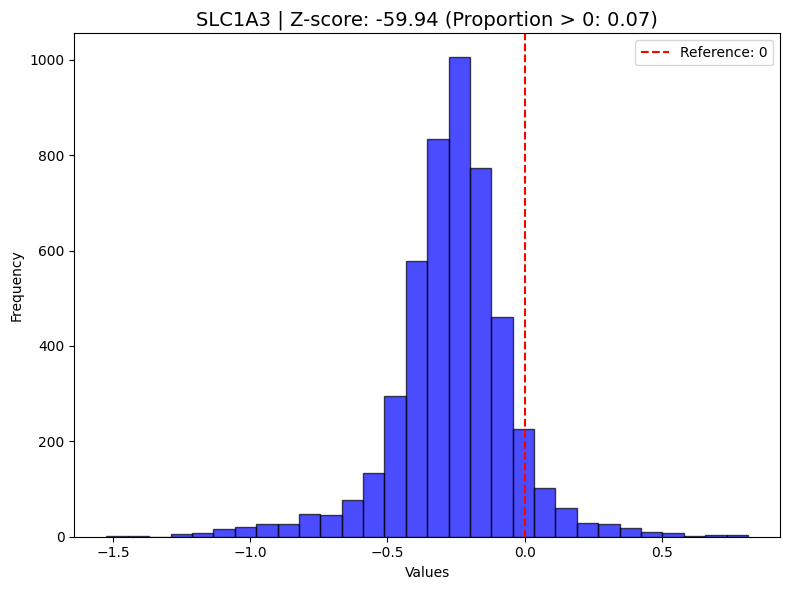

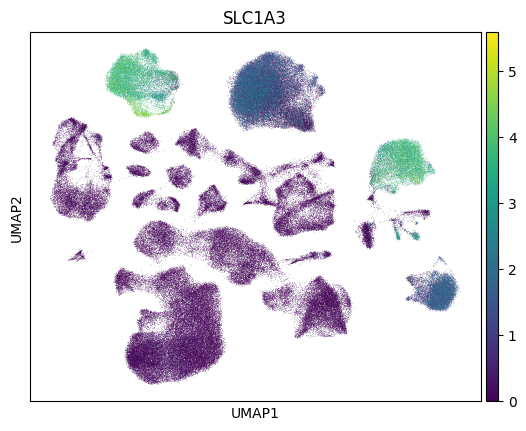

Plotting: LDLR
adjusted p-value: 0.0


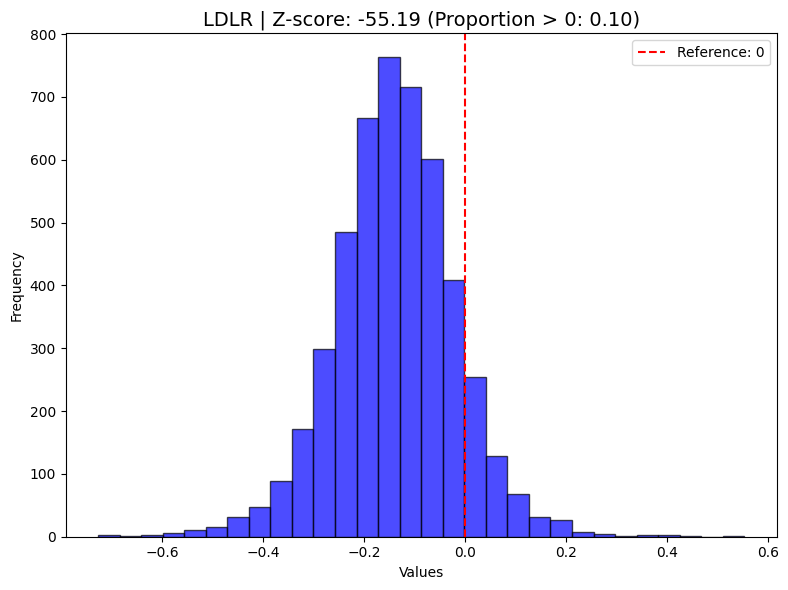

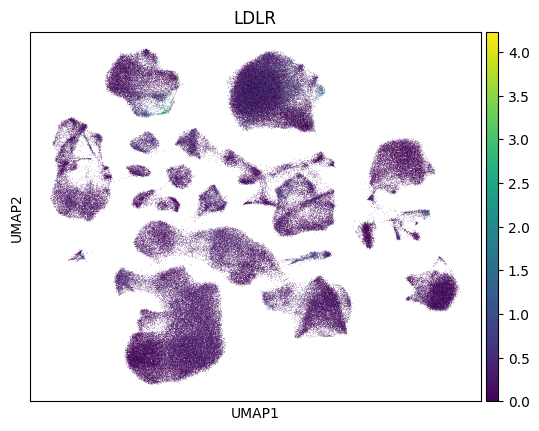

Plotting: CNTNAP3B
adjusted p-value: 0.0


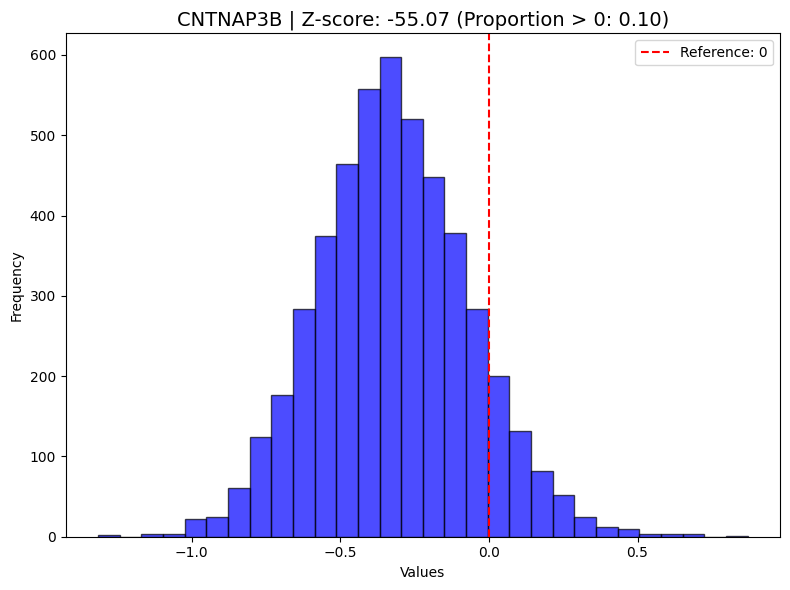

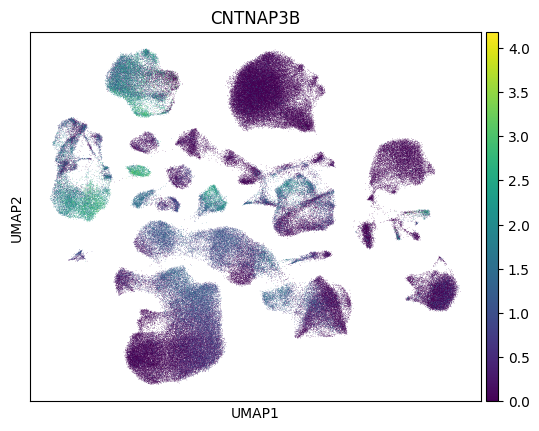

Plotting: ALDH1A1
adjusted p-value: 0.0


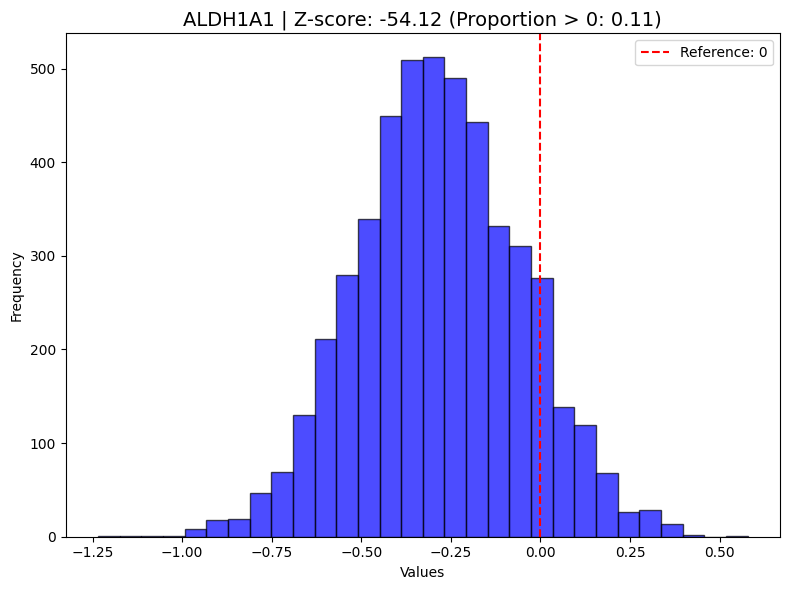

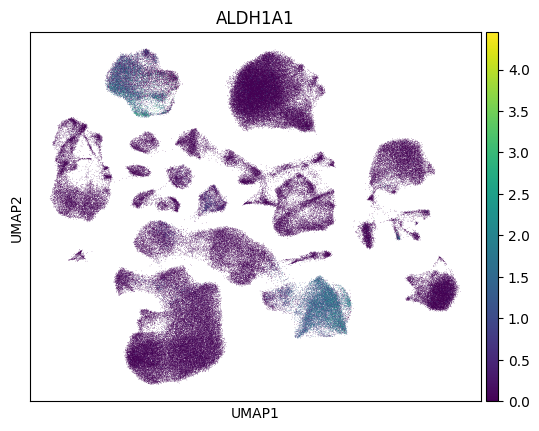

Plotting: GBP2
adjusted p-value: 0.0


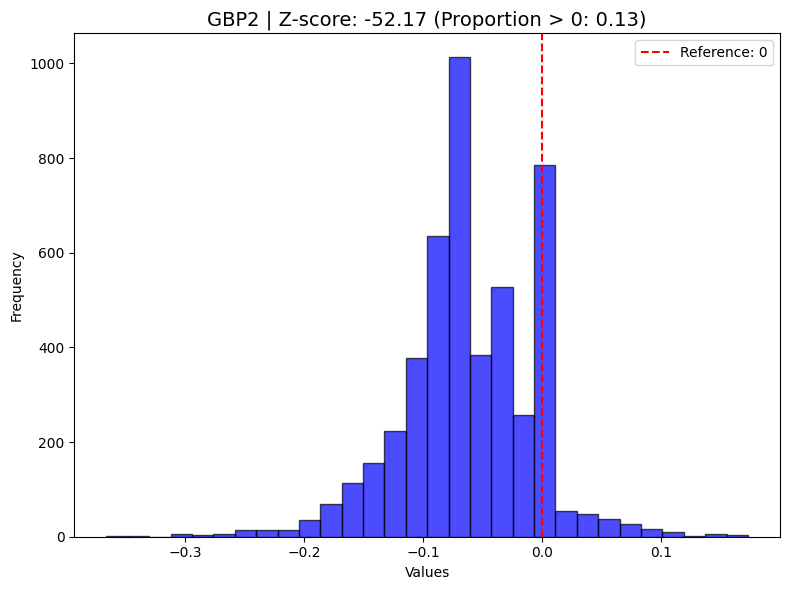

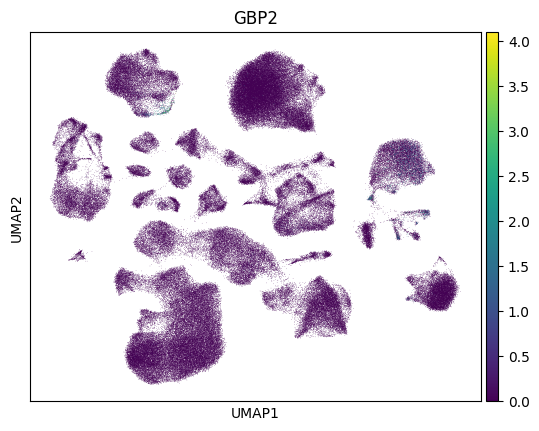

Calculating up-regulation
['CNTNAP3B', 'ALDH1A1', 'SLC1A3', 'LDLR', 'SAT1', 'GBP2', 'GPCPD1', 'F3', 'NAMPT', 'FTH1', 'CHI3L1', 'PLSCR1', 'FGF1', 'NRP2', 'GNA14', 'MGST1', 'NRP1', 'SDS', 'ZFP36', 'AKAP13', 'LMOD1', 'ITPR2', 'CD44', 'TUBB2B', 'SUSD6', 'SULF1', 'EMP1', 'HSPH1', 'SLC44A3', 'SOCS3', 'CRIM1', 'YBX3', 'ENTPD1', 'PDZD2', 'CDKN1A', 'FBXL7', 'CLIC4', 'MARCH3', 'NDRG1', 'DNAJA4', 'LIMS1', 'PROS1', 'PTN', 'SERPINH1', 'SLC25A37', 'PMP2', 'FAM189A2', 'MAP3K14', 'LRRC3B', 'MSI2', 'CEMIP', 'SORBS1', 'GBP1', 'EPAS1', 'FGFR2', 'ETV6', 'CD38', 'SPOCD1', 'RGS20', 'OPHN1', 'HSPD1', 'WARS', 'H3F3B', 'IL6R', 'GADD45B', 'DNAJB1', 'LMO2', 'DCLK2', 'ANXA8', 'BMPR1B', 'OSMR', 'CACHD1', 'BAG3', 'IGFN1', 'BAALC', 'FN1', 'ABCC9', 'HSPA1B', 'EPB41L4A', 'NPAS3', 'PRELID2', 'IGFBP7', 'STON2', 'IFI44L', 'COL5A2', 'CYR61', 'C11orf96', 'IFI44', 'MGAT4C', 'CNN3', 'DTNA', 'S100B', 'THSD4', 'PRUNE2', 'HES4', 'C4orf19', 'LRIG1', 'FOS', 'NUP62CL', 'RPL41', 'PARP14', 'KIAA0040', 'LIMK2', 'RGS16', 'CHSY1', 'SFN

<Figure size 1000x600 with 0 Axes>

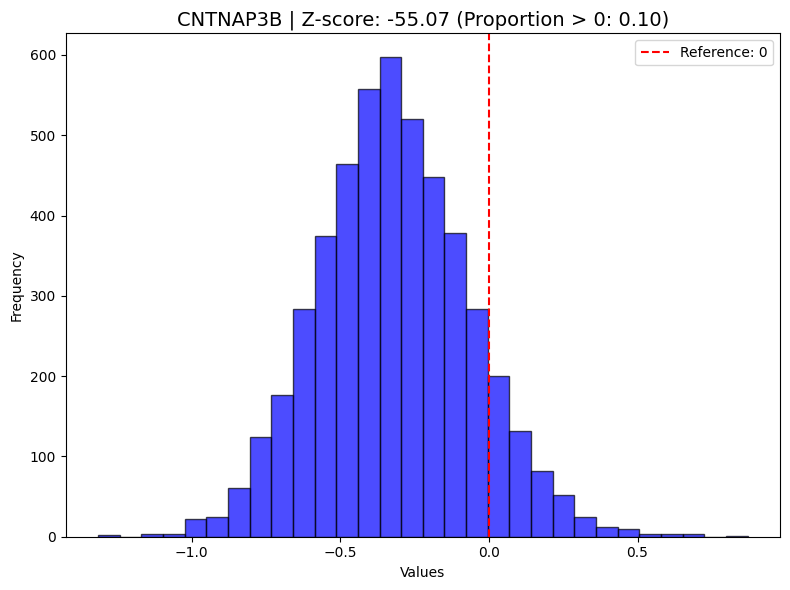

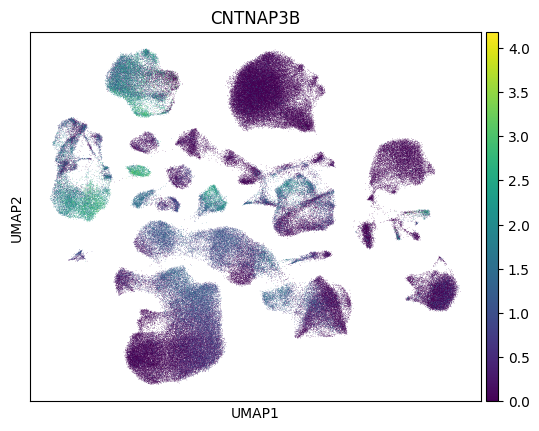

Plotting: ALDH1A1
adjusted p-value: 0.0


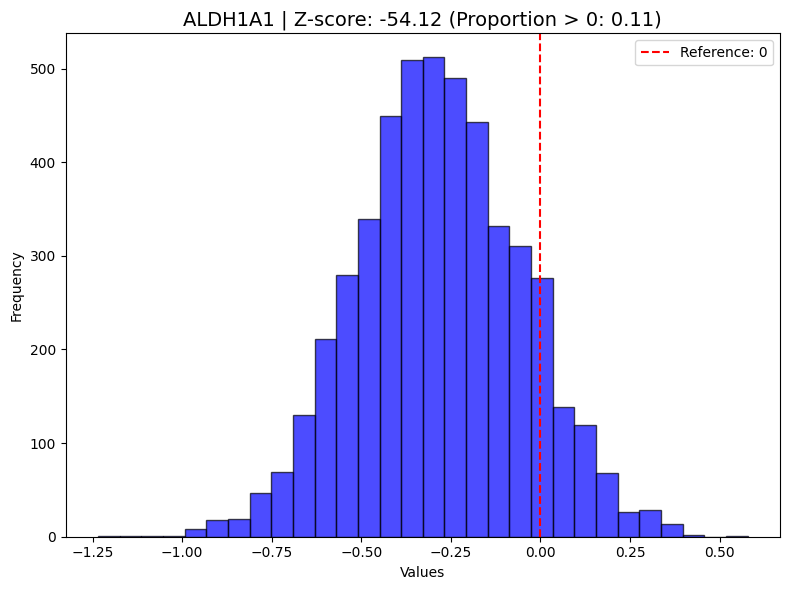

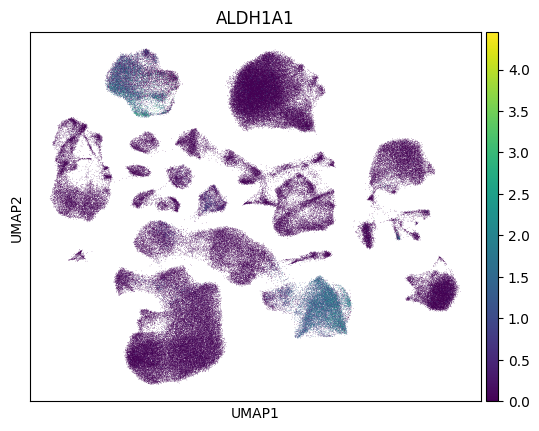

Plotting: SLC1A3
adjusted p-value: 0.0


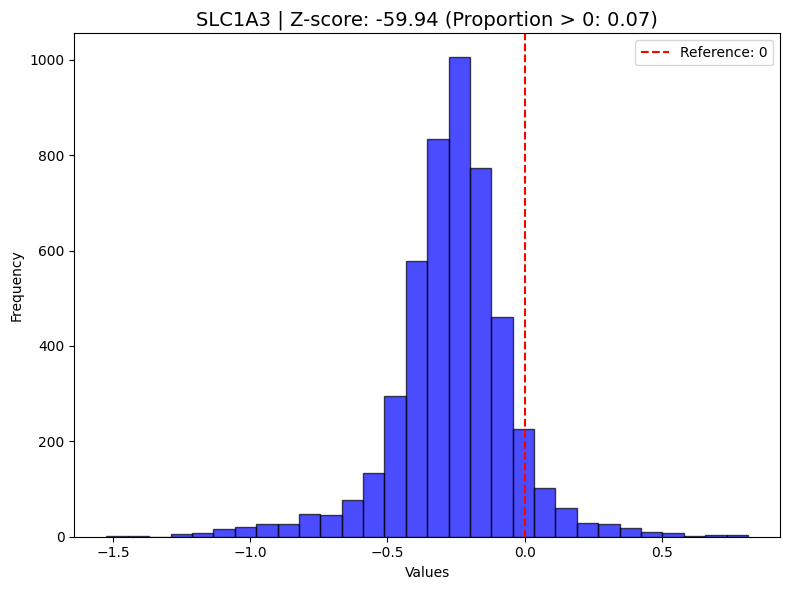

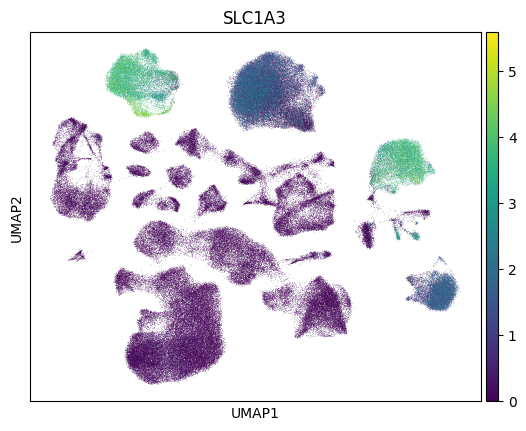

Plotting: LDLR
adjusted p-value: 0.0


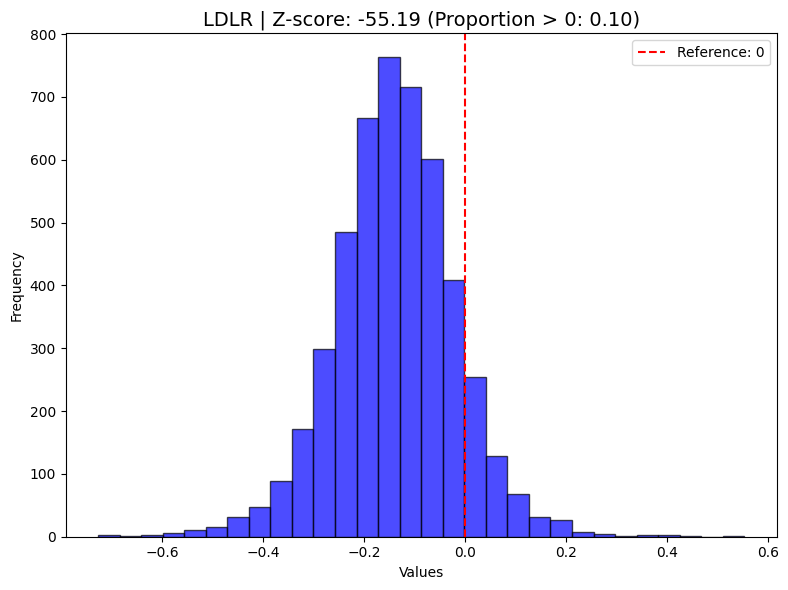

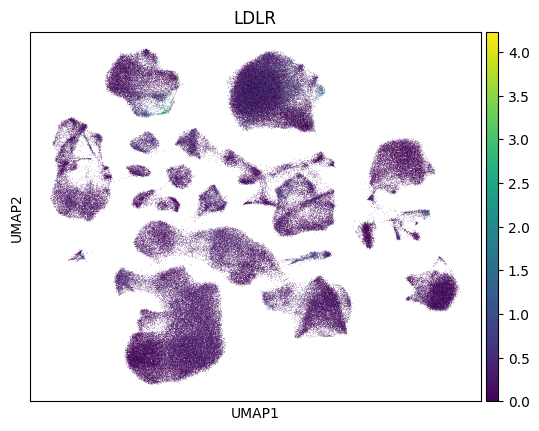

Plotting: SAT1
adjusted p-value: 0.0


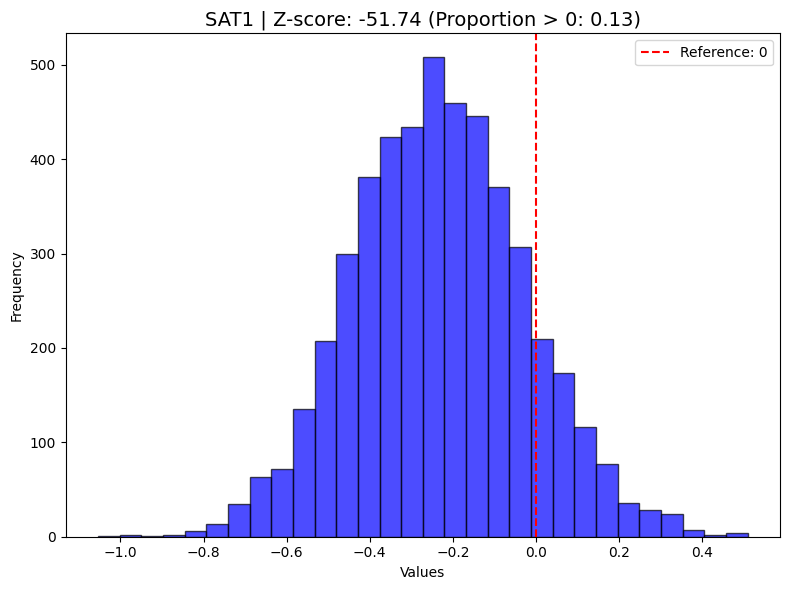

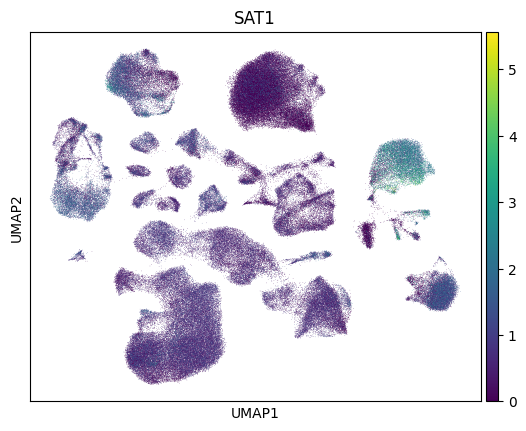

['CNTNAP3B',
 'ALDH1A1',
 'SLC1A3',
 'LDLR',
 'SAT1',
 'GBP2',
 'GPCPD1',
 'F3',
 'NAMPT',
 'FTH1',
 'CHI3L1',
 'PLSCR1',
 'FGF1',
 'NRP2',
 'GNA14',
 'MGST1',
 'NRP1',
 'SDS',
 'ZFP36',
 'AKAP13',
 'LMOD1',
 'ITPR2',
 'CD44',
 'TUBB2B',
 'SUSD6',
 'SULF1',
 'EMP1',
 'HSPH1',
 'SLC44A3',
 'SOCS3',
 'CRIM1',
 'YBX3',
 'ENTPD1',
 'PDZD2',
 'CDKN1A',
 'FBXL7',
 'CLIC4',
 'MARCH3',
 'NDRG1',
 'DNAJA4',
 'LIMS1',
 'PROS1',
 'PTN',
 'SERPINH1',
 'SLC25A37',
 'PMP2',
 'FAM189A2',
 'MAP3K14',
 'LRRC3B',
 'MSI2',
 'CEMIP',
 'SORBS1',
 'GBP1',
 'EPAS1',
 'FGFR2',
 'ETV6',
 'CD38',
 'SPOCD1',
 'RGS20',
 'OPHN1',
 'HSPD1',
 'WARS',
 'H3F3B',
 'IL6R',
 'GADD45B',
 'DNAJB1',
 'LMO2',
 'DCLK2',
 'ANXA8',
 'BMPR1B',
 'OSMR',
 'CACHD1',
 'BAG3',
 'IGFN1',
 'BAALC',
 'FN1',
 'ABCC9',
 'HSPA1B',
 'EPB41L4A',
 'NPAS3',
 'PRELID2',
 'IGFBP7',
 'STON2',
 'IFI44L',
 'COL5A2',
 'CYR61',
 'C11orf96',
 'IFI44',
 'MGAT4C',
 'CNN3',
 'DTNA',
 'S100B',
 'THSD4',
 'PRUNE2',
 'HES4',
 'C4orf19',
 'LRIG1',
 'FOS',
 '

In [9]:
indices=ITE.obs["minor.celltype"]=='Ast'
Plot_and_Estimate_CATE_adata(ITE,indices,up_regulate=True)
print("="*20)
Plot_and_Estimate_CATE_adata(ITE,indices,parametric=True,up_regulate=True)

Calculating up-regulation
['GLDN', 'KCNH8', 'PDE8A', 'PHLDB1', 'BCAS1', 'OPALIN', 'LTBP1', 'PALM2', 'TMEM144', 'CERCAM', 'CTNNA3', 'SEMA3B', 'MOBP', 'POLR2F', 'FOLH1', 'HSPB1', 'LPAR1', 'PLEKHH1', 'PCDH9', 'CARNS1', 'GPCPD1', 'IL6R', 'PDE4B', 'CREB5', 'LDB3', 'ROBO1', 'PLXDC2', 'TP53TG5', 'PDGFD', 'NEK3', 'FGFR1', 'CDH4', 'MATN2', 'COLEC12', 'HS3ST5', 'FRMD4B', 'DNAJA4', 'HES4', 'FMN1', 'ABCA1', 'CFAP54', 'GDNF', 'DISC1', 'ASPA', 'EGR1', 'KCNAB1', 'ETS1', 'ZFHX3', 'SLC25A37', 'DOCK10', 'SLC35D2', 'MT1E', 'COL4A5', 'IFI16', 'HS6ST3', 'SORCS1', 'ADAMTS4', 'TRIM59', 'SOX6', 'FAM126A', 'CFTR', 'ADGRA3', 'NOS1', 'DAAM2', 'RUNX2', 'ZBTB20', 'CLIC4', 'ADGRG1', 'ST6GALNAC5', 'WIPF1', 'GREM1', 'SLC25A13', 'RASGRP3', 'SUCLG2', 'DAPK2', 'ATP10B', 'CPB1', 'CD55', 'CREG2', 'ROR1', 'FOS', 'CHODL', 'HHIP', 'SLC6A1', 'CDH9', 'KCNQ5', 'SOCS3', 'COL5A2', 'INPP4B', 'SERPINH1', 'PROS1', 'PAG1', 'BAG3', 'FAXDC2', 'VWF', 'SNTB1', 'GADD45B', 'PLLP', 'WLS', 'DCLK2', 'TMTC2', 'SAT1', 'ZSCAN31', 'GLI3', 'NAMPT'

<Figure size 1000x600 with 0 Axes>

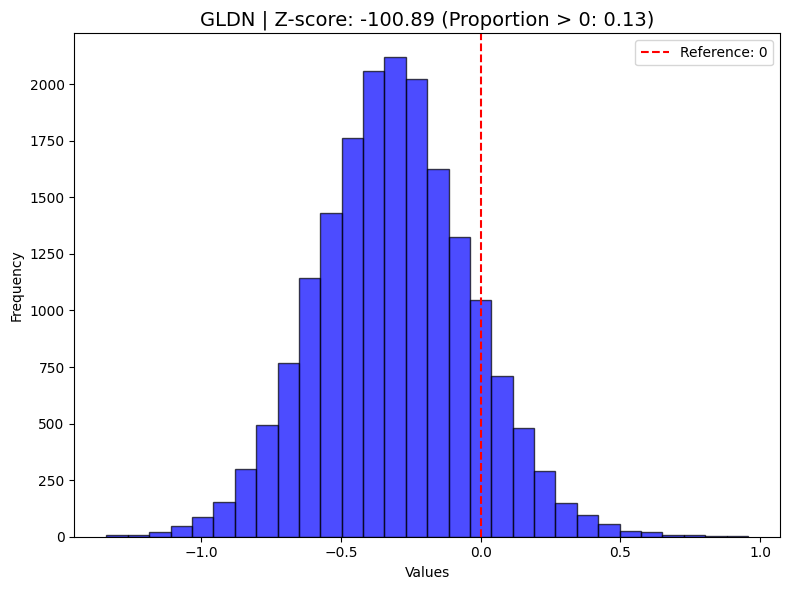

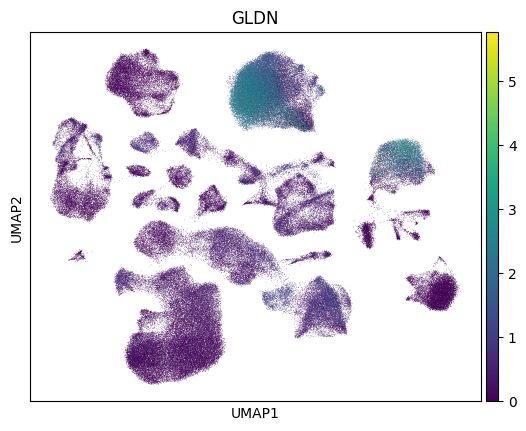

Plotting: KCNH8
adjusted p-value: 0.0


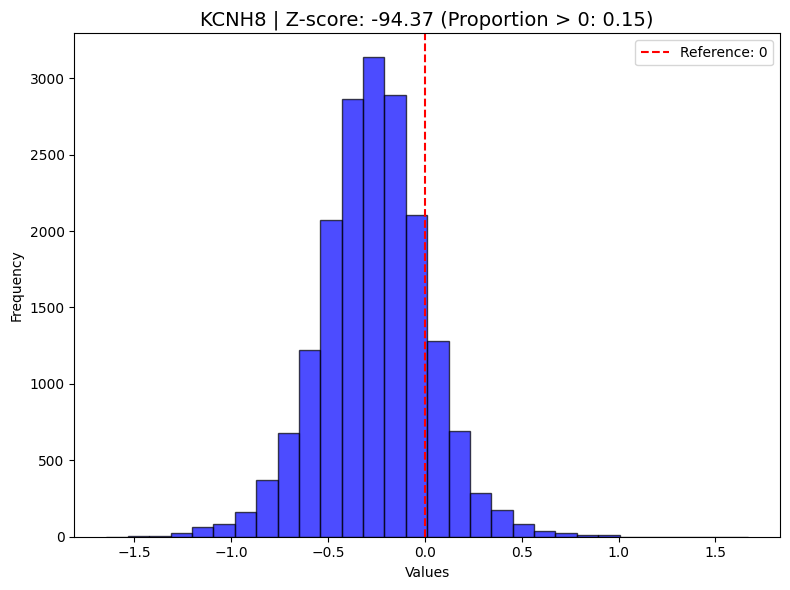

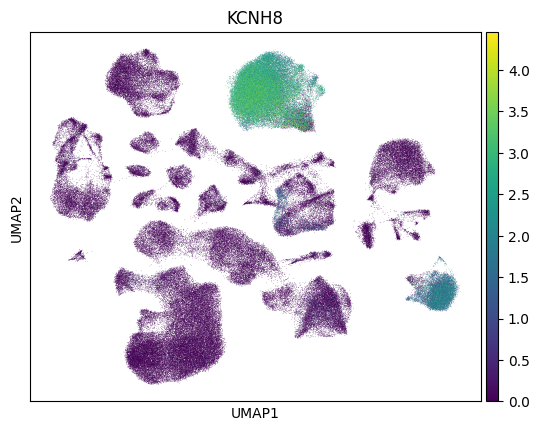

Plotting: PDE8A
adjusted p-value: 0.0


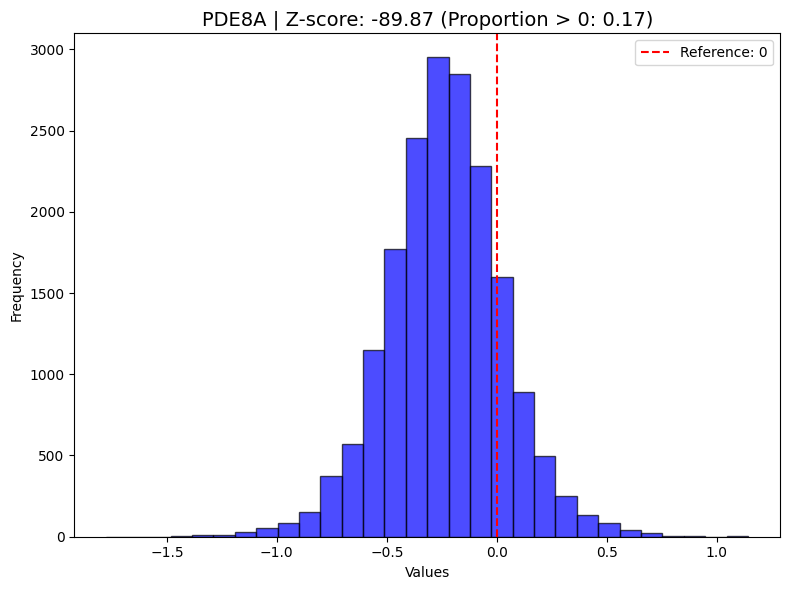

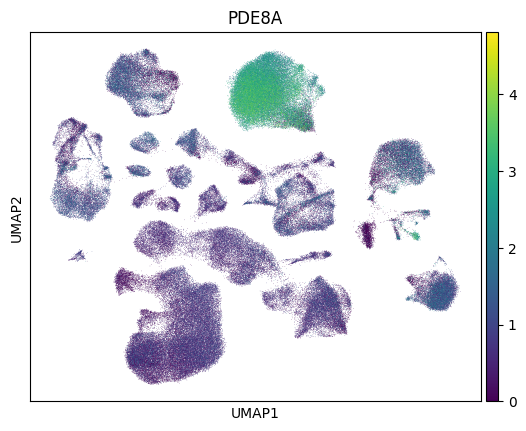

Plotting: PHLDB1
adjusted p-value: 0.0


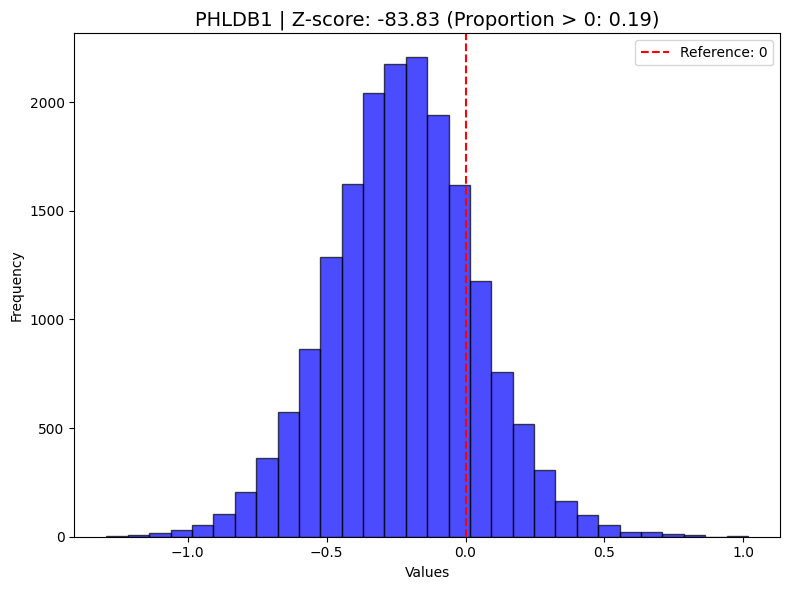

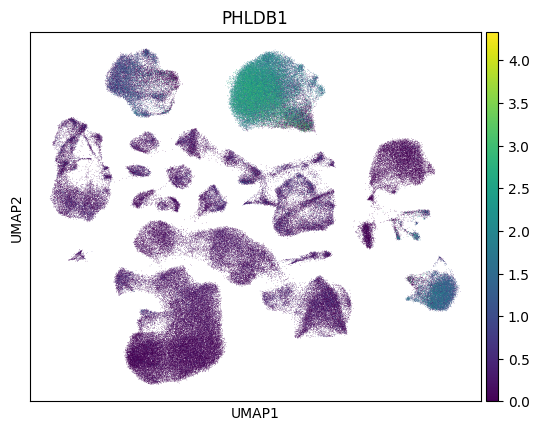

Plotting: BCAS1
adjusted p-value: 0.0


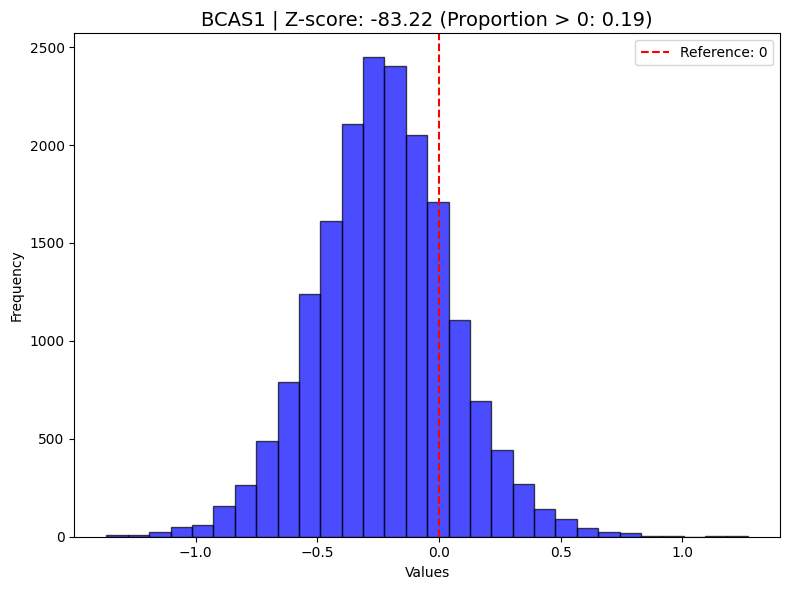

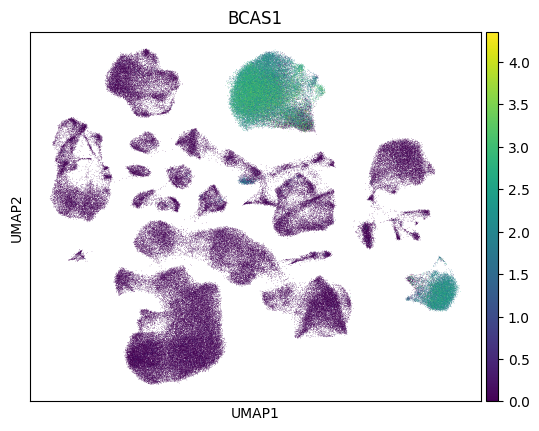

Calculating up-regulation
['GLDN', 'KCNH8', 'PDE8A', 'OPALIN', 'LTBP1', 'PHLDB1', 'BCAS1', 'PALM2', 'CERCAM', 'SEMA3B', 'POLR2F', 'MOBP', 'FOLH1', 'TMEM144', 'LPAR1', 'CTNNA3', 'PLEKHH1', 'CARNS1', 'PCDH9', 'HSPB1', 'ROBO1', 'GPCPD1', 'CREB5', 'LDB3', 'IL6R', 'PLXDC2', 'TP53TG5', 'NEK3', 'PDE4B', 'HS3ST5', 'MATN2', 'FGFR1', 'FRMD4B', 'ABCA1', 'KCNAB1', 'DNAJA4', 'DISC1', 'CDH4', 'PDGFD', 'ASPA', 'FMN1', 'COLEC12', 'COL4A5', 'IFI16', 'ZFHX3', 'SLC35D2', 'FAM126A', 'EGR1', 'ADAMTS4', 'TRIM59', 'SLC25A37', 'ARC', 'CLIC4', 'SLC25A13', 'WIPF1', 'ZBTB20', 'CFTR', 'DAAM2', 'CFAP54', 'RASGRP3', 'ETS1', 'DOCK10', 'CD55', 'GREM1', 'NOS1', 'ROR1', 'CREG2', 'SUCLG2', 'SLC6A1', 'SOX6', 'ATP10B', 'CPB1', 'HHIP', 'DAPK2', 'PLLP', 'GDNF', 'FAXDC2', 'HES4', 'MOG', 'PAG1', 'RUNX2', 'HS6ST3', 'SORCS1', 'SOCS3', 'DPP10', 'CHODL', 'PARD3B', 'MT1E', 'ENPP2', 'KCNQ5', 'TMTC2', 'NR4A3', 'CDH13', 'ERBB4', 'INPP4B', 'NFIA', 'BAALC', 'PROS1', 'SAT1', 'UACA', 'ST6GALNAC5', 'LRIG1', 'KCNIP4', 'CMTM5', 'NAMPT', 'JU

<Figure size 1000x600 with 0 Axes>

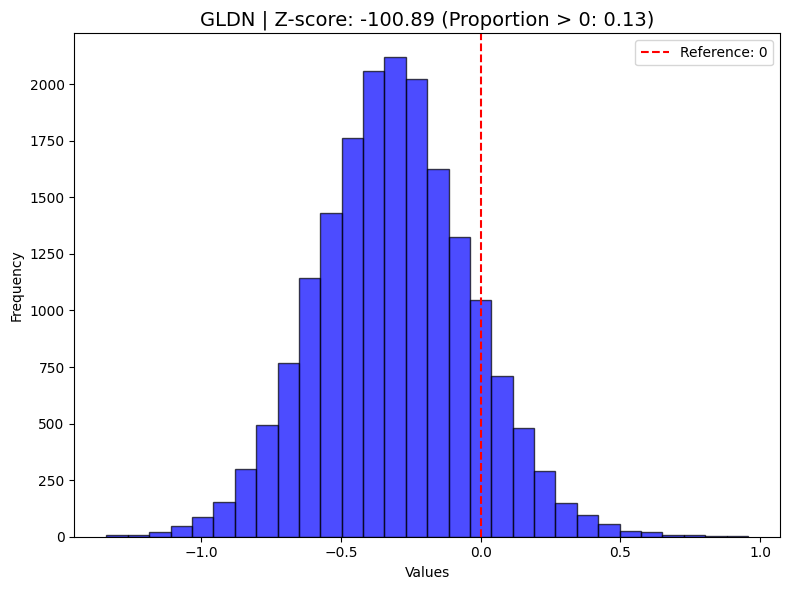

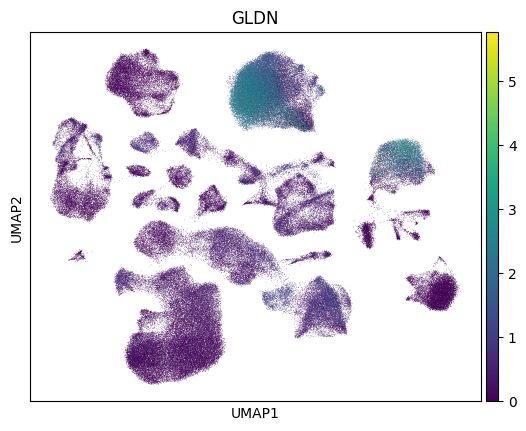

Plotting: KCNH8
adjusted p-value: 0.0


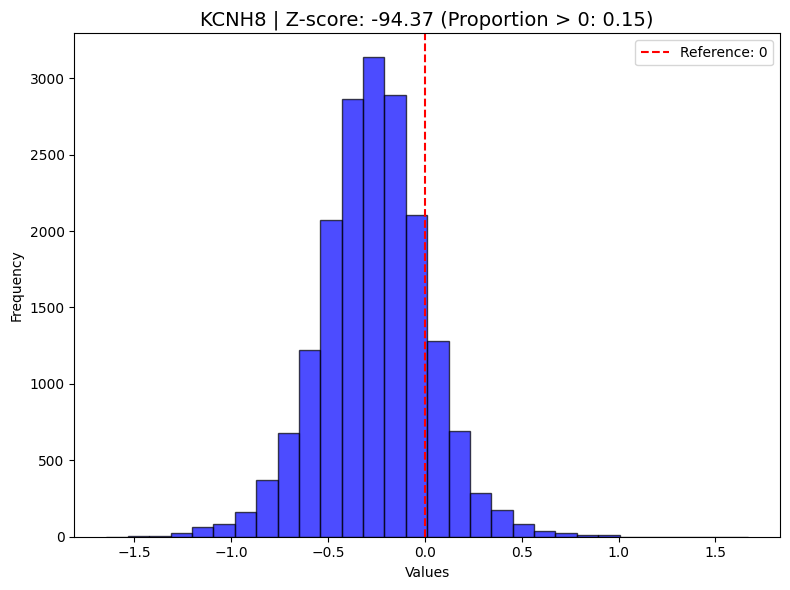

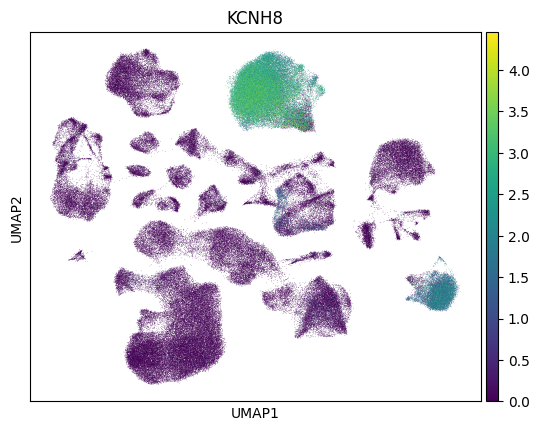

Plotting: PDE8A
adjusted p-value: 0.0


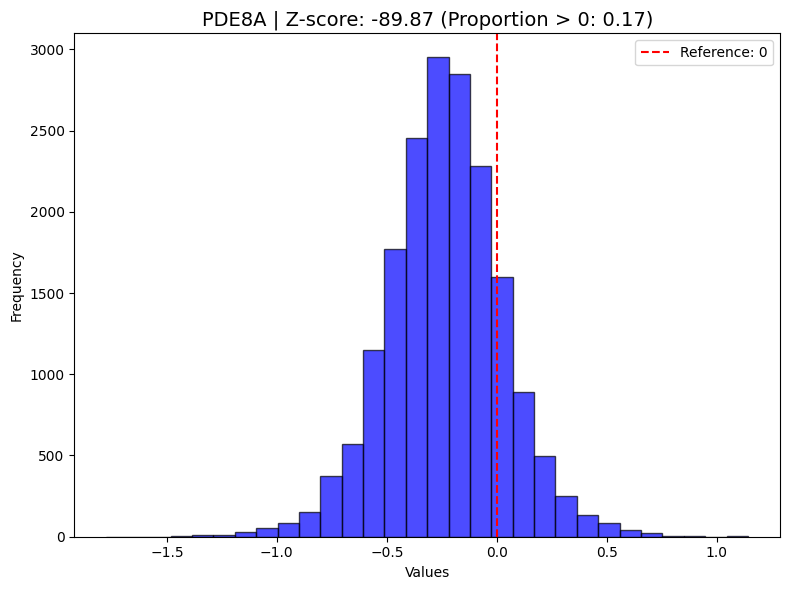

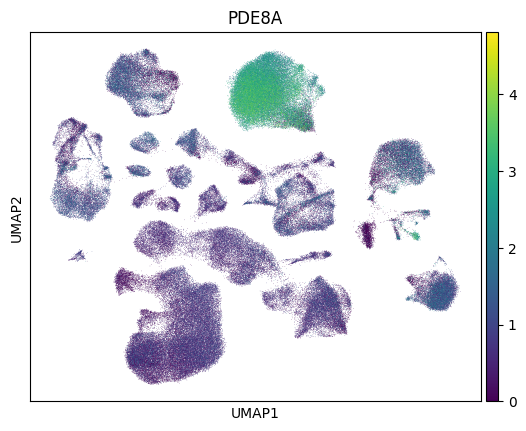

Plotting: OPALIN
adjusted p-value: 0.0


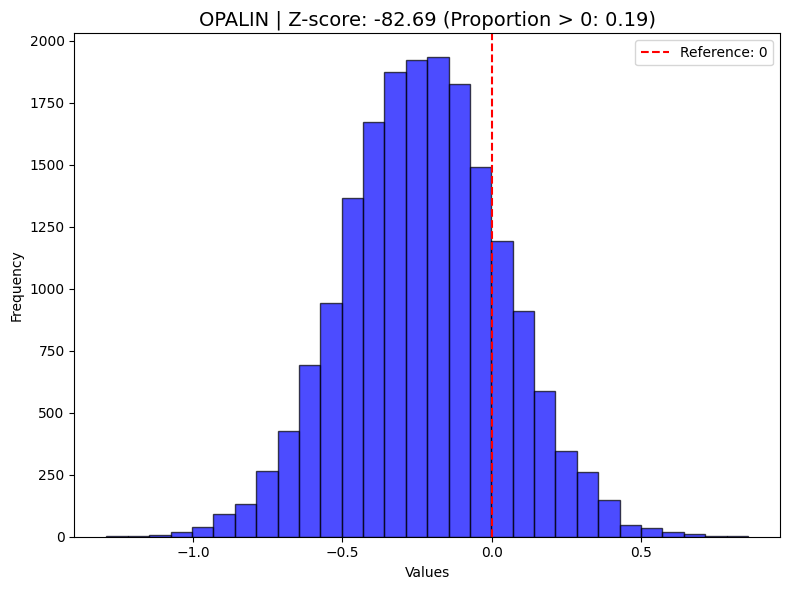

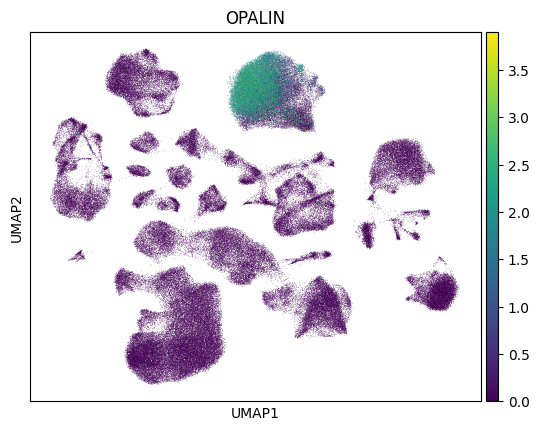

Plotting: LTBP1
adjusted p-value: 0.0


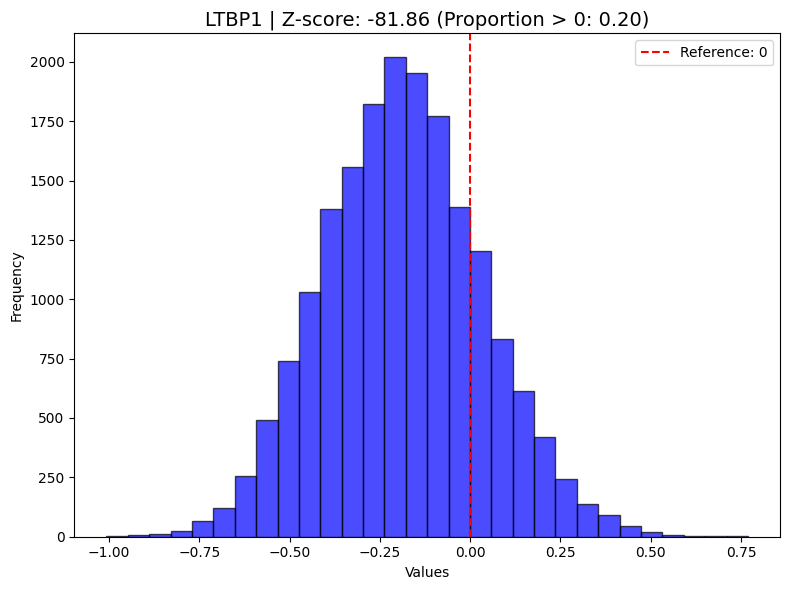

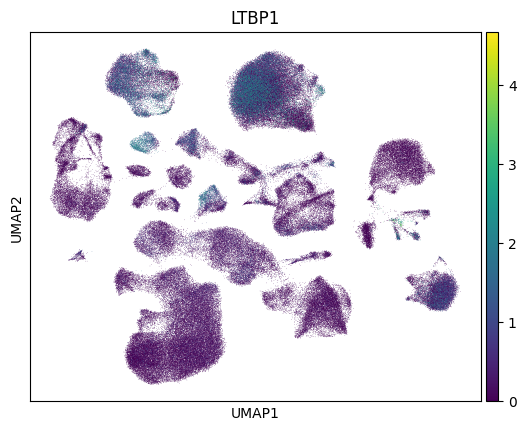

['FKBP5', 'QDPR', 'CHRM5', 'ANLN', 'ERBIN', 'SPP1', 'SLC39A11', 'PLCG2', 'SLC44A1', 'MID1IP1', 'SLC5A11', 'CPQ', 'SLC25A48', 'ADARB2', 'MT-ND3', 'TPD52L1', 'MAN2A1', 'EFHD1', 'RGCC', 'TF', 'NDRG1', 'ANKRD18A', 'NFKBIA', 'DHCR24', 'LRRC1', 'HSP90AA1', 'PLEKHH2', 'AMER2', 'MT-ND1', 'CLMN', 'CDKN1C', 'LAMP2', 'ADAMTSL3', 'KCNMB4', 'SMOC1', 'APOD', 'HSPA2', 'AZGP1', 'CA2', 'IRAK2', 'NKX6-2', 'ADAM12', 'KIF19', 'ERMN', 'SLCO1A2', 'PIEZO2', 'PRUNE2', 'GPRC5B', 'NDRG2', 'RASSF2', 'CSRP1', 'ADIPOR2', 'RFTN2', 'ABCA6', 'NDE1', 'MT-CO2', 'TTYH2', 'PDE1C', 'CDK18', 'SOX10', 'ADAMTS18', 'LRP4', 'PDK4', 'PLD5', 'SORL1', 'DOCK5', 'MRAS', 'ATP1B3', 'L3MBTL4', 'TMC6', 'DHFR', 'SLC35F3', 'RELN', 'ST18', 'KLK6', 'TECR', 'ZCCHC24', 'UGT8', 'UST', 'GAPDH', 'PLPP2', 'ST6GALNAC3', 'ITPR2', 'LHFPL2', 'COL9A2', 'HLA-A', 'TSC22D4', 'QKI', 'ELMO1', 'LRP2', 'MT3', 'TNS1', 'TMC8', 'FGF1', 'SLC2A1', 'DDIT4', 'ACSL1', 'CPM', 'S100A6', 'DPYSL5', 'GPR37', 'THBS2', 'SASH1', 'OGFRL1', 'CHST3', 'LDLRAD3', 'CXCR4', 'ARL1

<Figure size 1000x600 with 0 Axes>

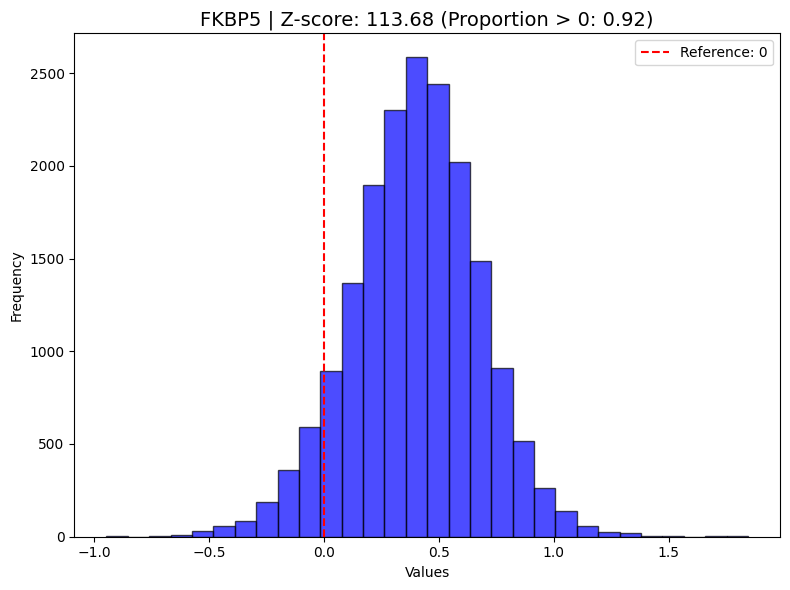

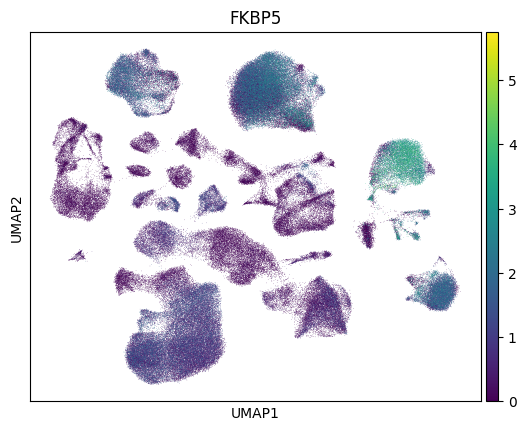

Plotting: QDPR
adjusted p-value: 0.0


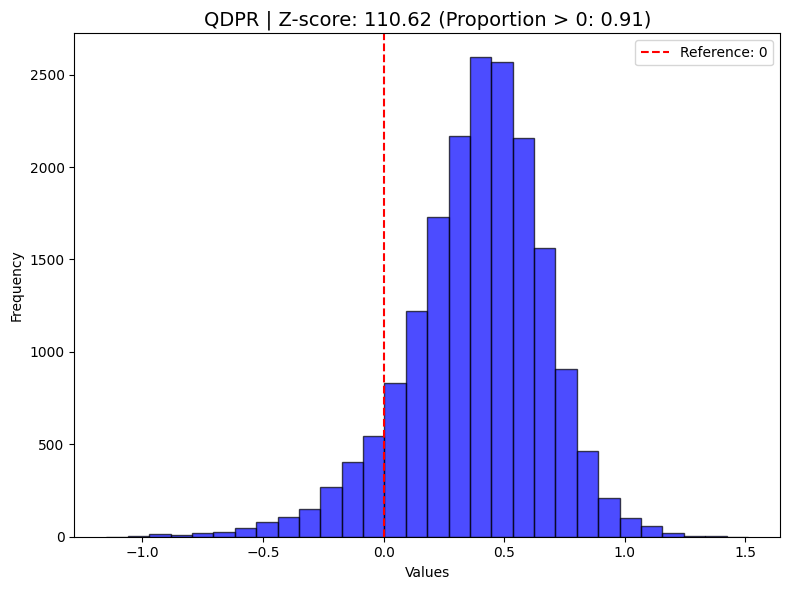

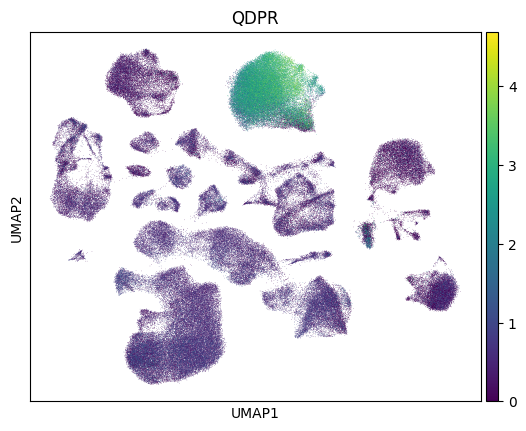

Plotting: CHRM5
adjusted p-value: 0.0


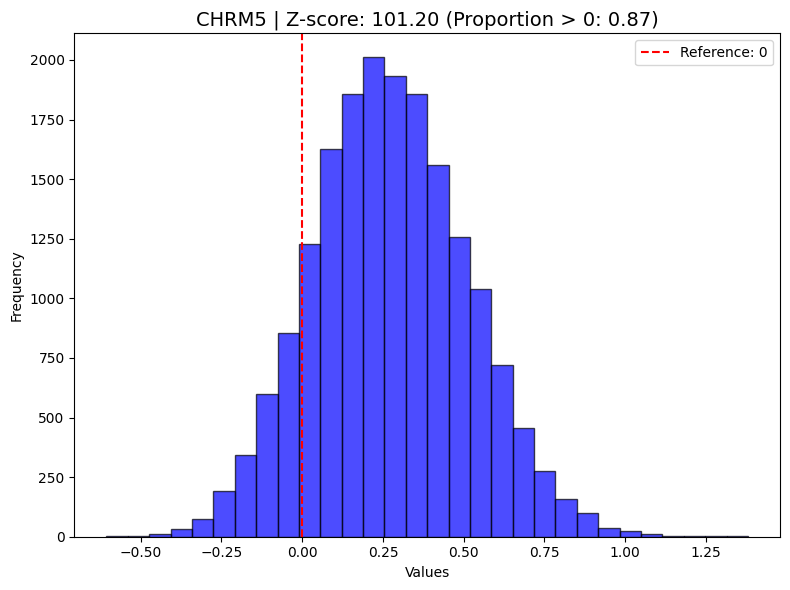

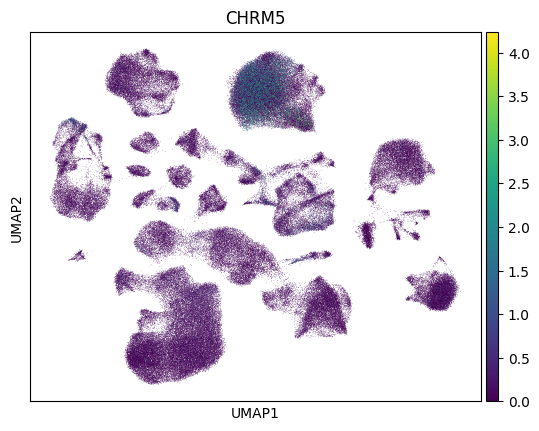

Plotting: ANLN
adjusted p-value: 0.0


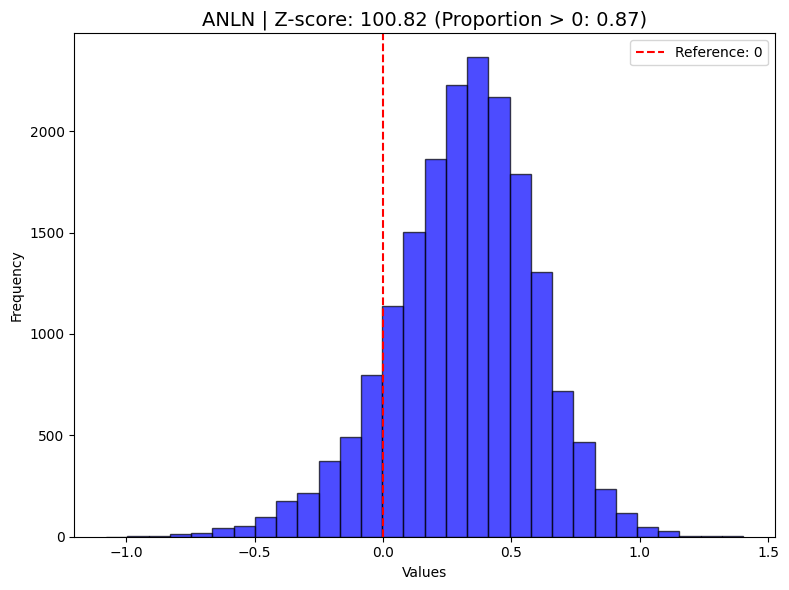

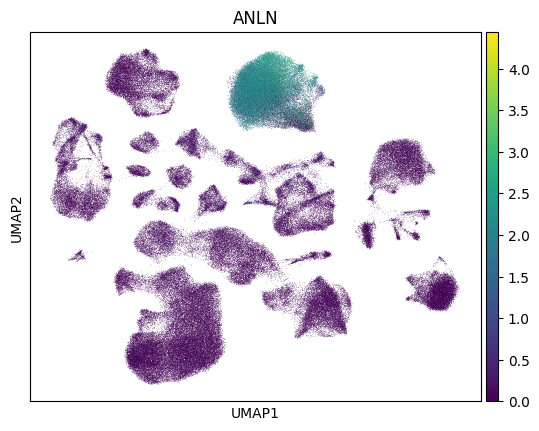

Plotting: ERBIN
adjusted p-value: 0.0


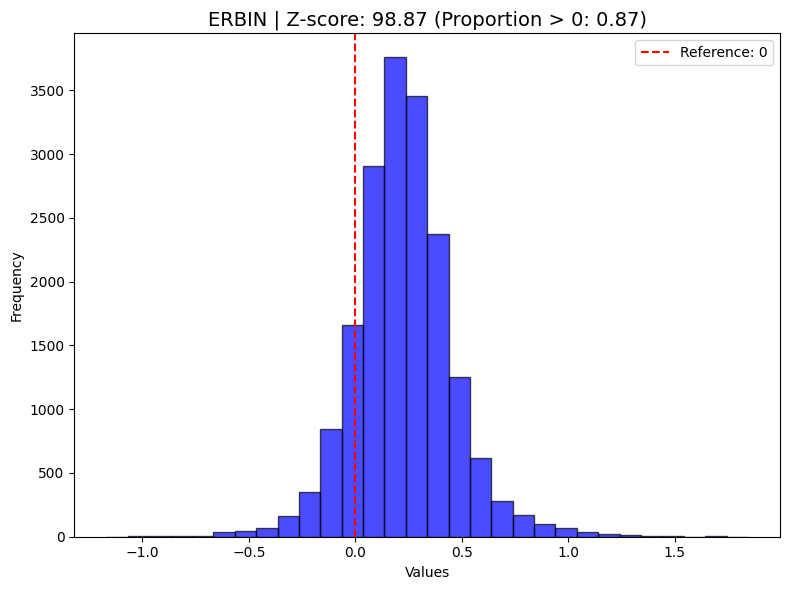

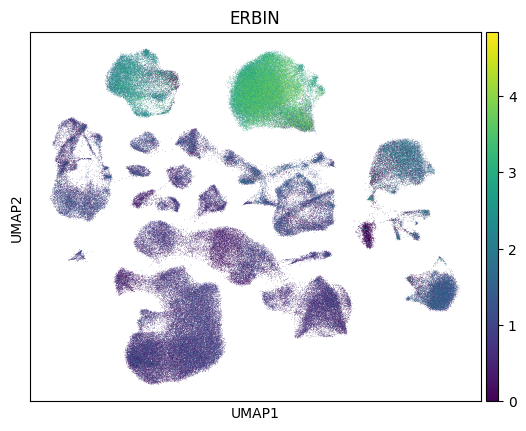

['FKBP5', 'QDPR', 'CHRM5', 'ANLN', 'SPP1', 'SLC39A11', 'MID1IP1', 'PLCG2', 'ERBIN', 'SLC5A11', 'SLC25A48', 'CPQ', 'SLC44A1', 'TPD52L1', 'ADARB2', 'MT-ND3', 'DHCR24', 'RGCC', 'NFKBIA', 'EFHD1', 'ANKRD18A', 'MAN2A1', 'CDKN1C', 'LRRC1', 'PLEKHH2', 'NDRG1', 'MT-ND1', 'AZGP1', 'SMOC1', 'TF', 'ADAMTSL3', 'HSPA2', 'HSP90AA1', 'AMER2', 'ADAM12', 'KIF19', 'CLMN', 'APOD', 'IRAK2', 'KCNMB4', 'ABCA6', 'CA2', 'NKX6-2', 'RASSF2', 'NDRG2', 'ERMN', 'PIEZO2', 'CSRP1', 'LAMP2', 'SLCO1A2', 'ADAMTS18', 'NDE1', 'UST', 'RFTN2', 'MRAS', 'PDK4', 'ADIPOR2', 'SOX10', 'PRUNE2', 'SORL1', 'PLD5', 'SLC35F3', 'GPRC5B', 'MT-CO2', 'TTYH2', 'LRP4', 'ATP1B3', 'COL27A1', 'RELN', 'CDK18', 'TMC6', 'KLK6', 'HLA-A', 'OGFRL1', 'CXCR4', 'L3MBTL4', 'PDE1C', 'SLC2A1', 'TMC8', 'DHFR', 'TECR', 'VSIR', 'S100A6', 'DDIT4', 'HLA-C', 'ZCCHC24', 'PLPP2', 'LHFPL2', 'ITPR2', 'TNS1', 'COL9A2', 'ENPP6', 'GAPDH', 'ST18', 'THBS2', 'DUSP1', 'MT3', 'ACSL1', 'TSC22D4', 'LRP2', 'LDLR', 'FGF1', 'ST6GALNAC3', 'CHST3', 'DPYSL5', 'ARL15', 'ANKUB1', '

<Figure size 1000x600 with 0 Axes>

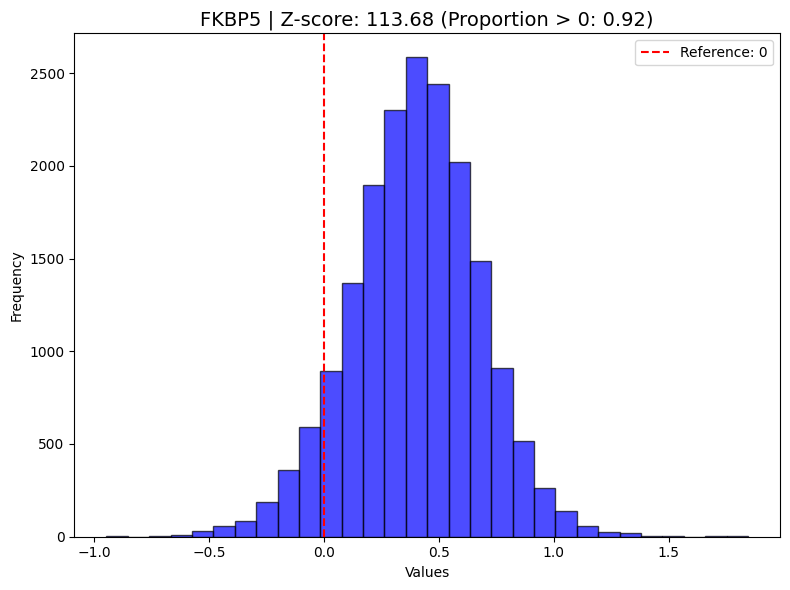

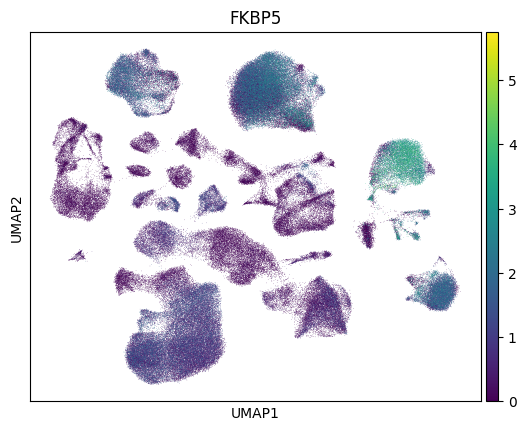

Plotting: QDPR
adjusted p-value: 0.0


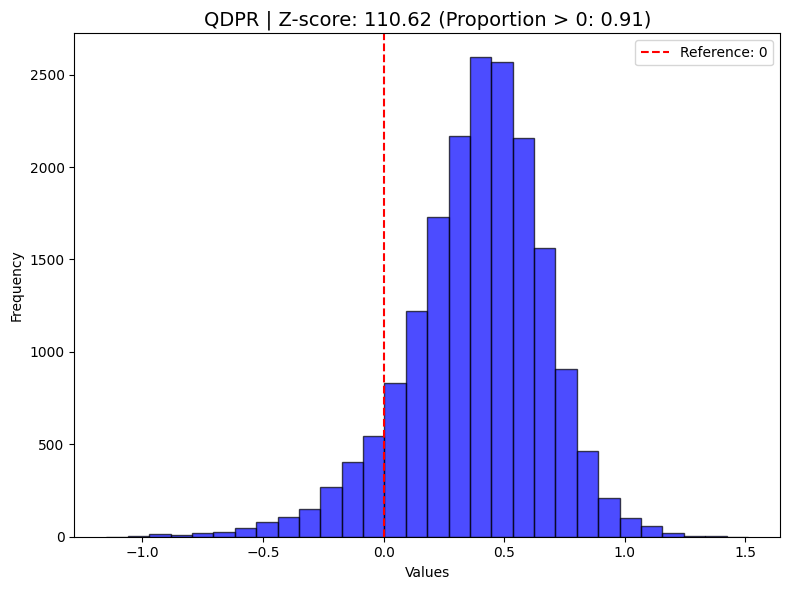

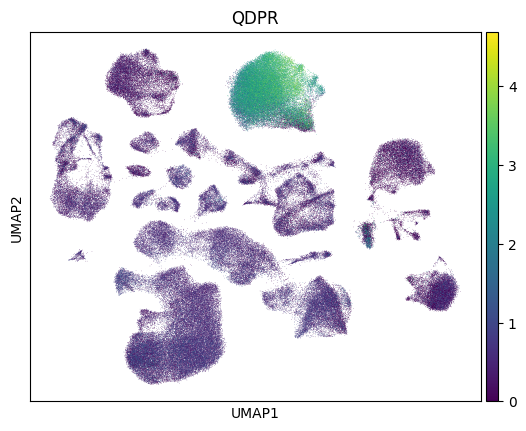

Plotting: CHRM5
adjusted p-value: 0.0


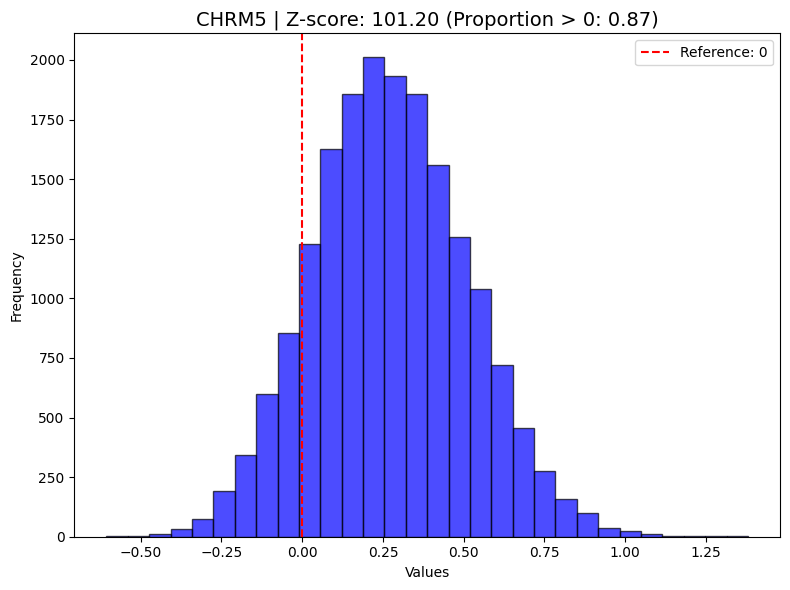

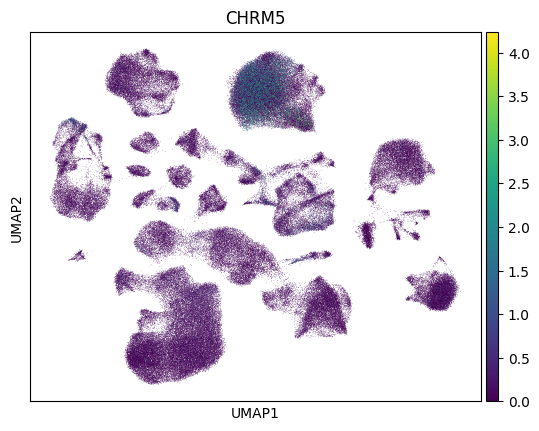

Plotting: ANLN
adjusted p-value: 0.0


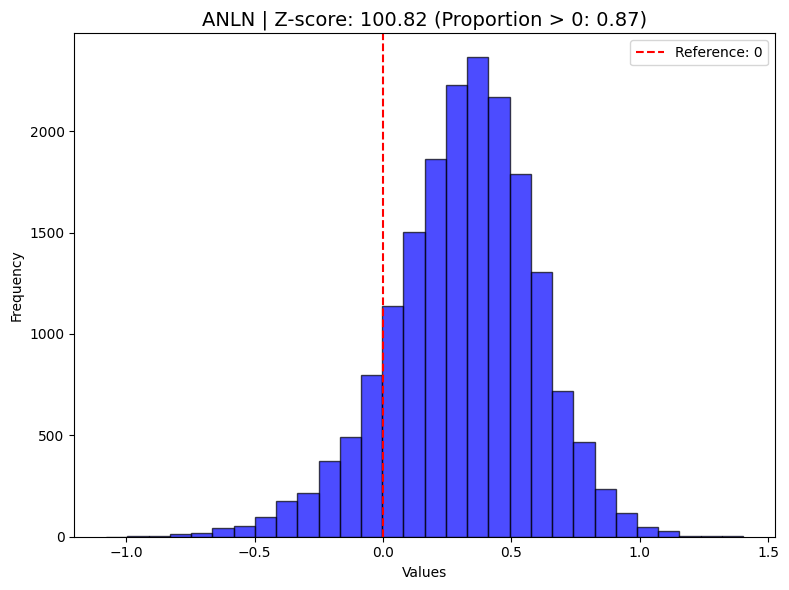

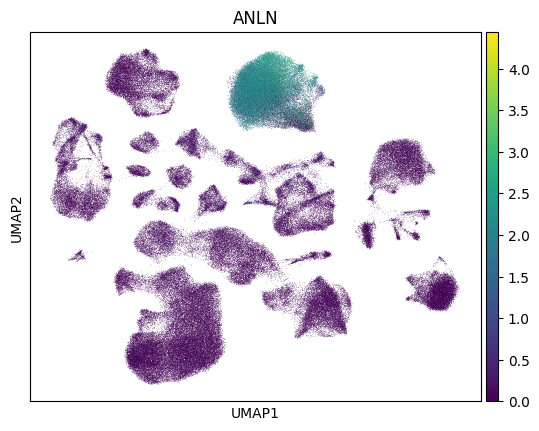

Plotting: SPP1
adjusted p-value: 0.0


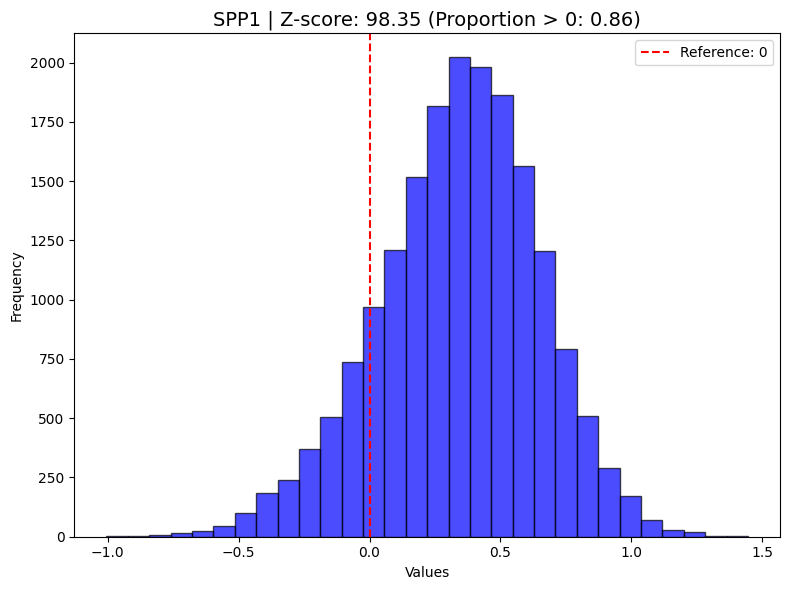

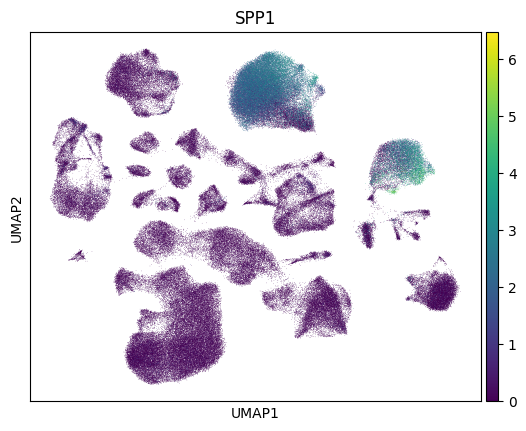

['FKBP5',
 'QDPR',
 'CHRM5',
 'ANLN',
 'SPP1',
 'SLC39A11',
 'MID1IP1',
 'PLCG2',
 'ERBIN',
 'SLC5A11',
 'SLC25A48',
 'CPQ',
 'SLC44A1',
 'TPD52L1',
 'ADARB2',
 'MT-ND3',
 'DHCR24',
 'RGCC',
 'NFKBIA',
 'EFHD1',
 'ANKRD18A',
 'MAN2A1',
 'CDKN1C',
 'LRRC1',
 'PLEKHH2',
 'NDRG1',
 'MT-ND1',
 'AZGP1',
 'SMOC1',
 'TF',
 'ADAMTSL3',
 'HSPA2',
 'HSP90AA1',
 'AMER2',
 'ADAM12',
 'KIF19',
 'CLMN',
 'APOD',
 'IRAK2',
 'KCNMB4',
 'ABCA6',
 'CA2',
 'NKX6-2',
 'RASSF2',
 'NDRG2',
 'ERMN',
 'PIEZO2',
 'CSRP1',
 'LAMP2',
 'SLCO1A2',
 'ADAMTS18',
 'NDE1',
 'UST',
 'RFTN2',
 'MRAS',
 'PDK4',
 'ADIPOR2',
 'SOX10',
 'PRUNE2',
 'SORL1',
 'PLD5',
 'SLC35F3',
 'GPRC5B',
 'MT-CO2',
 'TTYH2',
 'LRP4',
 'ATP1B3',
 'COL27A1',
 'RELN',
 'CDK18',
 'TMC6',
 'KLK6',
 'HLA-A',
 'OGFRL1',
 'CXCR4',
 'L3MBTL4',
 'PDE1C',
 'SLC2A1',
 'TMC8',
 'DHFR',
 'TECR',
 'VSIR',
 'S100A6',
 'DDIT4',
 'HLA-C',
 'ZCCHC24',
 'PLPP2',
 'LHFPL2',
 'ITPR2',
 'TNS1',
 'COL9A2',
 'ENPP6',
 'GAPDH',
 'ST18',
 'THBS2',
 'DUSP1',
 'MT3',
 

In [10]:
indices=ITE.obs["minor.celltype"]=='Oli'
Plot_and_Estimate_CATE_adata(ITE,indices,up_regulate=True)
print("="*20)
Plot_and_Estimate_CATE_adata(ITE,indices,parametric=True,up_regulate=True)

Plot_and_Estimate_CATE_adata(ITE,indices,up_regulate=False)
print("="*20)
Plot_and_Estimate_CATE_adata(ITE,indices,parametric=True,up_regulate=False)

In [ ]:
cell_types = ['Ast', 'CAM', 'CPEC', 'End', 'Epd', 'Exc', 'Fib', 'Inh', 'Mic', 'Oli', 'Opc', 'Per', 'SMC', 'T']

significants_unparametric_up={}
significants_parametric_up={}
significants_unparametric_down={}
significants_parametric_down={}

for cell_typei in cell_types:
    print(cell_typei,"\n\n\n")
    indices=ITE.obs["minor.celltype"]==cell_typei
    if np.sum(indices)==0:
        continue
    top100_1=Plot_and_Estimate_CATE_adata(ITE,indices)
    significants_unparametric_up[cell_typei]=top100_1
    print(cell_typei,"="*20)
    top100_2=Plot_and_Estimate_CATE_adata(ITE,indices,parametric=True)
    significants_parametric_up[cell_typei]=top100_2
    print(cell_typei,"="*20)
    top100_3=Plot_and_Estimate_CATE_adata(ITE,indices,up_regulate=False)
    significants_unparametric_down[cell_typei]=top100_3
    print(cell_typei,"="*20)
    top100_4=Plot_and_Estimate_CATE_adata(ITE,indices,parametric=True,up_regulate=False)
    significants_parametric_down[cell_typei]=top100_4
    print(cell_typei,"---"*20)
    print(cell_typei,"---"*20)
    print(cell_typei,"---"*20)
    print(cell_typei,"---"*20)
    print("---"*20)
    print("---"*20)
    print("---"*20)
    print("---"*20)
    print("---"*20)
    print("---"*20)
    df1=pd.DataFrame(significants_unparametric_up)
    df2=pd.DataFrame(significants_parametric_up)
    df1.to_csv("./ROSMAP_stat/down_significant_unparametric.csv")
    df2.to_csv("./ROSMAP_stat/down_significant_parametric.csv")

    df3=pd.DataFrame(significants_unparametric_down)
    df4=pd.DataFrame(significants_parametric_down)
    df3.to_csv("./ROSMAP_stat/up_significant_unparametric.csv")
    df4.to_csv("./ROSMAP_stat/up_significant_parametric.csv")

In [15]:
import scanpy as sc
import numpy as np
import anndata as ad

import random
import torch
import sklearn
import os
import pandas as pd

In [16]:
ad1=sc.read_h5ad("/gpfs/gibbs/project/wang_zuoheng/xx244/Ndreamer/case_control/AD/adata.h5ad")

In [33]:
import rpy2.robjects as ro
from rpy2.robjects.packages import importr
from rpy2.robjects.vectors import StrVector

# Ensure required R packages are installed
utils = importr("utils")
utils.chooseCRANmirror(ind=1)  # Select a CRAN mirror
importr("org.Hs.eg.db")
importr("AnnotationDbi")

# Define the R function in Python
ro.r('''
library(org.Hs.eg.db)
library(AnnotationDbi)

convert_ensg_to_gene_name_local <- function(ensg_vector) {
  gene_names <- mapIds(
    org.Hs.eg.db,
    keys = ensg_vector,
    column = "SYMBOL",
    keytype = "ENSEMBL",
    multiVals = "first"
  )
  result <- data.frame(ENSG_ID = ensg_vector, Gene_Name = gene_names, stringsAsFactors = FALSE)
  return(result)
}
''')

# Python function to call the R function
def convert_ensg_to_gene_name(ensg_list):
    r_convert_func = ro.globalenv['convert_ensg_to_gene_name_local']
    r_result = r_convert_func(StrVector(ensg_list))
    
    # Extract the "Gene_Name" column by index or use .rx2() with column name
    gene_names = list(r_result.rx2("Gene_Name"))
    return gene_names

# Example usage
ensg_ids = ["ENSG00000139618", "ENSG00000227232", "ENSG00000157764"]
gene_names = convert_ensg_to_gene_name(ensg_ids)
print(gene_names)

R[write to console]: Error in (function ()  : 
  org.Hs.egPFAM is defunct. Please use select() if you need access to
  PFAM or PROSITE accessions.

R[write to console]: Error in (function ()  : 
  org.Hs.egPROSITE is defunct. Please use select() if you need access to
  PFAM or PROSITE accessions.

R[write to console]: 'select()' returned 1:1 mapping between keys and columns



['BRCA2', NA_character_, 'BRAF']


In [34]:
gene_names1=np.array(convert_ensg_to_gene_name(ad1.var_names.tolist()))
print(gene_names1)
ad1.var_names=gene_names1

R[write to console]: 'select()' returned 1:many mapping between keys and columns



['FGR' 'CFH' 'CFTR' ... NA_character_ 'LOC124903386' NA_character_]


In [19]:
ITE1=sc.read_h5ad("/gpfs/gibbs/project/wang_zuoheng/xx244/Ndreamer/case_control/AD/ITE.h5ad")

In [30]:
print("FTH1" in ITE1.var_names)

True


In [31]:
print(ad1.var_names)

Index(['ENSG00000000938', 'ENSG00000000971', 'ENSG00000001626',
       'ENSG00000002586', 'ENSG00000003400', 'ENSG00000003436',
       'ENSG00000003989', 'ENSG00000004468', 'ENSG00000004799',
       'ENSG00000004864',
       ...
       'ENSG00000287950', 'ENSG00000287958', 'ENSG00000287989',
       'ENSG00000288002', 'ENSG00000288016', 'ENSG00000288057',
       'ENSG00000288087', 'ENSG00000288088', 'ENSG00000288302',
       'ENSG00000288321'],
      dtype='object', length=2000)


# Common

-140.91689000835586


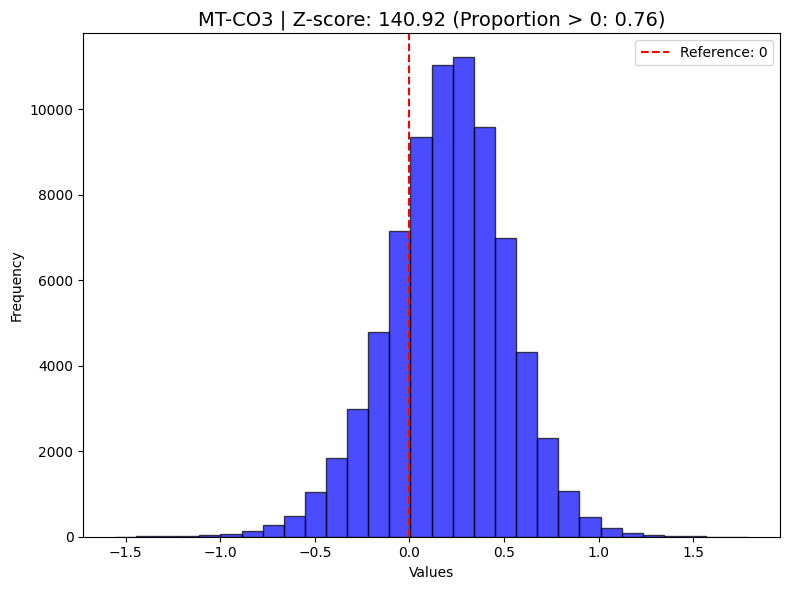

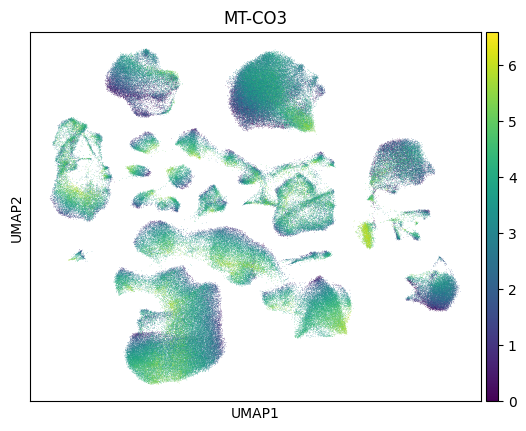

-161.6018713328992


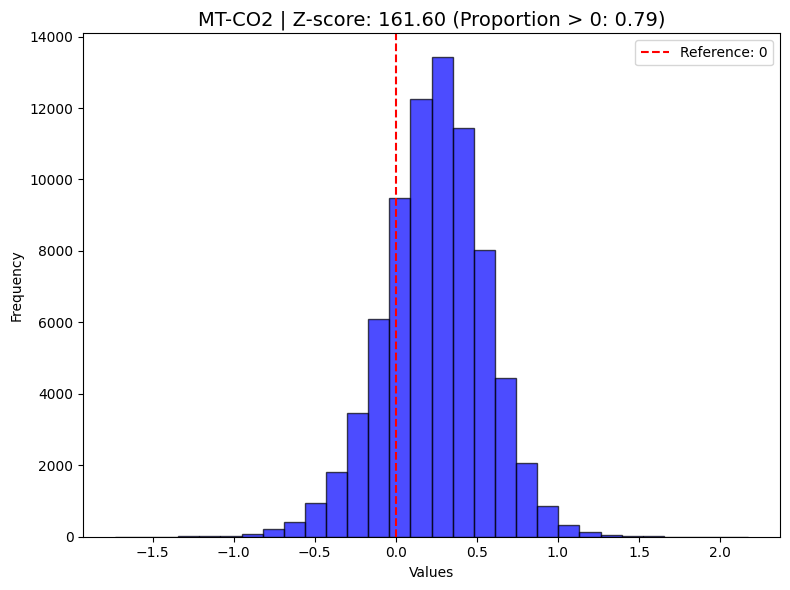

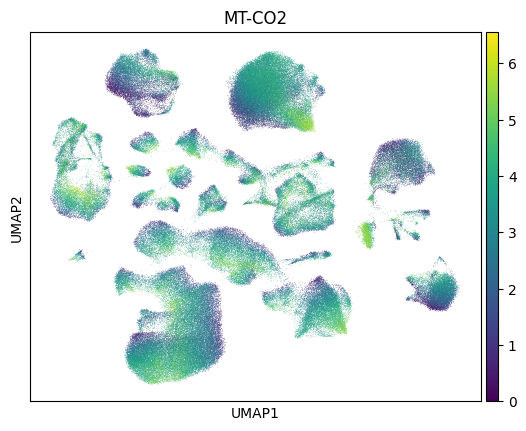

-180.9481130993293


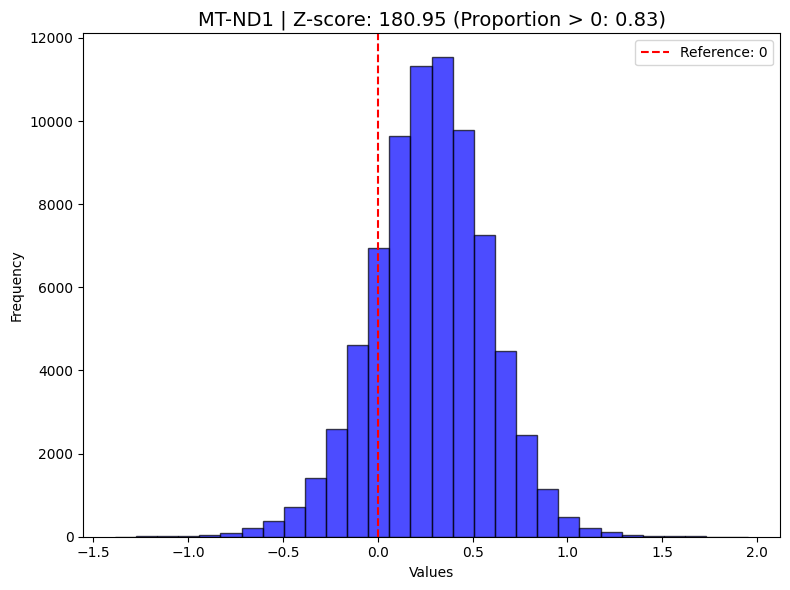

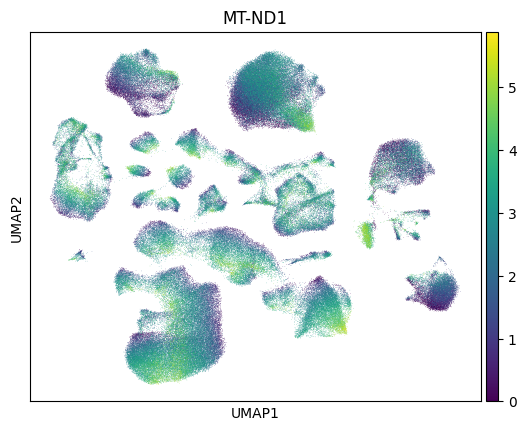

-193.36055704574892


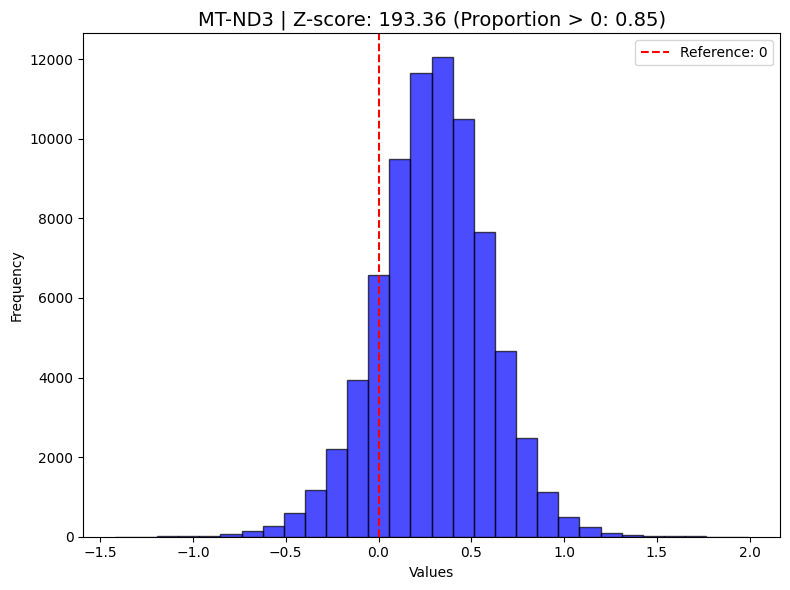

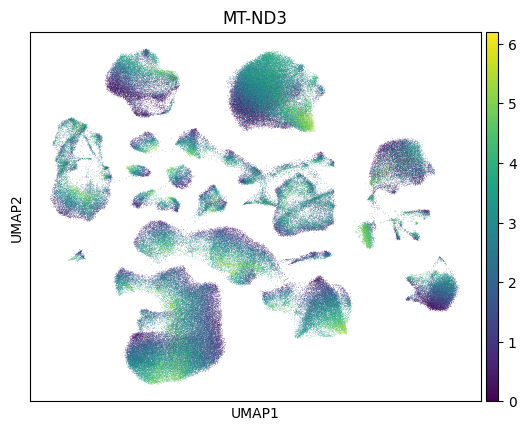

In [37]:
indices1=np.array([True for i in range(ITE.shape[0])])
for genei in ["MT-CO3", "MT-CO2", "MT-ND1", "MT-ND3"]:
    Plot_and_Estimate_CATE_adata(ITE,indices1,genes=genei)
    sc.pl.umap(adata_raw,color=genei)

-732.1094974181748


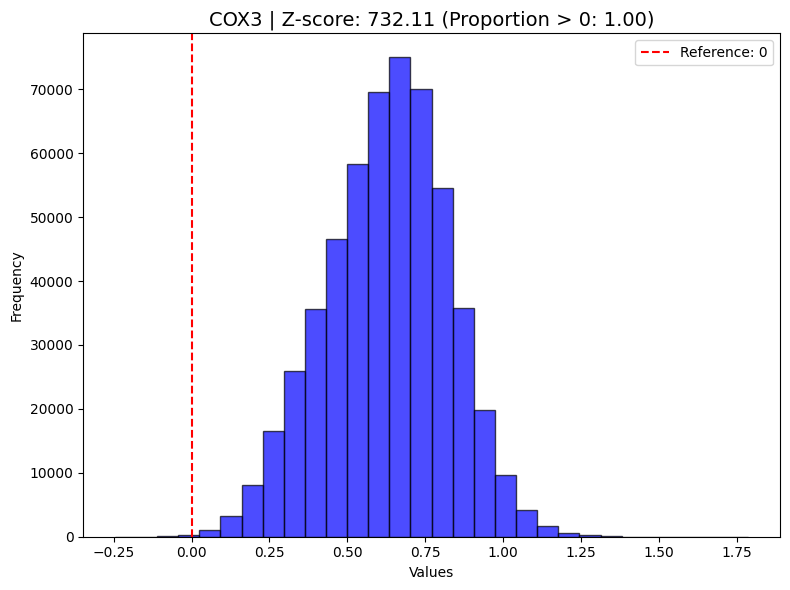

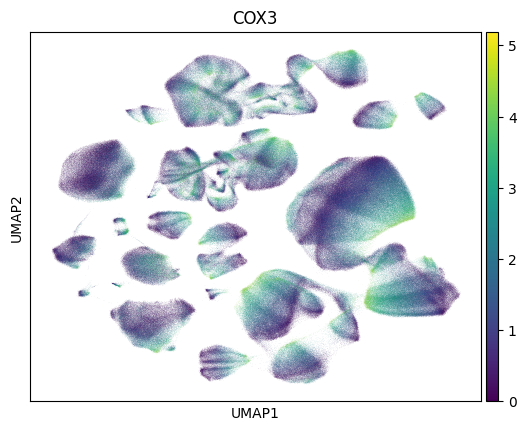

-732.030335099943


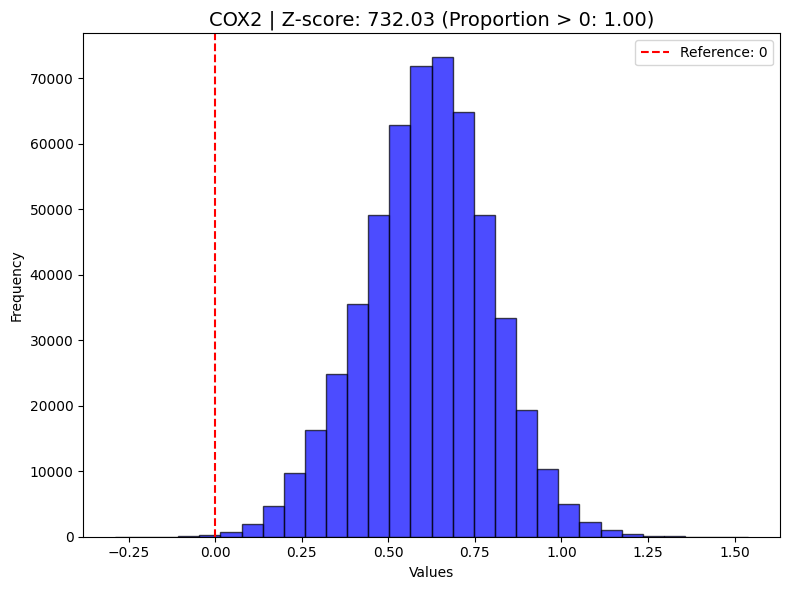

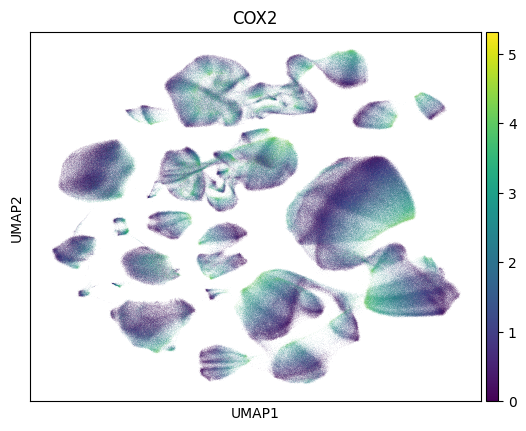

-731.8474428474765


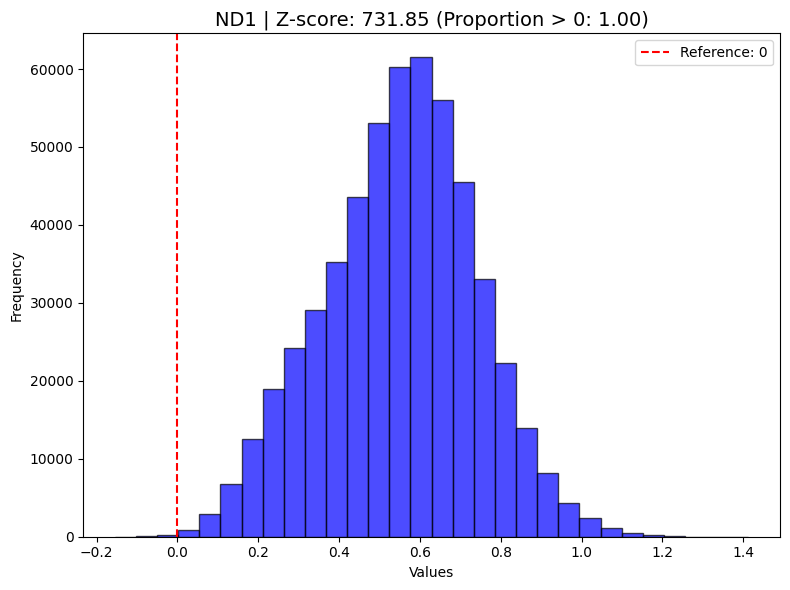

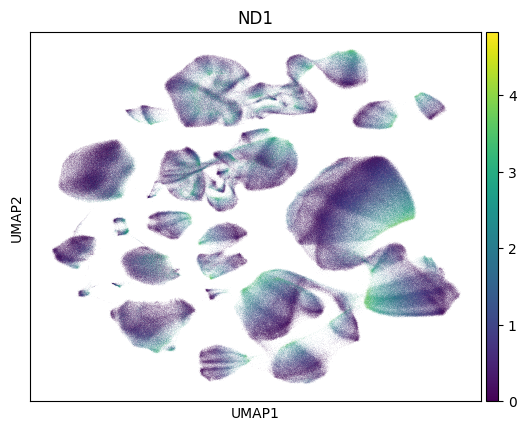

-732.6636336457973


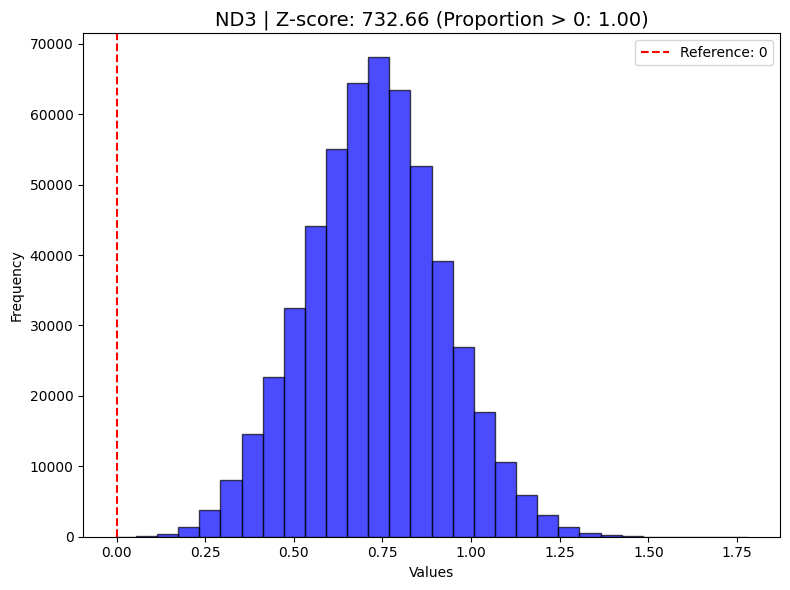

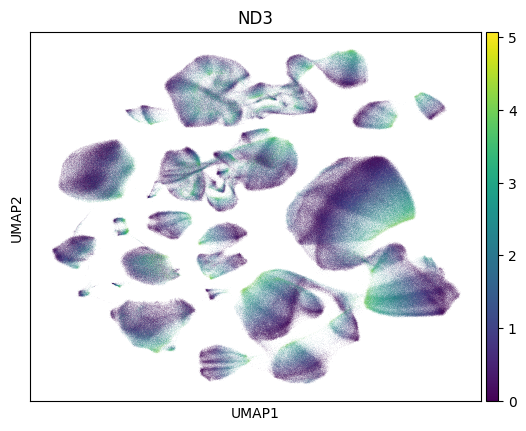

In [38]:
indices1=np.array([True for i in range(ITE1.shape[0])])
for genei in ["COX3", "COX2", "ND1", "ND3"]:
    Plot_and_Estimate_CATE_adata(ITE1,indices1,genes=genei)
    sc.pl.umap(ad1,color=genei)

# Astrocyte

-66.69650378277397


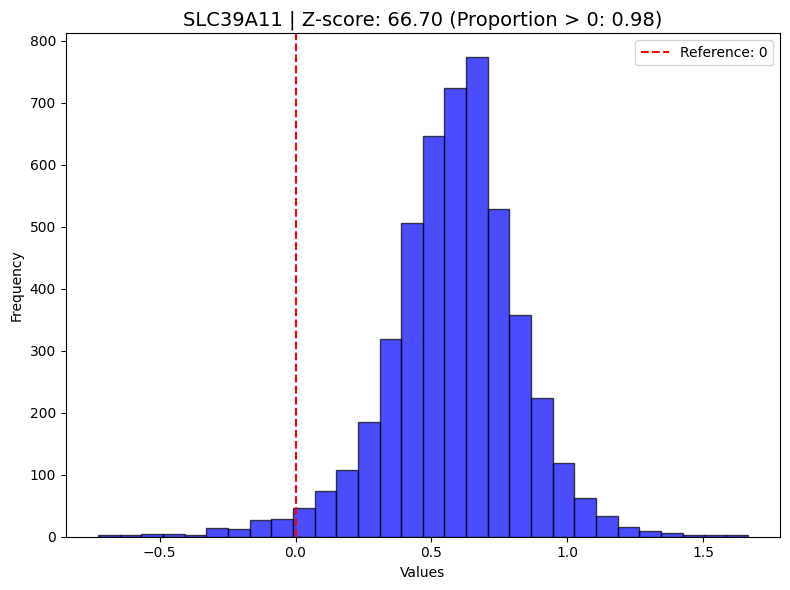

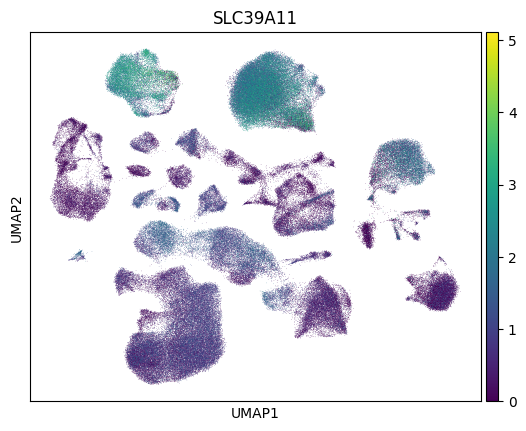

54.12445707662852


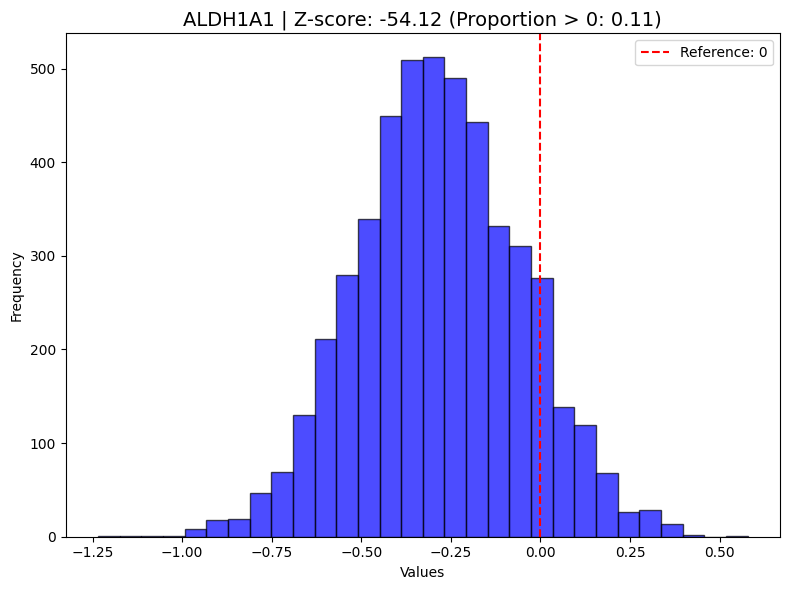

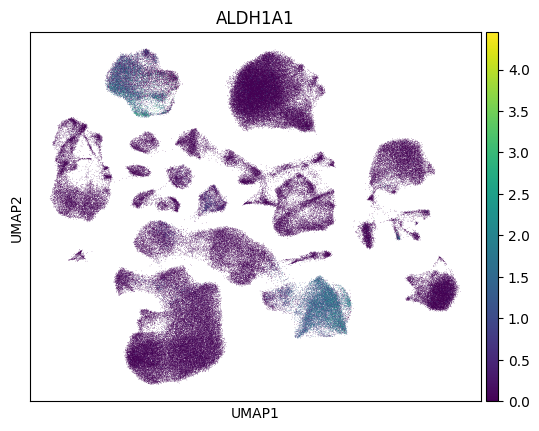

-62.630344676672074


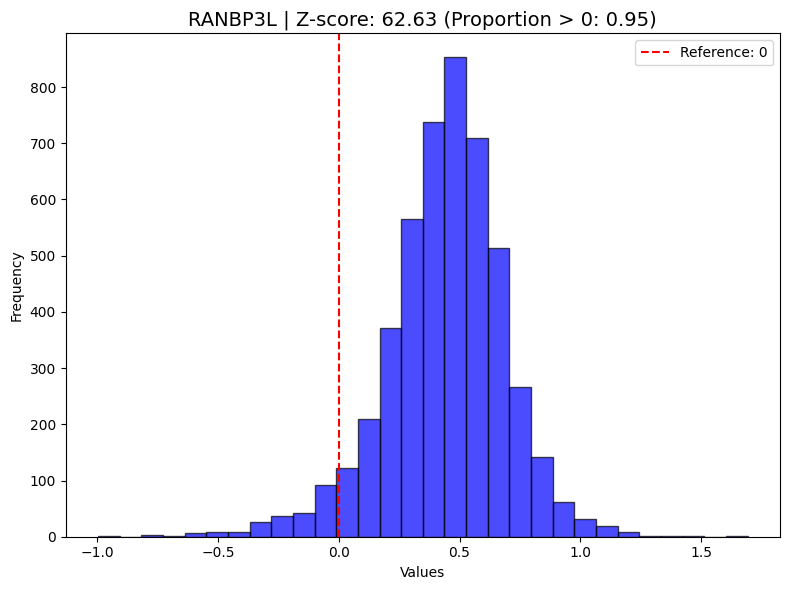

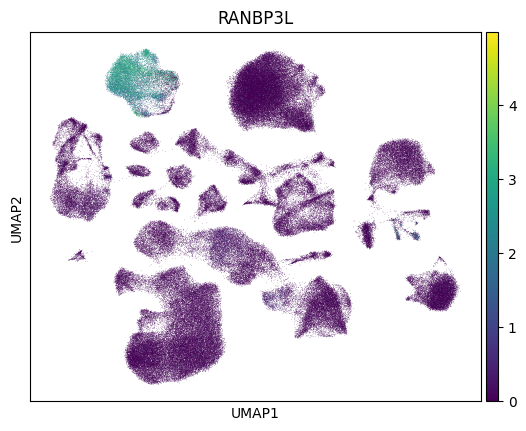

59.943518694901556


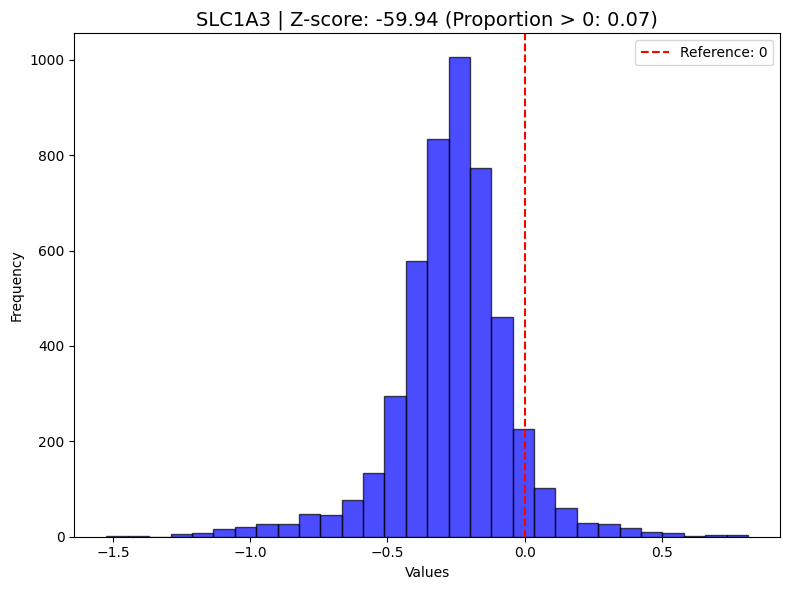

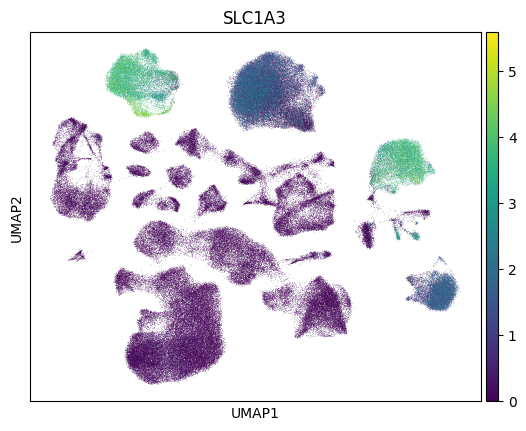

In [42]:
indices1=ITE.obs["minor.celltype"]=="Ast"
for genei in ["SLC39A11", "ALDH1A1", "RANBP3L", "SLC1A3"]:
    Plot_and_Estimate_CATE_adata(ITE,indices1,genes=genei)
    sc.pl.umap(adata_raw,color=genei)

-185.55103079725214


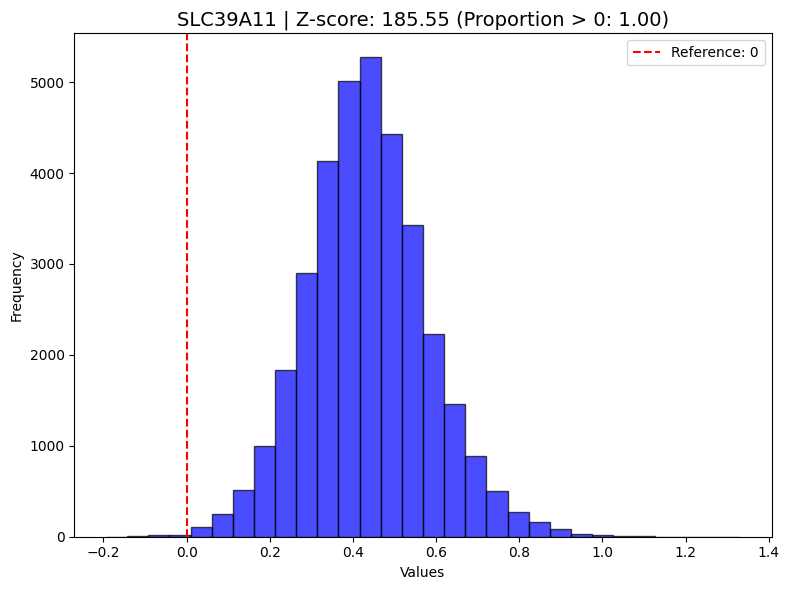

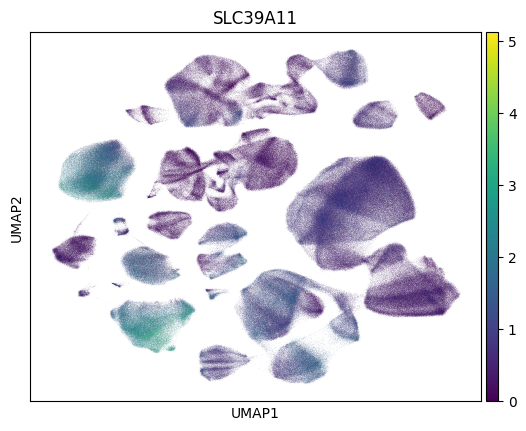

162.75302533258062


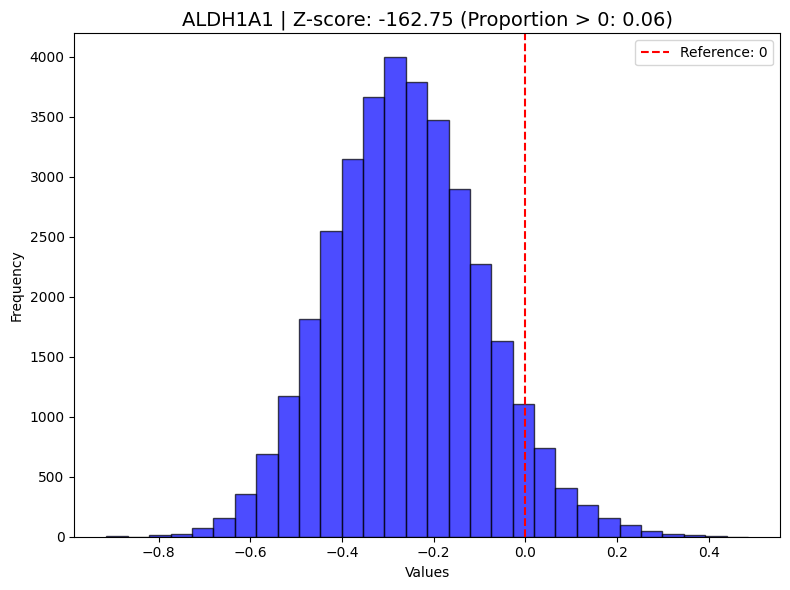

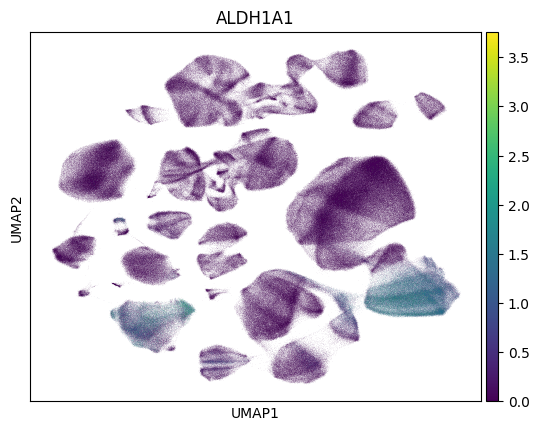

-181.10972124210622


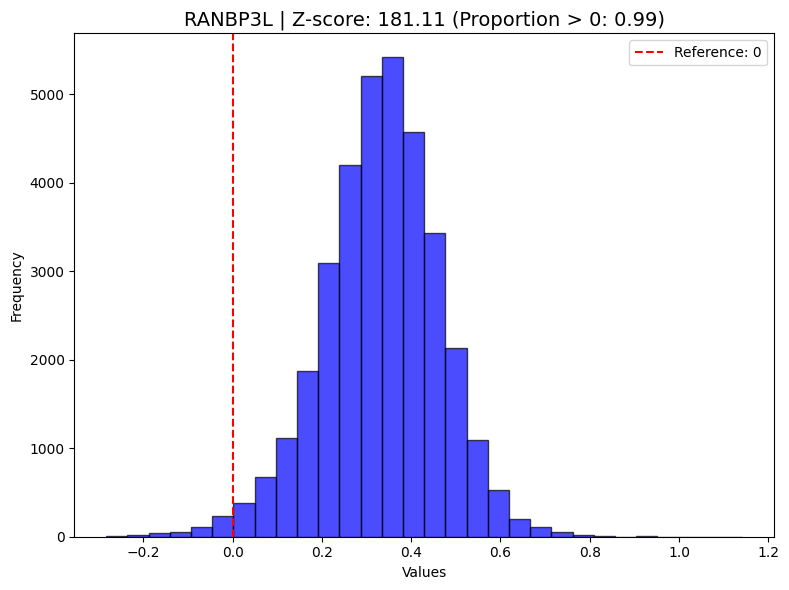

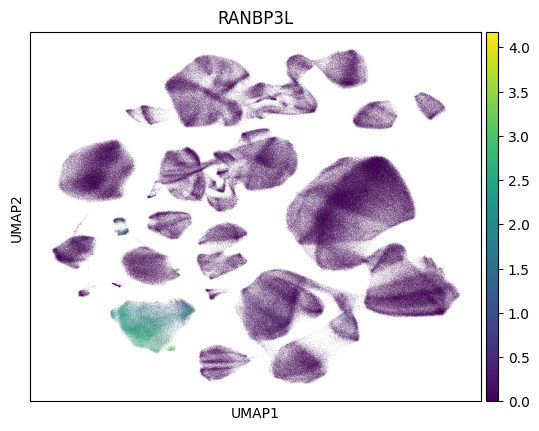

140.53572378068847


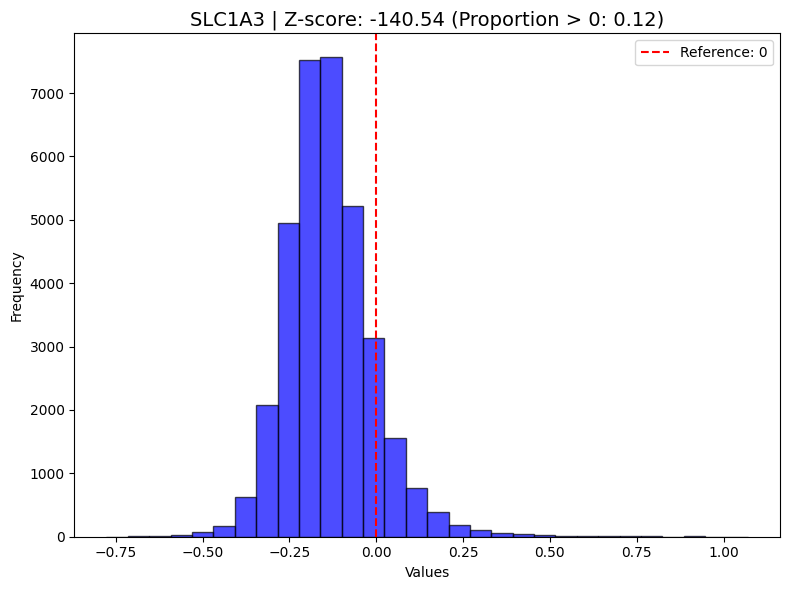

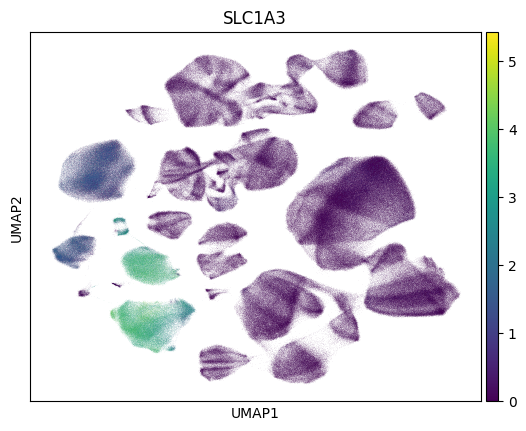

In [41]:
indices1=ITE1.obs["Subclass"]=='Astrocyte'
for genei in ["SLC39A11", "ALDH1A1", "RANBP3L", "SLC1A3"]:
    Plot_and_Estimate_CATE_adata(ITE1,indices1,genes=genei)
    sc.pl.umap(ad1,color=genei)

-113.68196065049152


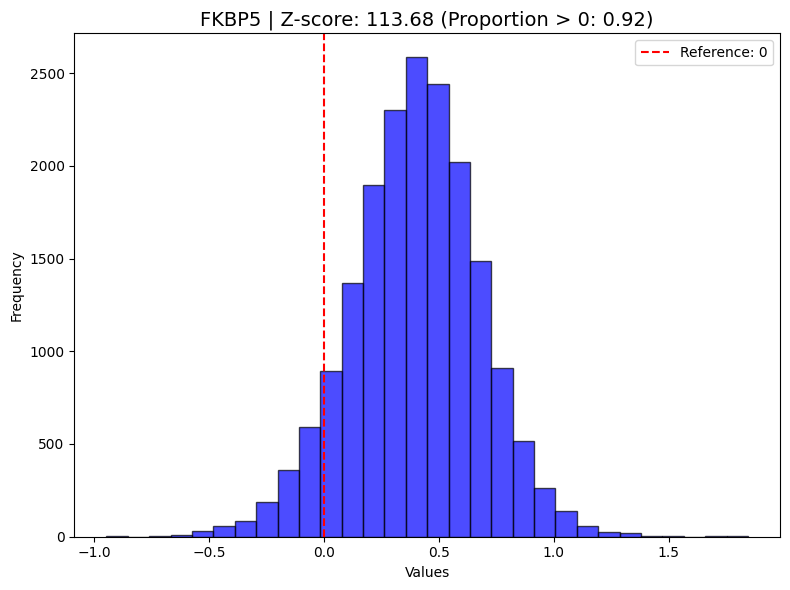

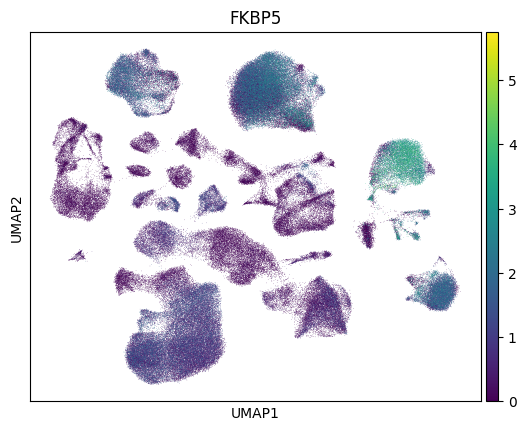

-110.61907299532403


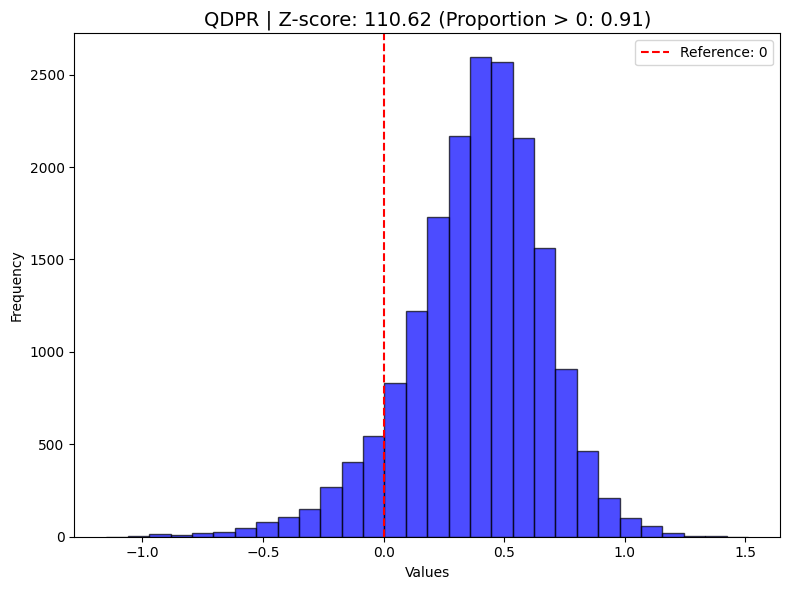

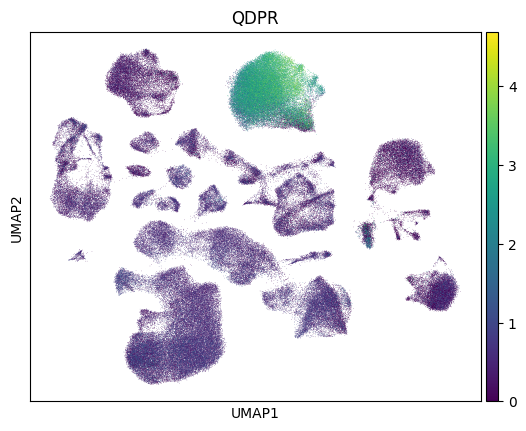

100.89033563651911


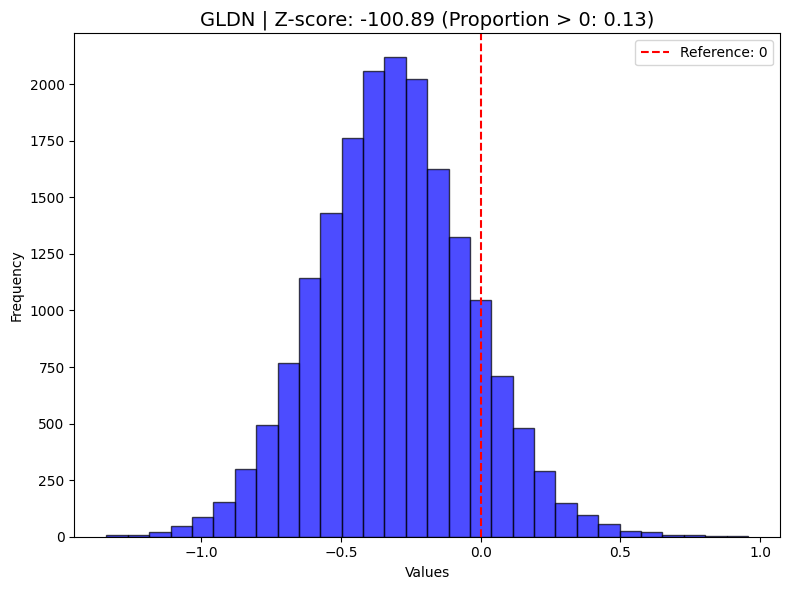

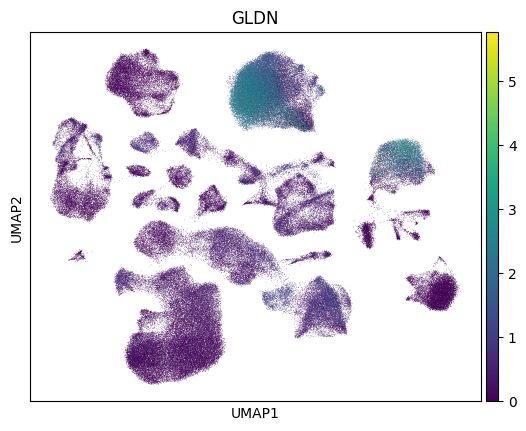

-93.8693685235869


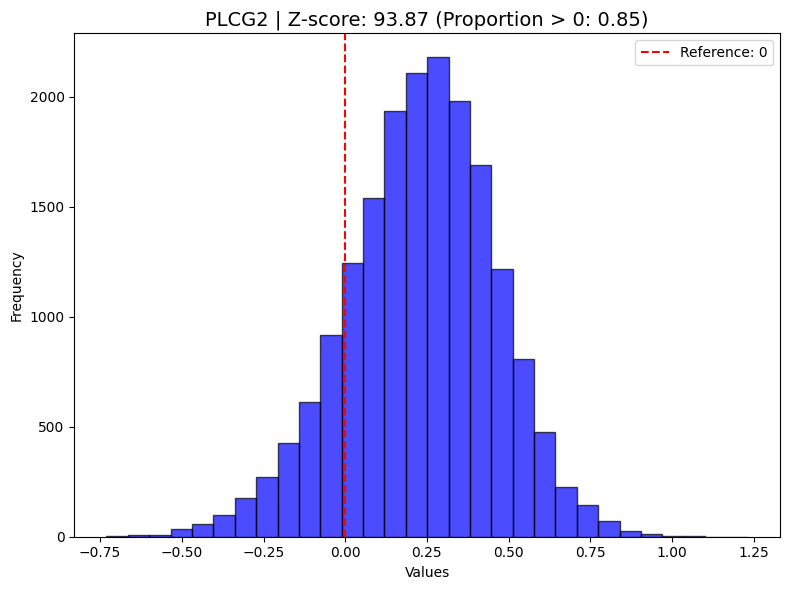

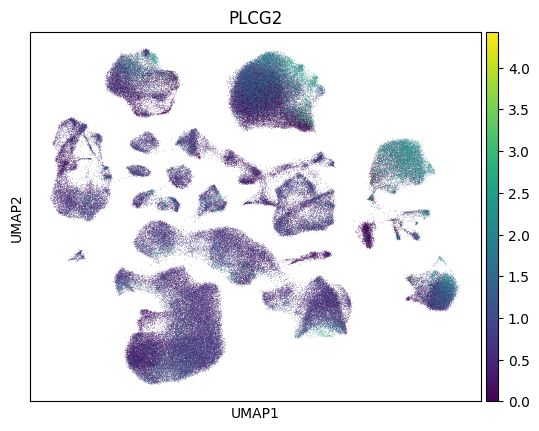

In [45]:
indices1=ITE.obs["minor.celltype"]=="Oli"
for genei in ["FKBP5","QDPR", "GLDN", "PLCG2"]:
    Plot_and_Estimate_CATE_adata(ITE,indices1,genes=genei)
    sc.pl.umap(adata_raw,color=genei)

-206.36727111438407


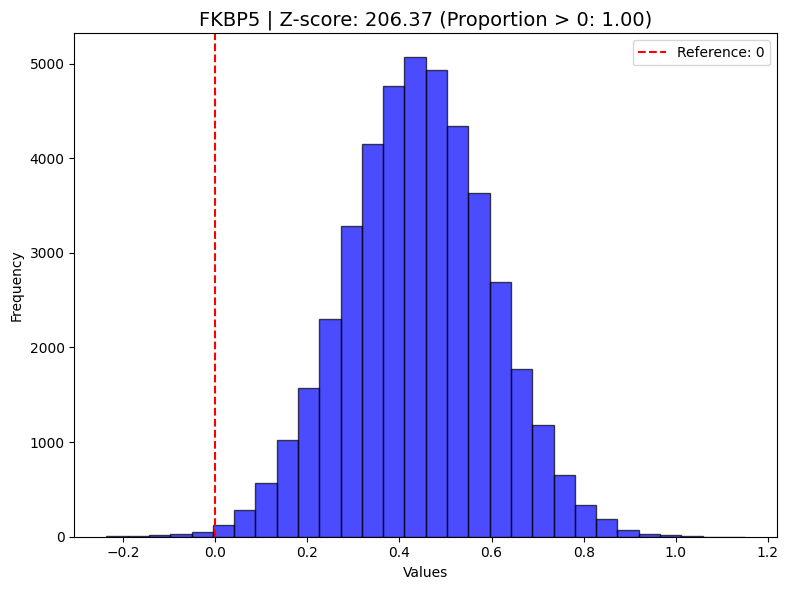

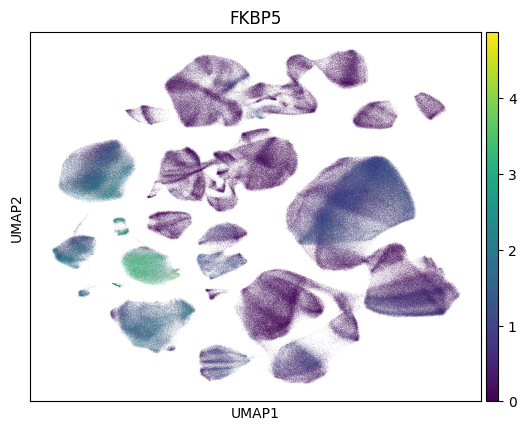

-201.93506714050153


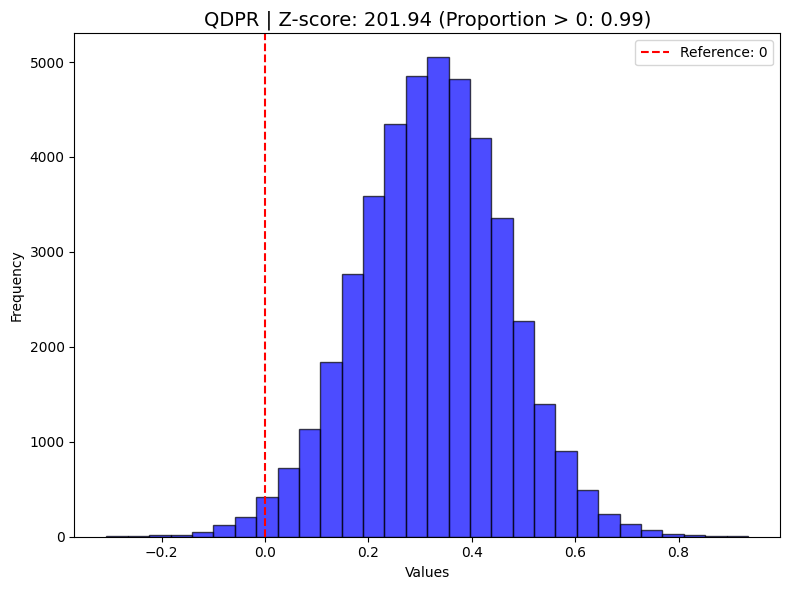

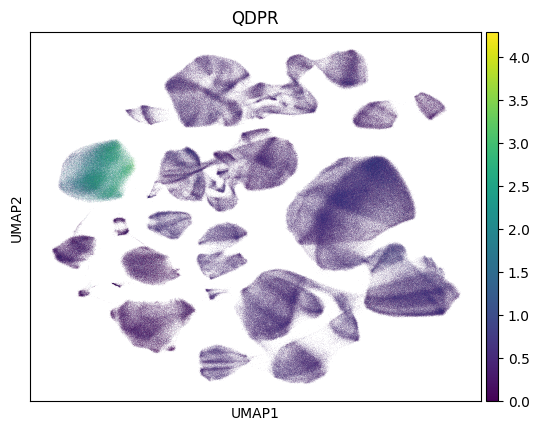

197.97498924209776


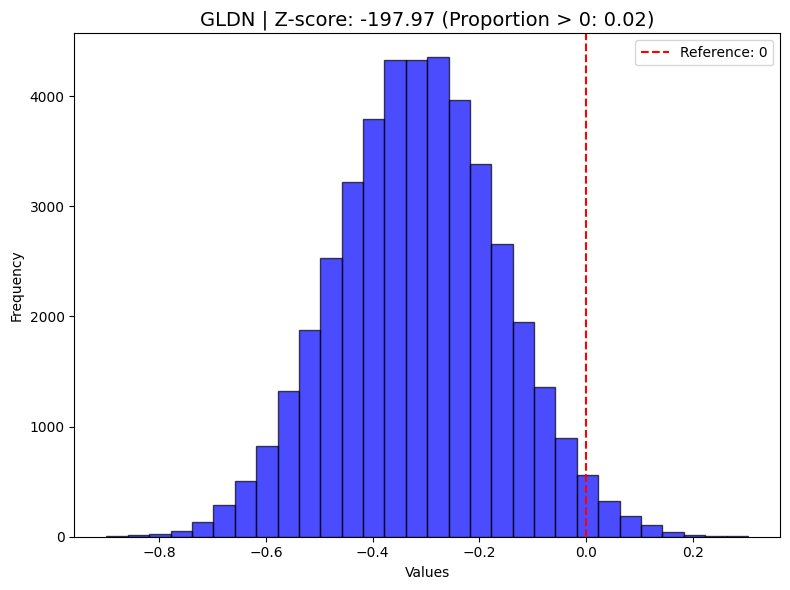

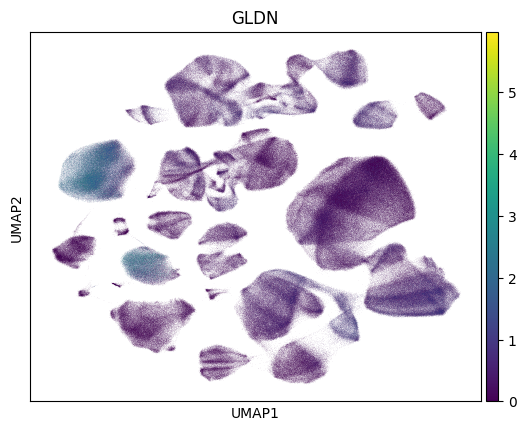

-207.3500641694624


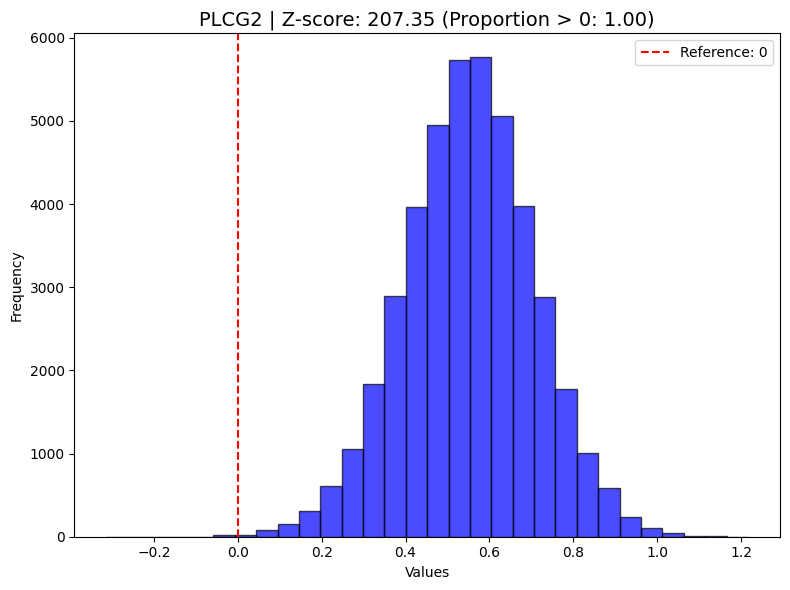

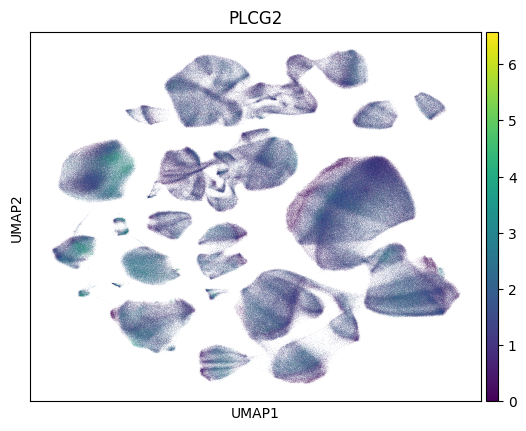

In [46]:
indices1=ITE1.obs["Subclass"]=='Oligodendrocyte'
for genei in ["FKBP5","QDPR", "GLDN", "PLCG2"]:
    Plot_and_Estimate_CATE_adata(ITE1,indices1,genes=genei)
    sc.pl.umap(ad1,color=genei)